#Basics

In [1]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
ravidussilva_real_ai_art_path = kagglehub.dataset_download('ravidussilva/real-ai-art')

print('Data source import complete.')

Data source import complete.


**Initialization**

The notebook has been tested using GPU T4 x2

In [2]:
!pip install keras-tuner
import os
import random
from matplotlib import pyplot as plt
import cv2

import numpy as np
import pandas as pd
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.utils import image_dataset_from_directory
from keras.models import Sequential
from keras.layers import Rescaling, Conv2D, MaxPooling2D, Flatten, Dense, BatchNormalization, Activation, Dropout
from keras.metrics import Precision, Recall
import keras_tuner as kt
from keras.optimizers import Adam
from keras.callbacks import EarlyStopping

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 11.4 MB/s eta 0:00:00


**Listing input train and test data**

In [3]:
top_dir = '/kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset'

# Define the training paths
train_dir = os.path.join(top_dir, 'train')

# List all directories in the train directory
all_directories  =  os.listdir(train_dir)

# Initialize lists to store directories for human-drawn and AI-generated images
train_human = []
train_ai = []

# Loop through all directories
for directory in all_directories:
    # Check if the directory represents human-drawn images
    if not directory.startswith('AI_'):
        train_human.append(os.path.join(train_dir, directory))
    # Check if the directory represents AI-generated images
    else:
        train_ai.append(os.path.join(train_dir, directory))

# Print the lists of directories
print("Train directories containing human-drawn images:")
for i, directory in enumerate(train_human):
    print(f"{i}. {directory}")

print("\nTrain directories containing AI-generated images:")
for i, directory in enumerate(train_ai):
    print(f"{i}. {directory}")


Train directories containing human-drawn images:
0. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/train/impressionism
1. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/train/renaissance
2. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/train/surrealism
3. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/train/art_nouveau
4. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/train/baroque
5. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/train/expressionism
6. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/train/romanticism
7. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/train/ukiyo_e
8. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/train/post_impressionism
9. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/train/realism

Train directories containing AI-generated images:
0. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/train/AI_SD_impressionism
1. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/train/AI_LD_post_impressionism
2. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/tr

In [4]:
# Define the test paths
test_dir = os.path.join(top_dir, 'test')

# List all directories in the test directory
all_directories = os.listdir(test_dir)

# Initialize lists to store directories for human-drawn and AI-generated images
test_human = []
test_ai = []

# Loop through all directories
for directory in all_directories:
    # Check if the directory represents human-drawn images
    if not directory.startswith('AI_'):
        test_human.append(os.path.join(test_dir, directory))
    # Check if the directory represents AI-generated images
    else:
        test_ai.append(os.path.join(test_dir, directory))

# Print the lists of directories
print("Test directories containing human-drawn images:")
for i, directory in enumerate(test_human):
    print(f"{i}. {directory}")

print("\nTest directories containing AI-generated images:")
for i, directory in enumerate(test_ai):
    print(f"{i}. {directory}")

Test directories containing human-drawn images:
0. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/test/impressionism
1. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/test/renaissance
2. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/test/surrealism
3. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/test/art_nouveau
4. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/test/baroque
5. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/test/expressionism
6. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/test/romanticism
7. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/test/ukiyo_e
8. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/test/post_impressionism
9. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/test/realism

Test directories containing AI-generated images:
0. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/test/AI_SD_impressionism
1. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/test/AI_LD_post_impressionism
2. /kaggle/input/real-ai-art/Real_AI_SD_LD_Dataset/test/AI_LD_art_n

**Dataset analysis**

In [5]:

# Plot k-number of images from the dataset
def plot_im(directory, k):
    files = os.listdir(directory)
    im = random.choices(files, k=k)

    fig = plt.figure()

    for i in range(k):
        im_i_path = os.path.join(directory, im[i])  # File path
        im_i = cv2.imread(im_i_path)

        # Add subplot
        ax = fig.add_subplot(int(np.sqrt(k)), int(np.sqrt(k)), i + 1)

        # Plot image
        ax.imshow(im_i)
        ax.axis('off')

        # Display filename below the image
        ax.set_title(im[i], fontsize=8, pad=2)

    plt.tight_layout()  # Adjust layout
    plt.show()

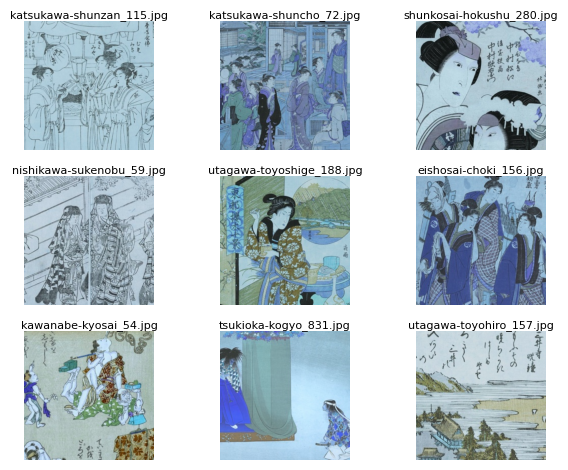

In [6]:

# Visualize random images from train_human. Catagory is sorted in order of output in cell 2
real_im = plot_im(directory=train_human[7], k=9)
plt.show()

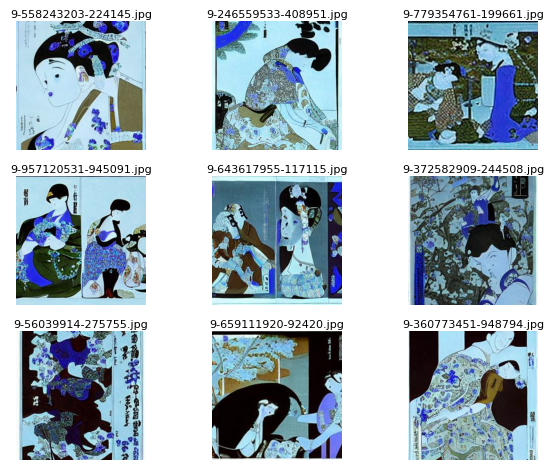

In [7]:
# Visualize random images from train_ai. Catagory is sorted in order of output in cell 2
ai_im = plot_im(directory=train_ai[4], k=9)
plt.show()

**Setting up train and test set under labels "human" and "AI"**

**Labelling the training set**

In [8]:
# Initialize lists to store file paths and labels
filepaths = []
labels = []

# Initialize an empty DataFrame for train_data
train_data = pd.DataFrame(columns=['filepath', 'label'])

# Label files under train_human as "human"
for directory in train_human:
    for file in os.listdir(directory):
        filepath = os.path.join(directory, file)
        filepaths.append(filepath)
        labels.append("human")

# Label files under train_ai as "AI"
for directory in train_ai:
    for file in os.listdir(directory):
        filepath = os.path.join(directory, file)
        filepaths.append(filepath)
        labels.append("AI")

# Create a DataFrame with file paths and labels
data = pd.DataFrame({'filepath': filepaths, 'label': labels})

# Concatenate data with train_data
train_data = pd.concat([train_data, data], ignore_index=True)

In [9]:
# Display the first few rows of the train_data DataFrame
print(train_data.head())

                                            filepath  label
0  /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...  human
1  /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...  human
2  /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...  human
3  /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...  human
4  /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...  human


In [10]:
# Count the number of files under each label
file_counts = train_data['label'].value_counts()

# Print the counts
print("Number of files under each label:")
print(file_counts)

Number of files under each label:
label
AI       105015
human     50000
Name: count, dtype: int64


**Reducing AI data to balance-off**

In [11]:
# Set the random seed for reproducibility
random_seed = 123  # Change this to your desired seed number
np.random.seed(random_seed)

# Number of rows to drop for the 'AI' label


# Get the indices of rows with the 'AI' label
ai_indices = train_data[train_data['label'] == 'AI'].index
human_indices = train_data[train_data['label'] == 'human'].index


# Randomly select indices to drop using the specified seed
indices_to_drop = np.random.choice(ai_indices, 94015, replace=False)

# Drop the selected rows from the DataFrame
train_data = train_data.drop(indices_to_drop)
indices_to_drop2 = np.random.choice(human_indices, 39000, replace=False)

# Drop the selected rows from the DataFrame
train_data = train_data.drop(indices_to_drop2)


# Reset the index of the DataFrame after dropping rows
train_data.reset_index(drop=True, inplace=True)

# Count the number of files under each label
file_counts = train_data['label'].value_counts()

# Print the counts
print("Number of files under each label:")
print(file_counts)

Number of files under each label:
label
human    11000
AI       11000
Name: count, dtype: int64


In [12]:

from sklearn.model_selection import train_test_split

# Assume df is your DataFrame
train_data,val_data= train_test_split(train_data, test_size=0.2, random_state=42)
# Count the number of files under each label
file_counts = train_data['label'].value_counts()

# Print the counts
print("Number of files under each label:")
print(file_counts)
# Count the number of files under each label
file_counts = val_data['label'].value_counts()

# Print the counts
print("Number of files under each label:")
print(file_counts)

Number of files under each label:
label
AI       8844
human    8756
Name: count, dtype: int64
Number of files under each label:
label
human    2244
AI       2156
Name: count, dtype: int64


In [13]:
# Display the first few rows of the train_data DataFrame
print(train_data.head())

# Count the number of files under each label
file_counts = train_data['label'].value_counts()

# Print the counts
print("\nNumber of files under each label:")
print(file_counts)

                                                filepath  label
5207   /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...  human
4450   /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...  human
7033   /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...  human
487    /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...  human
19537  /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...     AI

Number of files under each label:
label
AI       8844
human    8756
Name: count, dtype: int64


**Labelling the test set**

In [14]:
# Initialize lists to store file paths and labels
filepaths = []
labels = []

# Initialize an empty DataFrame for test_data
test_data = pd.DataFrame(columns=['filepath', 'label'])

# Label files under test_human as "human"
for directory in test_human:
    for file in os.listdir(directory):
        filepath = os.path.join(directory, file)
        filepaths.append(filepath)
        labels.append("human")

# Label files under test_ai as "AI"
for directory in test_ai:
    for file in os.listdir(directory):
        filepath = os.path.join(directory, file)
        filepaths.append(filepath)
        labels.append("AI")

# Create a DataFrame with file paths and labels
data = pd.DataFrame({'filepath': filepaths, 'label': labels})

# Concatenate data with test_data
test_data = pd.concat([test_data, data], ignore_index=True)

In [15]:
# Set the random seed for reproducibility
random_seed = 123  # Change this to your desired seed number
np.random.seed(random_seed)

# Number of rows to drop for the 'AI' label
num_to_drop = 40000

# Get the indices of rows with the 'AI' label
ai_indices = test_data[test_data['label'] == 'AI'].index
human_indices = test_data[test_data['label'] == 'human'].index


# Randomly select indices to drop using the specified seed
indices_to_drop = np.random.choice(ai_indices, 19000, replace=False)

# Drop the selected rows from the DataFrame
test_data = test_data.drop(indices_to_drop)
indices_to_drop2 = np.random.choice(human_indices, 9000, replace=False)

# Drop the selected rows from the DataFrame
test_data = test_data.drop(indices_to_drop2)


# Reset the index of the DataFrame after dropping rows
test_data.reset_index(drop=True, inplace=True)

# Count the number of files under each label
file_counts = test_data['label'].value_counts()

# Print the counts
print("Number of files under each label:")
print(file_counts)

Number of files under each label:
label
human    1000
AI       1000
Name: count, dtype: int64


In [16]:
# Display the first few rows of the test_data DataFrame
print(test_data.head())

# Count the number of files under each label
file_counts = test_data['label'].value_counts()

# Print the counts
print("\nNumber of files under each label:")
print(file_counts)

                                            filepath  label
0  /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...  human
1  /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...  human
2  /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...  human
3  /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...  human
4  /kaggle/input/real-ai-art/Real_AI_SD_LD_Datase...  human

Number of files under each label:
label
human    1000
AI       1000
Name: count, dtype: int64


**Creating the train set**

In [17]:
training_generator = ImageDataGenerator(rescale=1./255,   # to normalize pixel value
                                       # rotation_range=7, # it will apply rotations to the image
                                       # horizontal_flip=True, # it will flip image horizontally
                                       # zoom_range=0.2  # it will increase and decrease zoom by 0.2x
                                       )
train_dataset = training_generator.flow_from_dataframe(
    dataframe=train_data,
    x_col='filepath',  # Column containing file paths
    y_col='label',     # Column containing labels
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=True
)

Found 17600 validated image filenames belonging to 2 classes.


**Creating the validation set**

In [18]:
training_generator = ImageDataGenerator(rescale=1./255,   # to normalize pixel value
                                       # rotation_range=7, # it will apply rotations to the image
                                       # horizontal_flip=True, # it will flip image horizontally
                                       # zoom_range=0.2  # it will increase and decrease zoom by 0.2x
                                       )
val_dataset = training_generator.flow_from_dataframe(
    dataframe=val_data,
    x_col='filepath',  # Column containing file paths
    y_col='label',     # Column containing labels
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=True
)

Found 4400 validated image filenames belonging to 2 classes.


**Creating the test set**

In [19]:
test_generator = ImageDataGenerator(rescale=1./255)
test_dataset = test_generator.flow_from_dataframe(  dataframe=test_data,
                                                    x_col='filepath',  # Column containing file paths
                                                    y_col='label',     # Column containing labels
                                                    target_size = (224, 224),
                                                    batch_size = 1,    # 1 image at a time to evaluate the NN
                                                    class_mode = 'categorical',
                                                    shuffle = False)   # to associate the prediction with expected output

test_dataset.class_indices

Found 2000 validated image filenames belonging to 2 classes.


{'AI': 0, 'human': 1}

# Kaggle model Building the neural network

In [ ]:
network = Sequential()
network.add(Conv2D(filters = 64, kernel_size = 3, input_shape = (32,32,3), activation='relu'))
network.add(MaxPooling2D())
network.add(Conv2D(filters = 64, kernel_size = 3, activation='relu'))
network.add(MaxPooling2D())
network.add(Flatten())
network.add(Dense(units = 64, activation='relu'))
network.add(Dense(units = 2, activation='softmax'))


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
network.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 30, 30, 64)     │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 15, 15, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 13, 13, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 6, 6, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 2304)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │       147,520 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │           130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 186,370 (728.01 KB)

 Trainable params: 186,370 (728.01 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
network.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

**Training the neural network**

In [ ]:
import time

# Initial epoch count
epochs = 15

# Initialize total training time
total_training_time = 0

# Loop to allow user to continue training
while True:
    # Record start time
    start_time = time.time()

    # Fit the model for the specified number of epochs
    history = network.fit(train_dataset, epochs=epochs, validation_data=test_dataset, callbacks=[model_checkpoint])

    # Calculate training time for the current batch of epochs
    training_time = time.time() - start_time
    total_training_time += training_time

    # Print total training time
    print("Total training time so far: {:.2f} seconds".format(total_training_time))

    # Prompt the user to continue training or stop
    user_input = input("Enter 'c' to continue training for more epochs, or any other key to stop: ")

    # If user input is not 'c', break out of the loop
    if user_input != 'c':
        break

    # Ask the user for the number of additional epochs
    additional_epochs = int(input("Enter the number of additional epochs you want to train for: "))

    # Update the epoch count for the next training loop
    epochs += additional_epochs

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step - accuracy: 0.7782 - loss: 0.4374
Epoch 1: val_accuracy improved from -inf to 0.86370, saving model to best_model.h5


1563/1563 ━━━━━━━━━━━━━━━━━━━━ 989s 630ms/step - accuracy: 0.7783 - loss: 0.4373 - val_accuracy: 0.8637 - val_loss: 0.3134
Epoch 2/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step - accuracy: 0.8883 - loss: 0.2627
Epoch 2: val_accuracy improved from 0.86370 to 0.92000, saving model to best_model.h5


1563/1563 ━━━━━━━━━━━━━━━━━━━━ 377s 241ms/step - accuracy: 0.8883 - loss: 0.2627 - val_accuracy: 0.9200 - val_loss: 0.1960
Epoch 3/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - accuracy: 0.9102 - loss: 0.2175
Epoch 3: val_accuracy did not improve from 0.92000
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 331s 212ms/step - accuracy: 0.9102 - loss: 0.2175 - val_accuracy: 0.9147 - val_loss: 0.2079
Epoch 4/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - accuracy: 0.9219 - loss: 0.1933
Epoch 4: val_accuracy improved from 0.92000 to 0.92100, saving model to best_model.h5


1563/1563 ━━━━━━━━━━━━━━━━━━━━ 322s 206ms/step - accuracy: 0.9219 - loss: 0.1933 - val_accuracy: 0.9210 - val_loss: 0.1949
Epoch 5/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step - accuracy: 0.9274 - loss: 0.1806
Epoch 5: val_accuracy improved from 0.92100 to 0.92203, saving model to best_model.h5


1563/1563 ━━━━━━━━━━━━━━━━━━━━ 321s 205ms/step - accuracy: 0.9274 - loss: 0.1806 - val_accuracy: 0.9220 - val_loss: 0.1950
Epoch 6/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step - accuracy: 0.9322 - loss: 0.1675
Epoch 6: val_accuracy improved from 0.92203 to 0.93147, saving model to best_model.h5


1563/1563 ━━━━━━━━━━━━━━━━━━━━ 324s 207ms/step - accuracy: 0.9322 - loss: 0.1675 - val_accuracy: 0.9315 - val_loss: 0.1718
Epoch 7/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step - accuracy: 0.9385 - loss: 0.1535
Epoch 7: val_accuracy did not improve from 0.93147
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 318s 203ms/step - accuracy: 0.9385 - loss: 0.1535 - val_accuracy: 0.9299 - val_loss: 0.1805
Epoch 8/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step - accuracy: 0.9441 - loss: 0.1395
Epoch 8: val_accuracy did not improve from 0.93147
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 345s 221ms/step - accuracy: 0.9441 - loss: 0.1395 - val_accuracy: 0.9205 - val_loss: 0.1972
Epoch 9/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step - accuracy: 0.9494 - loss: 0.1272
Epoch 9: val_accuracy did not improve from 0.93147
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 323s 207ms/step - accuracy: 0.9494 - loss: 0.1272 - val_accuracy: 0.9296 - val_loss: 0.1817
Epoch 10/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - accuracy: 0.9512 - loss: 0

1563/1563 ━━━━━━━━━━━━━━━━━━━━ 327s 209ms/step - accuracy: 0.9512 - loss: 0.1206 - val_accuracy: 0.9347 - val_loss: 0.1703
Epoch 11/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - accuracy: 0.9576 - loss: 0.1078
Epoch 11: val_accuracy did not improve from 0.93467
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 388s 213ms/step - accuracy: 0.9576 - loss: 0.1078 - val_accuracy: 0.9217 - val_loss: 0.2095
Epoch 12/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - accuracy: 0.9613 - loss: 0.0986
Epoch 12: val_accuracy improved from 0.93467 to 0.93533, saving model to best_model.h5


1563/1563 ━━━━━━━━━━━━━━━━━━━━ 325s 208ms/step - accuracy: 0.9613 - loss: 0.0986 - val_accuracy: 0.9353 - val_loss: 0.1750
Epoch 13/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step - accuracy: 0.9656 - loss: 0.0876
Epoch 13: val_accuracy did not improve from 0.93533
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 315s 201ms/step - accuracy: 0.9656 - loss: 0.0877 - val_accuracy: 0.9290 - val_loss: 0.1965
Epoch 14/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step - accuracy: 0.9685 - loss: 0.0817
Epoch 14: val_accuracy did not improve from 0.93533
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 355s 227ms/step - accuracy: 0.9685 - loss: 0.0817 - val_accuracy: 0.9300 - val_loss: 0.2103
Epoch 15/15
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - accuracy: 0.9715 - loss: 0.0724
Epoch 15: val_accuracy did not improve from 0.93533
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 328s 210ms/step - accuracy: 0.9715 - loss: 0.0724 - val_accuracy: 0.9271 - val_loss: 0.2341
Total training time so far: 5688.29 seconds
Enter 'c' to continue training for 

**Evaluating the network**

In [ ]:
history.history.keys()

dict_keys(['accuracy', 'loss', 'val_accuracy', 'val_loss'])

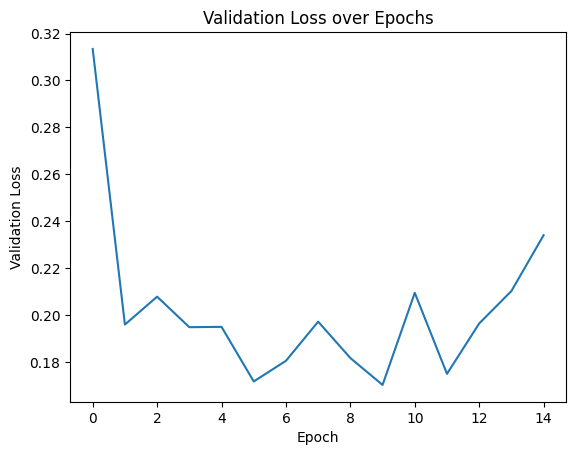

In [ ]:
plt.plot(history.history['val_loss']);
plt.xlabel('Epoch')
plt.ylabel('Validation Loss')
plt.title('Validation Loss over Epochs')
plt.show()

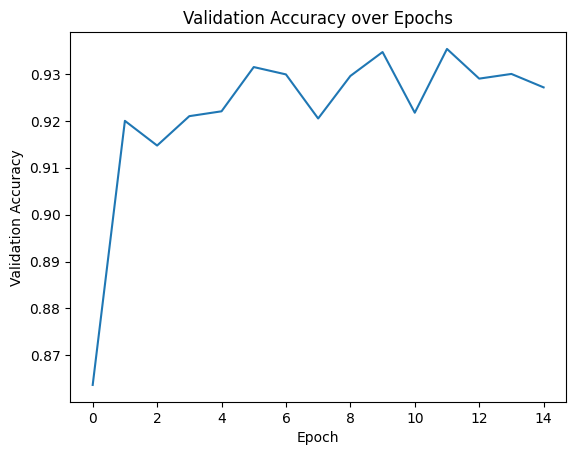

In [ ]:
plt.plot(history.history['val_accuracy']);
plt.xlabel('Epoch')
plt.ylabel('Validation Accuracy')
plt.title('Validation Accuracy over Epochs')
plt.show()

In [ ]:
predictions = network.predict(test_dataset)
predictions


30000/30000 ━━━━━━━━━━━━━━━━━━━━ 106s 4ms/step


array([[1.7515570e-04, 9.9982482e-01],
       [4.8109144e-01, 5.1890856e-01],
       [2.7360559e-06, 9.9999726e-01],
       ...,
       [9.9999940e-01, 6.0495836e-07],
       [7.2283518e-01, 2.7716482e-01],
       [9.9988735e-01, 1.1268074e-04]], dtype=float32)

In [ ]:
test_dataset.class_indices

{'AI': 0, 'human': 1}

In [ ]:
predictions = np.argmax(predictions, axis = 1)
predictions

array([1, 1, 1, ..., 0, 0, 0])

              precision    recall  f1-score   support

           0       0.96      0.93      0.94     20000
           1       0.87      0.92      0.89     10000

    accuracy                           0.93     30000
   macro avg       0.91      0.93      0.92     30000
weighted avg       0.93      0.93      0.93     30000



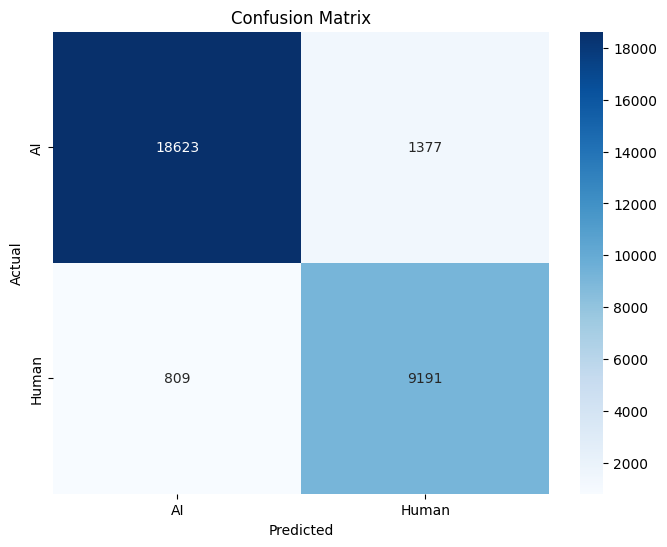

In [ ]:
#import seaborn as sns
#from sklearn.metrics import confusion_matrix, classification_report
#cm = confusion_matrix(test_dataset.classes, predictions)
#sns.heatmap(cm, annot=True)
#print(classification_report(test_dataset.classes, predictions))

import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, classification_report

# Calculate confusion matrix and classification report
cm = confusion_matrix(test_dataset.classes, predictions)
report = classification_report(test_dataset.classes, predictions)

# Define custom labels for the axes
labels = ['AI', 'Human']
cm_df = pd.DataFrame(cm, index=labels, columns=labels)

# Plot confusion matrix using Seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(cm_df, annot=True, fmt='d', cmap='Blues')

# Add labels to the axes
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')

# Print classification report
print(report)

# Show the plot
plt.show()


**Optional: Saving the model network and weights seperately**

In [ ]:
model_json = network.to_json()
with open('network.json','w') as json_file:
  json_file.write(model_json) #save network json

from keras.models import save_model
network_saved = save_model(network, '/kaggle/working/weights.hdf5')

#*Pretrained model*

#**VGG19**

In [ ]:
from keras.applications import VGG19
from keras.models import Sequential
from keras.layers import Dense, Flatten
from keras.layers import Input

base_model = VGG19(include_top=False, weights='imagenet', input_shape=(32, 32, 3))
base_model.trainable = False

model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

80134624/80134624 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


In [ ]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ vgg19 (Functional)              │ (None, 1, 1, 512)      │    20,024,384 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 1, 1, 128)      │       589,952 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 1, 1, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │           514 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 20,647,874 (78.77 MB)

 Trainable params: 623,490 (2.38 MB)

 Non-trainable params: 20,024,384 (76.39 MB)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step - accuracy: 0.9065 - loss: 0.2408
Epoch 1: val_accuracy improved from -inf to 0.92002, saving model to best_model.h5


938/938 ━━━━━━━━━━━━━━━━━━━━ 383s 401ms/step - accuracy: 0.9066 - loss: 0.2408 - val_accuracy: 0.9200 - val_loss: 0.2249
Epoch 2/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step - accuracy: 0.9304 - loss: 0.1848
Epoch 2: val_accuracy improved from 0.92002 to 0.93221, saving model to best_model.h5


938/938 ━━━━━━━━━━━━━━━━━━━━ 215s 229ms/step - accuracy: 0.9304 - loss: 0.1848 - val_accuracy: 0.9322 - val_loss: 0.1791
Epoch 3/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step - accuracy: 0.9347 - loss: 0.1698
Epoch 3: val_accuracy improved from 0.93221 to 0.93501, saving model to best_model.h5


938/938 ━━━━━━━━━━━━━━━━━━━━ 238s 253ms/step - accuracy: 0.9347 - loss: 0.1698 - val_accuracy: 0.9350 - val_loss: 0.1728
Epoch 4/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - accuracy: 0.9373 - loss: 0.1657
Epoch 4: val_accuracy improved from 0.93501 to 0.93521, saving model to best_model.h5


938/938 ━━━━━━━━━━━━━━━━━━━━ 211s 225ms/step - accuracy: 0.9373 - loss: 0.1657 - val_accuracy: 0.9352 - val_loss: 0.1795
Epoch 5/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - accuracy: 0.9391 - loss: 0.1566
Epoch 5: val_accuracy improved from 0.93521 to 0.93701, saving model to best_model.h5


938/938 ━━━━━━━━━━━━━━━━━━━━ 213s 227ms/step - accuracy: 0.9391 - loss: 0.1566 - val_accuracy: 0.9370 - val_loss: 0.1706
Epoch 6/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - accuracy: 0.9436 - loss: 0.1480
Epoch 6: val_accuracy did not improve from 0.93701
938/938 ━━━━━━━━━━━━━━━━━━━━ 252s 268ms/step - accuracy: 0.9436 - loss: 0.1480 - val_accuracy: 0.9353 - val_loss: 0.1756
Epoch 7/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step - accuracy: 0.9439 - loss: 0.1461
Epoch 7: val_accuracy improved from 0.93701 to 0.93788, saving model to best_model.h5


938/938 ━━━━━━━━━━━━━━━━━━━━ 253s 270ms/step - accuracy: 0.9439 - loss: 0.1461 - val_accuracy: 0.9379 - val_loss: 0.1728
Epoch 8/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step - accuracy: 0.9448 - loss: 0.1428
Epoch 8: val_accuracy did not improve from 0.93788
938/938 ━━━━━━━━━━━━━━━━━━━━ 210s 223ms/step - accuracy: 0.9448 - loss: 0.1428 - val_accuracy: 0.9335 - val_loss: 0.1775
Epoch 9/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - accuracy: 0.9484 - loss: 0.1337
Epoch 9: val_accuracy did not improve from 0.93788
938/938 ━━━━━━━━━━━━━━━━━━━━ 212s 227ms/step - accuracy: 0.9484 - loss: 0.1337 - val_accuracy: 0.9241 - val_loss: 0.1963
Epoch 10/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - accuracy: 0.9469 - loss: 0.1345
Epoch 10: val_accuracy did not improve from 0.93788
938/938 ━━━━━━━━━━━━━━━━━━━━ 211s 225ms/step - accuracy: 0.9469 - loss: 0.1345 - val_accuracy: 0.9367 - val_loss: 0.1722


In [ ]:
loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))


2000/2000 ━━━━━━━━━━━━━━━━━━━━ 14s 7ms/step - accuracy: 0.6746 - loss: 0.7931
Test Accuracy: 80.65%


VGG19_Trainable_true

In [ ]:
from keras.applications import VGG19
from keras.models import Sequential
from keras.layers import Dense, Flatten
from keras.layers import Input
from keras.callbacks import ModelCheckpoint

base_model = VGG19(include_top=False, weights='imagenet', input_shape=(32, 32, 3))
base_model.trainable = True  # Freeze base layers

model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

Epoch 1/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step - accuracy: 0.8917 - loss: 0.3153

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()



Epoch 1: val_accuracy improved from -inf to 0.93761, saving model to best_model.h5


938/938 ━━━━━━━━━━━━━━━━━━━━ 332s 345ms/step - accuracy: 0.8917 - loss: 0.3152 - val_accuracy: 0.9376 - val_loss: 0.1684
Epoch 2/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step - accuracy: 0.9304 - loss: 0.1975
Epoch 2: val_accuracy improved from 0.93761 to 0.94015, saving model to best_model.h5


938/938 ━━━━━━━━━━━━━━━━━━━━ 279s 238ms/step - accuracy: 0.9304 - loss: 0.1975 - val_accuracy: 0.9401 - val_loss: 0.1603
Epoch 3/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step - accuracy: 0.9306 - loss: 0.1940
Epoch 3: val_accuracy did not improve from 0.94015
938/938 ━━━━━━━━━━━━━━━━━━━━ 293s 271ms/step - accuracy: 0.9306 - loss: 0.1941 - val_accuracy: 0.8670 - val_loss: 0.3914
Epoch 4/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step - accuracy: 0.8897 - loss: 0.3145
Epoch 4: val_accuracy did not improve from 0.94015
938/938 ━━━━━━━━━━━━━━━━━━━━ 241s 257ms/step - accuracy: 0.8897 - loss: 0.3145 - val_accuracy: 0.9134 - val_loss: 0.2242
Epoch 5/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step - accuracy: 0.9167 - loss: 0.2221
Epoch 5: val_accuracy did not improve from 0.94015
938/938 ━━━━━━━━━━━━━━━━━━━━ 216s 230ms/step - accuracy: 0.9167 - loss: 0.2221 - val_accuracy: 0.9130 - val_loss: 0.2098
Epoch 6/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - accuracy: 0.9301 - loss: 0.1901
Epoch 6: va

938/938 ━━━━━━━━━━━━━━━━━━━━ 216s 230ms/step - accuracy: 0.9301 - loss: 0.1901 - val_accuracy: 0.9458 - val_loss: 0.1579
Epoch 7/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step - accuracy: 0.9289 - loss: 0.1945
Epoch 7: val_accuracy did not improve from 0.94581
938/938 ━━━━━━━━━━━━━━━━━━━━ 242s 258ms/step - accuracy: 0.9289 - loss: 0.1945 - val_accuracy: 0.9342 - val_loss: 0.1727
Epoch 8/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - accuracy: 0.9387 - loss: 0.1678
Epoch 8: val_accuracy did not improve from 0.94581
938/938 ━━━━━━━━━━━━━━━━━━━━ 218s 233ms/step - accuracy: 0.9387 - loss: 0.1678 - val_accuracy: 0.9355 - val_loss: 0.1680
Epoch 9/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step - accuracy: 0.9421 - loss: 0.1561
Epoch 9: val_accuracy did not improve from 0.94581
938/938 ━━━━━━━━━━━━━━━━━━━━ 241s 257ms/step - accuracy: 0.9421 - loss: 0.1562 - val_accuracy: 0.9430 - val_loss: 0.1569
Epoch 10/10
938/938 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - accuracy: 0.9425 - loss: 0.1576
Epoch 10: 

938/938 ━━━━━━━━━━━━━━━━━━━━ 235s 228ms/step - accuracy: 0.9425 - loss: 0.1576 - val_accuracy: 0.9474 - val_loss: 0.1412


In [ ]:
loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


2000/2000 ━━━━━━━━━━━━━━━━━━━━ 15s 7ms/step - accuracy: 0.7020 - loss: 0.7275
Test Accuracy: 83.10%


#**InceptionResNetV2**

In [ ]:
from keras.applications import InceptionResNetV2
from keras.models import Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint

base_model = InceptionResNetV2(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = False  # Freeze the base layers

# Build the model
model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))  # For multi-class; use 1 & sigmoid for binary
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])


219055592/219055592 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step - accuracy: 0.7487 - loss: 0.7981
Epoch 1: val_accuracy improved from -inf to 0.87182, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 239s 362ms/step - accuracy: 0.7488 - loss: 0.7975 - val_accuracy: 0.8718 - val_loss: 0.3054
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step - accuracy: 0.9130 - loss: 0.2121
Epoch 2: val_accuracy improved from 0.87182 to 0.89909, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 154s 190ms/step - accuracy: 0.9130 - loss: 0.2121 - val_accuracy: 0.8991 - val_loss: 0.2458
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step - accuracy: 0.9322 - loss: 0.1630
Epoch 3: val_accuracy improved from 0.89909 to 0.92205, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 104s 190ms/step - accuracy: 0.9322 - loss: 0.1630 - val_accuracy: 0.9220 - val_loss: 0.1981
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step - accuracy: 0.9526 - loss: 0.1217
Epoch 4: val_accuracy did not improve from 0.92205
550/550 ━━━━━━━━━━━━━━━━━━━━ 103s 187ms/step - accuracy: 0.9526 - loss: 0.1217 - val_accuracy: 0.9198 - val_loss: 0.2213
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step - accuracy: 0.9676 - loss: 0.0857
Epoch 5: val_accuracy did not improve from 0.92205
550/550 ━━━━━━━━━━━━━━━━━━━━ 104s 188ms/step - accuracy: 0.9676 - loss: 0.0857 - val_accuracy: 0.9216 - val_loss: 0.2264
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step - accuracy: 0.9754 - loss: 0.0633
Epoch 6: val_accuracy did not improve from 0.92205
550/550 ━━━━━━━━━━━━━━━━━━━━ 103s 187ms/step - accuracy: 0.9754 - loss: 0.0633 - val_accuracy: 0.8952 - val_loss: 0.3545
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step - accuracy: 0.9778 - loss: 0.0594
Epoch 7: va

550/550 ━━━━━━━━━━━━━━━━━━━━ 105s 191ms/step - accuracy: 0.9854 - loss: 0.0430 - val_accuracy: 0.9270 - val_loss: 0.2834
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - accuracy: 0.9857 - loss: 0.0385
Epoch 10: val_accuracy did not improve from 0.92705
550/550 ━━━━━━━━━━━━━━━━━━━━ 131s 238ms/step - accuracy: 0.9857 - loss: 0.0385 - val_accuracy: 0.9202 - val_loss: 0.3428


In [ ]:
loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

2000/2000 ━━━━━━━━━━━━━━━━━━━━ 69s 30ms/step - accuracy: 0.9013 - loss: 0.4034
Test Accuracy: 91.30%


InceptionResNetV2_Trainable_true

In [ ]:
from keras.applications import InceptionResNetV2
from keras.models import Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint

base_model = InceptionResNetV2(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = True

# Build the model
model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 530ms/step - accuracy: 0.8935 - loss: 0.3224
Epoch 1: val_accuracy improved from -inf to 0.96886, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 504s 630ms/step - accuracy: 0.8936 - loss: 0.3221 - val_accuracy: 0.9689 - val_loss: 0.1048
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 533ms/step - accuracy: 0.9840 - loss: 0.0453
Epoch 2: val_accuracy did not improve from 0.96886
550/550 ━━━━━━━━━━━━━━━━━━━━ 315s 572ms/step - accuracy: 0.9840 - loss: 0.0453 - val_accuracy: 0.6680 - val_loss: 1.7389
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 529ms/step - accuracy: 0.9871 - loss: 0.0383
Epoch 3: val_accuracy improved from 0.96886 to 0.97727, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 322s 586ms/step - accuracy: 0.9871 - loss: 0.0383 - val_accuracy: 0.9773 - val_loss: 0.0608
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 523ms/step - accuracy: 0.9923 - loss: 0.0225
Epoch 4: val_accuracy did not improve from 0.97727
550/550 ━━━━━━━━━━━━━━━━━━━━ 308s 560ms/step - accuracy: 0.9923 - loss: 0.0225 - val_accuracy: 0.7575 - val_loss: 3.1214
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 523ms/step - accuracy: 0.9918 - loss: 0.0231
Epoch 5: val_accuracy did not improve from 0.97727
550/550 ━━━━━━━━━━━━━━━━━━━━ 308s 559ms/step - accuracy: 0.9918 - loss: 0.0231 - val_accuracy: 0.9684 - val_loss: 0.1114
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 523ms/step - accuracy: 0.9943 - loss: 0.0208
Epoch 6: val_accuracy did not improve from 0.97727
550/550 ━━━━━━━━━━━━━━━━━━━━ 308s 559ms/step - accuracy: 0.9943 - loss: 0.0208 - val_accuracy: 0.9652 - val_loss: 0.1033
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 522ms/step - accuracy: 0.9940 - loss: 0.0184
Epoch 7: va

550/550 ━━━━━━━━━━━━━━━━━━━━ 314s 570ms/step - accuracy: 0.9956 - loss: 0.0148 - val_accuracy: 0.9966 - val_loss: 0.0096


In [ ]:
loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

2000/2000 ━━━━━━━━━━━━━━━━━━━━ 54s 25ms/step - accuracy: 0.9950 - loss: 0.0157
Test Accuracy: 99.80%


#**Xception**

In [ ]:
from keras.applications import Xception
from keras.models import Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint

base_model = Xception(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = False

# Build the model
model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

83683744/83683744 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - accuracy: 0.8212 - loss: 0.4946
Epoch 1: val_accuracy improved from -inf to 0.92023, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 115s 186ms/step - accuracy: 0.8214 - loss: 0.4942 - val_accuracy: 0.9202 - val_loss: 0.1910
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - accuracy: 0.9417 - loss: 0.1447
Epoch 2: val_accuracy improved from 0.92023 to 0.92909, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 126s 171ms/step - accuracy: 0.9417 - loss: 0.1447 - val_accuracy: 0.9291 - val_loss: 0.1691
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - accuracy: 0.9691 - loss: 0.0852
Epoch 3: val_accuracy did not improve from 0.92909
550/550 ━━━━━━━━━━━━━━━━━━━━ 93s 169ms/step - accuracy: 0.9691 - loss: 0.0852 - val_accuracy: 0.9266 - val_loss: 0.1888
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - accuracy: 0.9821 - loss: 0.0515
Epoch 4: val_accuracy improved from 0.92909 to 0.93500, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 94s 170ms/step - accuracy: 0.9821 - loss: 0.0515 - val_accuracy: 0.9350 - val_loss: 0.2018
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - accuracy: 0.9872 - loss: 0.0365
Epoch 5: val_accuracy improved from 0.93500 to 0.93727, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 96s 175ms/step - accuracy: 0.9872 - loss: 0.0365 - val_accuracy: 0.9373 - val_loss: 0.2172
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - accuracy: 0.9891 - loss: 0.0285
Epoch 6: val_accuracy did not improve from 0.93727
550/550 ━━━━━━━━━━━━━━━━━━━━ 139s 170ms/step - accuracy: 0.9891 - loss: 0.0286 - val_accuracy: 0.9327 - val_loss: 0.2449
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - accuracy: 0.9917 - loss: 0.0257
Epoch 7: val_accuracy did not improve from 0.93727
550/550 ━━━━━━━━━━━━━━━━━━━━ 142s 169ms/step - accuracy: 0.9917 - loss: 0.0257 - val_accuracy: 0.9345 - val_loss: 0.2332
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - accuracy: 0.9937 - loss: 0.0199
Epoch 8: val_accuracy improved from 0.93727 to 0.94136, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 94s 170ms/step - accuracy: 0.9937 - loss: 0.0199 - val_accuracy: 0.9414 - val_loss: 0.2456
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - accuracy: 0.9958 - loss: 0.0134
Epoch 9: val_accuracy did not improve from 0.94136
550/550 ━━━━━━━━━━━━━━━━━━━━ 93s 169ms/step - accuracy: 0.9958 - loss: 0.0134 - val_accuracy: 0.9366 - val_loss: 0.2522
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step - accuracy: 0.9943 - loss: 0.0180
Epoch 10: val_accuracy did not improve from 0.94136
550/550 ━━━━━━━━━━━━━━━━━━━━ 93s 169ms/step - accuracy: 0.9943 - loss: 0.0180 - val_accuracy: 0.9250 - val_loss: 0.3741
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 22s 10ms/step - accuracy: 0.9615 - loss: 0.2129
Test Accuracy: 91.70%


Xception_Trainable_true

In [ ]:
from keras.applications import Xception
from keras.models import Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint

base_model = Xception(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = True

# Build the model
model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

83683744/83683744 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step - accuracy: 0.7100 - loss: 0.5210
Epoch 1: val_accuracy improved from -inf to 0.98750, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 338s 518ms/step - accuracy: 0.7103 - loss: 0.5206 - val_accuracy: 0.9875 - val_loss: 0.0444
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step - accuracy: 0.9850 - loss: 0.0458
Epoch 2: val_accuracy improved from 0.98750 to 0.98886, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 262s 477ms/step - accuracy: 0.9850 - loss: 0.0457 - val_accuracy: 0.9889 - val_loss: 0.0398
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step - accuracy: 0.9927 - loss: 0.0236
Epoch 3: val_accuracy did not improve from 0.98886
550/550 ━━━━━━━━━━━━━━━━━━━━ 256s 466ms/step - accuracy: 0.9927 - loss: 0.0235 - val_accuracy: 0.9561 - val_loss: 0.2791
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step - accuracy: 0.9914 - loss: 0.0282
Epoch 4: val_accuracy improved from 0.98886 to 0.99568, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 262s 476ms/step - accuracy: 0.9914 - loss: 0.0282 - val_accuracy: 0.9957 - val_loss: 0.0171
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step - accuracy: 0.9961 - loss: 0.0153
Epoch 5: val_accuracy did not improve from 0.99568
550/550 ━━━━━━━━━━━━━━━━━━━━ 257s 467ms/step - accuracy: 0.9961 - loss: 0.0153 - val_accuracy: 0.9518 - val_loss: 0.1033
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step - accuracy: 0.9939 - loss: 0.0206
Epoch 6: val_accuracy improved from 0.99568 to 0.99636, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 263s 479ms/step - accuracy: 0.9939 - loss: 0.0206 - val_accuracy: 0.9964 - val_loss: 0.0161
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step - accuracy: 0.9959 - loss: 0.0121
Epoch 7: val_accuracy did not improve from 0.99636
550/550 ━━━━━━━━━━━━━━━━━━━━ 256s 466ms/step - accuracy: 0.9959 - loss: 0.0121 - val_accuracy: 0.9795 - val_loss: 0.0914
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step - accuracy: 0.9954 - loss: 0.0156
Epoch 8: val_accuracy did not improve from 0.99636
550/550 ━━━━━━━━━━━━━━━━━━━━ 262s 465ms/step - accuracy: 0.9954 - loss: 0.0156 - val_accuracy: 0.8989 - val_loss: 1.1787
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step - accuracy: 0.9966 - loss: 0.0091
Epoch 9: val_accuracy did not improve from 0.99636
550/550 ━━━━━━━━━━━━━━━━━━━━ 259s 470ms/step - accuracy: 0.9966 - loss: 0.0091 - val_accuracy: 0.9893 - val_loss: 0.0880
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step - accuracy: 0.9978 - loss: 0.0068
Epoch 10: 

#**DenseNet**

In [ ]:
from keras.applications import DenseNet201
from keras.models import Sequential
from keras.layers import Dense, Flatten, GlobalAveragePooling2D
from keras.layers import Input
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint

base_model = DenseNet201(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = False  # Freeze the base layers

# Build the model
model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(GlobalAveragePooling2D())  # Better than Flatten for ResNet
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

74836368/74836368 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step - accuracy: 0.8481 - loss: 0.3903

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()



Epoch 1: val_accuracy improved from -inf to 0.95818, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 226s 320ms/step - accuracy: 0.8482 - loss: 0.3900 - val_accuracy: 0.9582 - val_loss: 0.1129
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step - accuracy: 0.9722 - loss: 0.0765
Epoch 2: val_accuracy did not improve from 0.95818
550/550 ━━━━━━━━━━━━━━━━━━━━ 88s 159ms/step - accuracy: 0.9722 - loss: 0.0765 - val_accuracy: 0.9432 - val_loss: 0.1685
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step - accuracy: 0.9809 - loss: 0.0524
Epoch 3: val_accuracy improved from 0.95818 to 0.97136, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 89s 162ms/step - accuracy: 0.9809 - loss: 0.0524 - val_accuracy: 0.9714 - val_loss: 0.0910
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step - accuracy: 0.9873 - loss: 0.0351
Epoch 4: val_accuracy did not improve from 0.97136
550/550 ━━━━━━━━━━━━━━━━━━━━ 140s 158ms/step - accuracy: 0.9873 - loss: 0.0351 - val_accuracy: 0.9680 - val_loss: 0.0977
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step - accuracy: 0.9923 - loss: 0.0241
Epoch 5: val_accuracy did not improve from 0.97136
550/550 ━━━━━━━━━━━━━━━━━━━━ 87s 158ms/step - accuracy: 0.9923 - loss: 0.0241 - val_accuracy: 0.9682 - val_loss: 0.1147
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step - accuracy: 0.9911 - loss: 0.0269
Epoch 6: val_accuracy did not improve from 0.97136
550/550 ━━━━━━━━━━━━━━━━━━━━ 87s 158ms/step - accuracy: 0.9911 - loss: 0.0270 - val_accuracy: 0.9709 - val_loss: 0.0934
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - accuracy: 0.9953 - loss: 0.0123
Epoch 7: val_a

550/550 ━━━━━━━━━━━━━━━━━━━━ 88s 160ms/step - accuracy: 0.9988 - loss: 0.0039 - val_accuracy: 0.9741 - val_loss: 0.0880
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step - accuracy: 0.9943 - loss: 0.0150
Epoch 10: val_accuracy improved from 0.97409 to 0.97432, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 143s 161ms/step - accuracy: 0.9943 - loss: 0.0150 - val_accuracy: 0.9743 - val_loss: 0.0993


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


2000/2000 ━━━━━━━━━━━━━━━━━━━━ 57s 21ms/step - accuracy: 0.9765 - loss: 0.1016
Test Accuracy: 97.35%


DenseNet_Trainable_true

In [ ]:
from keras.applications import DenseNet201
from keras.models import Sequential
from keras.layers import Dense, Flatten, GlobalAveragePooling2D
from keras.layers import Input
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint

# Load ResNet50 base model without the top classification layer
base_model = DenseNet201(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = True  # Freeze the base layers

# Build the model
model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding ='same'))
model.add(GlobalAveragePooling2D())  # Better than Flatten for ResNet
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step - accuracy: 0.8654 - loss: 0.3856
Epoch 1: val_accuracy improved from -inf to 0.92682, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 718s 546ms/step - accuracy: 0.8655 - loss: 0.3852 - val_accuracy: 0.9268 - val_loss: 0.2766
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step - accuracy: 0.9718 - loss: 0.0746
Epoch 2: val_accuracy improved from 0.92682 to 0.94886, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 270s 491ms/step - accuracy: 0.9718 - loss: 0.0746 - val_accuracy: 0.9489 - val_loss: 0.1422
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step - accuracy: 0.9792 - loss: 0.0570
Epoch 3: val_accuracy improved from 0.94886 to 0.98977, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 273s 495ms/step - accuracy: 0.9792 - loss: 0.0570 - val_accuracy: 0.9898 - val_loss: 0.0348
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step - accuracy: 0.9899 - loss: 0.0287
Epoch 4: val_accuracy did not improve from 0.98977
550/550 ━━━━━━━━━━━━━━━━━━━━ 313s 479ms/step - accuracy: 0.9899 - loss: 0.0288 - val_accuracy: 0.7393 - val_loss: 2.1472
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step - accuracy: 0.9905 - loss: 0.0270
Epoch 5: val_accuracy did not improve from 0.98977
550/550 ━━━━━━━━━━━━━━━━━━━━ 264s 479ms/step - accuracy: 0.9905 - loss: 0.0270 - val_accuracy: 0.9455 - val_loss: 0.1502
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step - accuracy: 0.9944 - loss: 0.0157
Epoch 6: val_accuracy did not improve from 0.98977
550/550 ━━━━━━━━━━━━━━━━━━━━ 263s 477ms/step - accuracy: 0.9944 - loss: 0.0157 - val_accuracy: 0.9607 - val_loss: 0.1522
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step - accuracy: 0.9940 - loss: 0.0158
Epoch 7: va

550/550 ━━━━━━━━━━━━━━━━━━━━ 269s 489ms/step - accuracy: 0.9940 - loss: 0.0157 - val_accuracy: 0.9975 - val_loss: 0.0065
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step - accuracy: 0.9956 - loss: 0.0131
Epoch 8: val_accuracy did not improve from 0.99750
550/550 ━━━━━━━━━━━━━━━━━━━━ 262s 476ms/step - accuracy: 0.9956 - loss: 0.0131 - val_accuracy: 0.9877 - val_loss: 0.0259
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step - accuracy: 0.9949 - loss: 0.0156
Epoch 9: val_accuracy did not improve from 0.99750
550/550 ━━━━━━━━━━━━━━━━━━━━ 262s 477ms/step - accuracy: 0.9949 - loss: 0.0156 - val_accuracy: 0.9950 - val_loss: 0.0151
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step - accuracy: 0.9973 - loss: 0.0081
Epoch 10: val_accuracy did not improve from 0.99750
550/550 ━━━━━━━━━━━━━━━━━━━━ 263s 479ms/step - accuracy: 0.9973 - loss: 0.0081 - val_accuracy: 0.9875 - val_loss: 0.0399
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 54s 22ms/step - accuracy: 0.9764 - loss: 0.0672
Test Accuracy: 99.

#**EfficientNetB7**

In [ ]:
from keras.applications import EfficientNetB7
from keras.models import Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint

# Load EfficientNetB7 without the top classification layer
base_model = EfficientNetB7(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = False  # Freeze the base layers

model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))  # Use 1 & sigmoid for binary
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

258076736/258076736 ━━━━━━━━━━━━━━━━━━━━ 8s 0us/step
Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step - accuracy: 0.5145 - loss: 4.3251
Epoch 1: val_accuracy improved from -inf to 0.49000, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 278s 361ms/step - accuracy: 0.5145 - loss: 4.3205 - val_accuracy: 0.4900 - val_loss: 0.7306
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step - accuracy: 0.5273 - loss: 0.7281
Epoch 2: val_accuracy did not improve from 0.49000
550/550 ━━━━━━━━━━━━━━━━━━━━ 166s 301ms/step - accuracy: 0.5273 - loss: 0.7281 - val_accuracy: 0.4900 - val_loss: 0.7045
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step - accuracy: 0.5294 - loss: 0.7073
Epoch 3: val_accuracy did not improve from 0.49000
550/550 ━━━━━━━━━━━━━━━━━━━━ 166s 301ms/step - accuracy: 0.5295 - loss: 0.7073 - val_accuracy: 0.4900 - val_loss: 0.6843
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step - accuracy: 0.5549 - loss: 0.6904
Epoch 4: val_accuracy improved from 0.49000 to 0.62432, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 173s 315ms/step - accuracy: 0.5549 - loss: 0.6904 - val_accuracy: 0.6243 - val_loss: 0.6804
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step - accuracy: 0.5373 - loss: 0.6982
Epoch 5: val_accuracy did not improve from 0.62432
550/550 ━━━━━━━━━━━━━━━━━━━━ 175s 318ms/step - accuracy: 0.5373 - loss: 0.6982 - val_accuracy: 0.5984 - val_loss: 0.6690
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step - accuracy: 0.5606 - loss: 0.6866
Epoch 6: val_accuracy did not improve from 0.62432
550/550 ━━━━━━━━━━━━━━━━━━━━ 166s 301ms/step - accuracy: 0.5606 - loss: 0.6866 - val_accuracy: 0.5459 - val_loss: 0.6721
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step - accuracy: 0.5686 - loss: 0.6776
Epoch 7: val_accuracy improved from 0.62432 to 0.64182, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 174s 316ms/step - accuracy: 0.5686 - loss: 0.6776 - val_accuracy: 0.6418 - val_loss: 0.6685
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step - accuracy: 0.5613 - loss: 0.6828
Epoch 8: val_accuracy did not improve from 0.64182
550/550 ━━━━━━━━━━━━━━━━━━━━ 166s 301ms/step - accuracy: 0.5613 - loss: 0.6828 - val_accuracy: 0.5598 - val_loss: 0.6635
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step - accuracy: 0.5770 - loss: 0.6741
Epoch 9: val_accuracy did not improve from 0.64182
550/550 ━━━━━━━━━━━━━━━━━━━━ 166s 301ms/step - accuracy: 0.5770 - loss: 0.6741 - val_accuracy: 0.6257 - val_loss: 0.6530
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step - accuracy: 0.5719 - loss: 0.6840
Epoch 10: val_accuracy did not improve from 0.64182
550/550 ━━━━━━━━━━━━━━━━━━━━ 166s 301ms/step - accuracy: 0.5719 - loss: 0.6840 - val_accuracy: 0.6284 - val_loss: 0.6534
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 56s 24ms/step - accuracy: 0.8050 - loss: 0.6251
Test Accuracy: 61.

EfficientNetB7_Trainable_true

In [ ]:
from keras.applications import EfficientNetB7
from keras.models import Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint

# Load EfficientNetB7 without the top classification layer
base_model = EfficientNetB7(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = True  # Freeze the base layers

model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

258076736/258076736 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 842ms/step - accuracy: 0.8984 - loss: 0.3402
Epoch 1: val_accuracy improved from -inf to 0.51000, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 800s 1s/step - accuracy: 0.8985 - loss: 0.3399 - val_accuracy: 0.5100 - val_loss: 3.1403
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 850ms/step - accuracy: 0.9878 - loss: 0.0390
Epoch 2: val_accuracy improved from 0.51000 to 0.69136, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 510s 927ms/step - accuracy: 0.9878 - loss: 0.0390 - val_accuracy: 0.6914 - val_loss: 0.9997
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 851ms/step - accuracy: 0.9959 - loss: 0.0136
Epoch 3: val_accuracy did not improve from 0.69136
550/550 ━━━━━━━━━━━━━━━━━━━━ 500s 908ms/step - accuracy: 0.9959 - loss: 0.0136 - val_accuracy: 0.4900 - val_loss: 57.8733
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 852ms/step - accuracy: 0.9873 - loss: 0.0467
Epoch 4: val_accuracy did not improve from 0.69136
550/550 ━━━━━━━━━━━━━━━━━━━━ 509s 926ms/step - accuracy: 0.9873 - loss: 0.0468 - val_accuracy: 0.5066 - val_loss: 10.6589
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 851ms/step - accuracy: 0.9814 - loss: 0.0658
Epoch 5: val_accuracy improved from 0.69136 to 0.98886, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 512s 930ms/step - accuracy: 0.9814 - loss: 0.0657 - val_accuracy: 0.9889 - val_loss: 0.0327
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 850ms/step - accuracy: 0.9977 - loss: 0.0066
Epoch 6: val_accuracy did not improve from 0.98886
550/550 ━━━━━━━━━━━━━━━━━━━━ 499s 908ms/step - accuracy: 0.9977 - loss: 0.0066 - val_accuracy: 0.8795 - val_loss: 0.4906
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 849ms/step - accuracy: 0.9977 - loss: 0.0075
Epoch 7: val_accuracy did not improve from 0.98886
550/550 ━━━━━━━━━━━━━━━━━━━━ 499s 906ms/step - accuracy: 0.9977 - loss: 0.0075 - val_accuracy: 0.5516 - val_loss: 2.5930
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 850ms/step - accuracy: 0.9972 - loss: 0.0118
Epoch 8: val_accuracy did not improve from 0.98886
550/550 ━━━━━━━━━━━━━━━━━━━━ 508s 924ms/step - accuracy: 0.9972 - loss: 0.0118 - val_accuracy: 0.6936 - val_loss: 0.8804
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 850ms/step - accuracy: 0.9994 - loss: 0.0023
Epoch 9: va

#**MobileNetV2**

In [ ]:
from keras.applications import MobileNetV2
from keras.models import Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint

# Load EfficientNetB7 without the top classification layer
base_model = MobileNetV2(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = False  # Freeze the base layers

model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))  # Use 1 & sigmoid for binary
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step - accuracy: 0.8881 - loss: 0.5796
Epoch 1: val_accuracy improved from -inf to 0.91977, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 166s 282ms/step - accuracy: 0.8882 - loss: 0.5790 - val_accuracy: 0.9198 - val_loss: 0.2587
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step - accuracy: 0.9782 - loss: 0.0570
Epoch 2: val_accuracy improved from 0.91977 to 0.96114, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 66s 120ms/step - accuracy: 0.9782 - loss: 0.0570 - val_accuracy: 0.9611 - val_loss: 0.1221
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - accuracy: 0.9894 - loss: 0.0281
Epoch 3: val_accuracy improved from 0.96114 to 0.97227, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 64s 116ms/step - accuracy: 0.9894 - loss: 0.0281 - val_accuracy: 0.9723 - val_loss: 0.0878
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - accuracy: 0.9952 - loss: 0.0152
Epoch 4: val_accuracy did not improve from 0.97227
550/550 ━━━━━━━━━━━━━━━━━━━━ 64s 116ms/step - accuracy: 0.9952 - loss: 0.0152 - val_accuracy: 0.9570 - val_loss: 0.1790
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - accuracy: 0.9940 - loss: 0.0171
Epoch 5: val_accuracy did not improve from 0.97227
550/550 ━━━━━━━━━━━━━━━━━━━━ 62s 113ms/step - accuracy: 0.9940 - loss: 0.0171 - val_accuracy: 0.9723 - val_loss: 0.1043
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step - accuracy: 0.9963 - loss: 0.0109
Epoch 6: val_accuracy did not improve from 0.97227
550/550 ━━━━━━━━━━━━━━━━━━━━ 64s 117ms/step - accuracy: 0.9963 - loss: 0.0109 - val_accuracy: 0.9716 - val_loss: 0.1185
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - accuracy: 0.9967 - loss: 0.0104
Epoch 7: val_accura

MobileNetV2_trainable_true

In [ ]:
from keras.applications import MobileNetV2
from keras.models import Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint

# Load EfficientNetB7 without the top classification layer
base_model = MobileNetV2(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = True  # Freeze the base layers

model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))  # Use 1 & sigmoid for binary
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - accuracy: 0.9046 - loss: 0.4733
Epoch 1: val_accuracy improved from -inf to 0.49023, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 123s 143ms/step - accuracy: 0.9047 - loss: 0.4728 - val_accuracy: 0.4902 - val_loss: 11.9853
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - accuracy: 0.9755 - loss: 0.0755
Epoch 2: val_accuracy improved from 0.49023 to 0.49114, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 74s 134ms/step - accuracy: 0.9755 - loss: 0.0754 - val_accuracy: 0.4911 - val_loss: 7.4767
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - accuracy: 0.9879 - loss: 0.0384
Epoch 3: val_accuracy improved from 0.49114 to 0.49386, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 75s 136ms/step - accuracy: 0.9879 - loss: 0.0384 - val_accuracy: 0.4939 - val_loss: 17.4879
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - accuracy: 0.9866 - loss: 0.0467
Epoch 4: val_accuracy did not improve from 0.49386
550/550 ━━━━━━━━━━━━━━━━━━━━ 74s 133ms/step - accuracy: 0.9866 - loss: 0.0466 - val_accuracy: 0.4900 - val_loss: 11.5655
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step - accuracy: 0.9925 - loss: 0.0260
Epoch 5: val_accuracy improved from 0.49386 to 0.90818, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 74s 134ms/step - accuracy: 0.9925 - loss: 0.0260 - val_accuracy: 0.9082 - val_loss: 0.5459
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - accuracy: 0.9922 - loss: 0.0316
Epoch 6: val_accuracy did not improve from 0.90818
550/550 ━━━━━━━━━━━━━━━━━━━━ 73s 133ms/step - accuracy: 0.9922 - loss: 0.0317 - val_accuracy: 0.4989 - val_loss: 5.1771
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - accuracy: 0.9847 - loss: 0.0490
Epoch 7: val_accuracy did not improve from 0.90818
550/550 ━━━━━━━━━━━━━━━━━━━━ 73s 133ms/step - accuracy: 0.9847 - loss: 0.0490 - val_accuracy: 0.4900 - val_loss: 47.8130
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - accuracy: 0.9727 - loss: 0.0811
Epoch 8: val_accuracy did not improve from 0.90818
550/550 ━━━━━━━━━━━━━━━━━━━━ 73s 132ms/step - accuracy: 0.9727 - loss: 0.0811 - val_accuracy: 0.4911 - val_loss: 57.6254
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step - accuracy: 0.9914 - loss: 0.0356
Epoch 9: val_

550/550 ━━━━━━━━━━━━━━━━━━━━ 73s 133ms/step - accuracy: 0.9970 - loss: 0.0095 - val_accuracy: 0.9432 - val_loss: 0.5564
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 15s 7ms/step - accuracy: 0.9024 - loss: 0.9702
Test Accuracy: 94.05%


#*Petrained with attention*


#**MobileNetV2_trainable_true**

In [ ]:
from keras.applications import MobileNetV2
from keras.models import Sequential
from keras.layers import Dense, Flatten
from keras.layers import Input

base_model = MobileNetV2(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = True  # Freeze base layers

model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras import models, optimizers
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Activation, Dropout,
                                     GlobalAveragePooling2D, Dense, Input, Multiply,
                                     GlobalMaxPooling2D, Concatenate, Reshape)
from tensorflow.keras.regularizers import l2

# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])

# Input
input_layer = Input(shape=(224, 224, 3))
base_model = MobileNetV2(weights='imagenet', include_top=False, input_tensor=input_layer)
base_model.trainable = True
for layer in base_model.layers[:100]:
    layer.trainable = False

x = base_model.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
output = Dense(2, activation='softmax')(x)

model = models.Model(inputs=input_layer, outputs=output)
model.summary()

<ipython-input-44-3684a4a1f964>:27: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  base_model = MobileNetV2(weights='imagenet', include_top=False, input_tensor=input_layer)


Model: "functional_39"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_21      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer_21[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,639,045 (10.07 MB)

 Trainable params: 2,242,437 (8.55 MB)

 Non-trainable params: 396,608 (1.51 MB)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model for the specified number of epochs
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step - accuracy: 0.9472 - loss: 0.1621
Epoch 1: val_accuracy improved from -inf to 0.82864, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 98s 141ms/step - accuracy: 0.9473 - loss: 0.1620 - val_accuracy: 0.8286 - val_loss: 1.0664
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step - accuracy: 0.9871 - loss: 0.0383
Epoch 2: val_accuracy did not improve from 0.82864
550/550 ━━━━━━━━━━━━━━━━━━━━ 66s 119ms/step - accuracy: 0.9871 - loss: 0.0383 - val_accuracy: 0.4902 - val_loss: 9.1530
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step - accuracy: 0.9913 - loss: 0.0249
Epoch 3: val_accuracy improved from 0.82864 to 0.92591, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 82s 119ms/step - accuracy: 0.9913 - loss: 0.0249 - val_accuracy: 0.9259 - val_loss: 1.0263
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step - accuracy: 0.9938 - loss: 0.0195
Epoch 4: val_accuracy did not improve from 0.92591
550/550 ━━━━━━━━━━━━━━━━━━━━ 66s 119ms/step - accuracy: 0.9938 - loss: 0.0195 - val_accuracy: 0.6364 - val_loss: 7.2122
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - accuracy: 0.9960 - loss: 0.0122
Epoch 5: val_accuracy improved from 0.92591 to 0.98114, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 67s 122ms/step - accuracy: 0.9960 - loss: 0.0122 - val_accuracy: 0.9811 - val_loss: 0.1323
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step - accuracy: 0.9954 - loss: 0.0134
Epoch 6: val_accuracy improved from 0.98114 to 0.98636, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 66s 120ms/step - accuracy: 0.9954 - loss: 0.0134 - val_accuracy: 0.9864 - val_loss: 0.0932
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - accuracy: 0.9955 - loss: 0.0116
Epoch 7: val_accuracy did not improve from 0.98636
550/550 ━━━━━━━━━━━━━━━━━━━━ 67s 122ms/step - accuracy: 0.9955 - loss: 0.0116 - val_accuracy: 0.9820 - val_loss: 0.1728
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step - accuracy: 0.9975 - loss: 0.0068
Epoch 8: val_accuracy did not improve from 0.98636
550/550 ━━━━━━━━━━━━━━━━━━━━ 66s 120ms/step - accuracy: 0.9975 - loss: 0.0068 - val_accuracy: 0.8127 - val_loss: 2.8542
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step - accuracy: 0.9971 - loss: 0.0107
Epoch 9: val_accuracy improved from 0.98636 to 0.99136, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 66s 120ms/step - accuracy: 0.9971 - loss: 0.0107 - val_accuracy: 0.9914 - val_loss: 0.0764
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step - accuracy: 0.9973 - loss: 0.0084
Epoch 10: val_accuracy did not improve from 0.99136
550/550 ━━━━━━━━━━━━━━━━━━━━ 65s 118ms/step - accuracy: 0.9973 - loss: 0.0084 - val_accuracy: 0.9848 - val_loss: 0.1096
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 17s 8ms/step - accuracy: 0.9910 - loss: 0.0644
Test Accuracy: 97.80%


In [ ]:
from keras.applications import MobileNetV2
from keras.models import Sequential
from keras.layers import Dense, Flatten
from keras.layers import Input

base_model = MobileNetV2(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = False  # Freeze base layers

model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras import models, optimizers
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Activation, Dropout,
                                     GlobalAveragePooling2D, Dense, Input, Multiply,
                                     GlobalMaxPooling2D, Concatenate, Reshape)
from tensorflow.keras.regularizers import l2

# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])

# Input
input_layer = Input(shape=(224, 224, 3))
base_model = MobileNetV2(weights='imagenet', include_top=False, input_tensor=input_layer)
base_model.trainable = False
for layer in base_model.layers[:100]:
    layer.trainable = False

x = base_model.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
output = Dense(2, activation='softmax')(x)

model = models.Model(inputs=input_layer, outputs=output)
model.summary()

<ipython-input-6-6699cbff11dc>:27: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  base_model = MobileNetV2(weights='imagenet', include_top=False, input_tensor=input_layer)


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer_2[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,639,045 (10.07 MB)

 Trainable params: 380,997 (1.45 MB)

 Non-trainable params: 2,258,048 (8.61 MB)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model for the specified number of epochs
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step - accuracy: 0.9158 - loss: 0.2243
Epoch 1: val_accuracy improved from -inf to 0.96045, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 123s 198ms/step - accuracy: 0.9159 - loss: 0.2242 - val_accuracy: 0.9605 - val_loss: 0.0993
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - accuracy: 0.9723 - loss: 0.0826
Epoch 2: val_accuracy improved from 0.96045 to 0.96205, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 63s 114ms/step - accuracy: 0.9723 - loss: 0.0826 - val_accuracy: 0.9620 - val_loss: 0.1102
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - accuracy: 0.9768 - loss: 0.0675
Epoch 3: val_accuracy improved from 0.96205 to 0.96432, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 62s 112ms/step - accuracy: 0.9768 - loss: 0.0675 - val_accuracy: 0.9643 - val_loss: 0.0961
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - accuracy: 0.9852 - loss: 0.0471
Epoch 4: val_accuracy did not improve from 0.96432
550/550 ━━━━━━━━━━━━━━━━━━━━ 63s 115ms/step - accuracy: 0.9852 - loss: 0.0471 - val_accuracy: 0.9632 - val_loss: 0.1076
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - accuracy: 0.9836 - loss: 0.0449
Epoch 5: val_accuracy improved from 0.96432 to 0.96727, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 63s 115ms/step - accuracy: 0.9836 - loss: 0.0449 - val_accuracy: 0.9673 - val_loss: 0.0986
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - accuracy: 0.9866 - loss: 0.0359
Epoch 6: val_accuracy did not improve from 0.96727
550/550 ━━━━━━━━━━━━━━━━━━━━ 64s 115ms/step - accuracy: 0.9866 - loss: 0.0359 - val_accuracy: 0.9650 - val_loss: 0.1062
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step - accuracy: 0.9891 - loss: 0.0315
Epoch 7: val_accuracy did not improve from 0.96727
550/550 ━━━━━━━━━━━━━━━━━━━━ 63s 115ms/step - accuracy: 0.9891 - loss: 0.0315 - val_accuracy: 0.9616 - val_loss: 0.1213
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step - accuracy: 0.9883 - loss: 0.0285
Epoch 8: val_accuracy improved from 0.96727 to 0.97091, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 63s 115ms/step - accuracy: 0.9883 - loss: 0.0285 - val_accuracy: 0.9709 - val_loss: 0.1034
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step - accuracy: 0.9940 - loss: 0.0180
Epoch 9: val_accuracy did not improve from 0.97091
550/550 ━━━━━━━━━━━━━━━━━━━━ 65s 117ms/step - accuracy: 0.9940 - loss: 0.0180 - val_accuracy: 0.9666 - val_loss: 0.1157
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step - accuracy: 0.9922 - loss: 0.0227
Epoch 10: val_accuracy did not improve from 0.97091
550/550 ━━━━━━━━━━━━━━━━━━━━ 74s 134ms/step - accuracy: 0.9922 - loss: 0.0227 - val_accuracy: 0.9684 - val_loss: 0.1132
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 18s 7ms/step - accuracy: 0.9635 - loss: 0.1195
Test Accuracy: 96.65%


#**InceptionResNetV2_trainable_true**

In [ ]:
from keras.applications import InceptionResNetV2
from keras.models import Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam

base_model = InceptionResNetV2(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = True  # Freeze the base layers

# Build the model
model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))

# Compile the model
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
from tensorflow.keras.applications import InceptionResNetV2
from tensorflow.keras import models, optimizers
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Activation, Dropout,
                                     GlobalAveragePooling2D, Dense, Input, Multiply,
                                     GlobalMaxPooling2D, Concatenate, Reshape)
from tensorflow.keras.regularizers import l2

# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])

# Input - minimum recommended size for InceptionResNetV2 is 75x75
input_layer = Input(shape=(224, 224, 3))
base_model = InceptionResNetV2(weights='imagenet', include_top=False, input_tensor=input_layer)
base_model.trainable = True
# Freeze initial layers if needed
for layer in base_model.layers[:100]:
    layer.trainable = False

# Add custom layers
x = base_model.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
output = Dense(2, activation='softmax')(x)

# Build and summarize model
model = models.Model(inputs=input_layer, outputs=output)
model.summary()


Model: "functional_9"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_9       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1225         │ (None, 111, 111,  │        864 │ input_layer_9[0]… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 111, 111,  │         96 │ conv2d_1225[0][0] │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1218     │ (None, 111, 111,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1226         │ (None, 109, 109,  │      9,216 │ activation_1218[… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │         96 │ conv2d_1226[0][0] │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1219     │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1227         │ (None, 109, 109,  │     18,432 │ activation_1219[… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │        192 │ conv2d_1227[0][0] │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1220     │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_26    │ (None, 54, 54,    │          0 │ activation_1220[… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1228         │ (None, 54, 54,    │      5,120 │ max_pooling2d_26… │
│ (Conv2D)            │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 54, 54,    │        240 │ conv2d_1228[0][0] │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1221     │ (None, 54, 54,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1229         │ (None, 52, 52,    │    138,240 │ activation_1221[… │
│ (Conv2D)            │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 52, 52,    │        576 │ conv2d_1229[0][0] │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1222     │ (None, 52, 52,    │          0 │ batch_normalizat

 Total params: 54,791,525 (209.01 MB)

 Trainable params: 53,963,349 (205.85 MB)

 Non-trainable params: 828,176 (3.16 MB)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model for the specified number of epochs
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step - accuracy: 0.9281 - loss: 0.1925
Epoch 1: val_accuracy improved from -inf to 0.96477, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 474s 596ms/step - accuracy: 0.9281 - loss: 0.1924 - val_accuracy: 0.9648 - val_loss: 0.0981
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step - accuracy: 0.9821 - loss: 0.0508
Epoch 2: val_accuracy did not improve from 0.96477
550/550 ━━━━━━━━━━━━━━━━━━━━ 276s 501ms/step - accuracy: 0.9821 - loss: 0.0508 - val_accuracy: 0.9475 - val_loss: 0.1307
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step - accuracy: 0.9886 - loss: 0.0349
Epoch 3: val_accuracy improved from 0.96477 to 0.98159, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 287s 523ms/step - accuracy: 0.9886 - loss: 0.0349 - val_accuracy: 0.9816 - val_loss: 0.0668
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step - accuracy: 0.9911 - loss: 0.0262
Epoch 4: val_accuracy did not improve from 0.98159
550/550 ━━━━━━━━━━━━━━━━━━━━ 276s 501ms/step - accuracy: 0.9910 - loss: 0.0262 - val_accuracy: 0.9693 - val_loss: 0.0880
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step - accuracy: 0.9931 - loss: 0.0195
Epoch 5: val_accuracy did not improve from 0.98159
550/550 ━━━━━━━━━━━━━━━━━━━━ 276s 502ms/step - accuracy: 0.9931 - loss: 0.0195 - val_accuracy: 0.9805 - val_loss: 0.0569
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step - accuracy: 0.9953 - loss: 0.0128
Epoch 6: val_accuracy did not improve from 0.98159
550/550 ━━━━━━━━━━━━━━━━━━━━ 277s 503ms/step - accuracy: 0.9953 - loss: 0.0128 - val_accuracy: 0.8702 - val_loss: 0.5259
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step - accuracy: 0.9970 - loss: 0.0096
Epoch 7: va

550/550 ━━━━━━━━━━━━━━━━━━━━ 283s 514ms/step - accuracy: 0.9970 - loss: 0.0096 - val_accuracy: 0.9886 - val_loss: 0.0280
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step - accuracy: 0.9962 - loss: 0.0108
Epoch 8: val_accuracy did not improve from 0.98864
550/550 ━━━━━━━━━━━━━━━━━━━━ 314s 500ms/step - accuracy: 0.9962 - loss: 0.0108 - val_accuracy: 0.9689 - val_loss: 0.0842
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step - accuracy: 0.9968 - loss: 0.0099
Epoch 9: val_accuracy did not improve from 0.98864
550/550 ━━━━━━━━━━━━━━━━━━━━ 275s 499ms/step - accuracy: 0.9968 - loss: 0.0099 - val_accuracy: 0.9839 - val_loss: 0.0484
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step - accuracy: 0.9978 - loss: 0.0067
Epoch 10: val_accuracy did not improve from 0.98864
550/550 ━━━━━━━━━━━━━━━━━━━━ 275s 499ms/step - accuracy: 0.9978 - loss: 0.0067 - val_accuracy: 0.9682 - val_loss: 0.0844
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 57s 25ms/step - accuracy: 0.9895 - loss: 0.0292
Test Accuracy: 97.

In [ ]:
from keras.applications import InceptionResNetV2
from keras.models import Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam

base_model = InceptionResNetV2(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = False # Freeze the base layers

# Build the model
model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))

# Compile the model
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

219055592/219055592 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


In [ ]:
from tensorflow.keras.applications import InceptionResNetV2
from tensorflow.keras import models, optimizers
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Activation, Dropout,
                                     GlobalAveragePooling2D, Dense, Input, Multiply,
                                     GlobalMaxPooling2D, Concatenate, Reshape)
from tensorflow.keras.regularizers import l2

# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])

# Input - minimum recommended size for InceptionResNetV2 is 75x75
input_layer = Input(shape=(224, 224, 3))
base_model = InceptionResNetV2(weights='imagenet', include_top=False, input_tensor=input_layer)
base_model.trainable = False
# Freeze initial layers if needed
for layer in base_model.layers[:100]:
    layer.trainable = False

# Add custom layers
x = base_model.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
output = Dense(2, activation='softmax')(x)

# Build and summarize model
model = models.Model(inputs=input_layer, outputs=output)
model.summary()

Model: "functional_14"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_213 (Conv2D) │ (None, 111, 111,  │        864 │ input_layer_8[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 111, 111,  │         96 │ conv2d_213[0][0]  │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_203      │ (None, 111, 111,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_214 (Conv2D) │ (None, 109, 109,  │      9,216 │ activation_203[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │         96 │ conv2d_214[0][0]  │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_204      │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_215 (Conv2D) │ (None, 109, 109,  │     18,432 │ activation_204[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 109, 109,  │        192 │ conv2d_215[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_205      │ (None, 109, 109,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_6     │ (None, 54, 54,    │          0 │ activation_205[0… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_216 (Conv2D) │ (None, 54, 54,    │      5,120 │ max_pooling2d_6[… │
│                     │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 54, 54,    │        240 │ conv2d_216[0][0]  │
│ (BatchNormalizatio… │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_206      │ (None, 54, 54,    │          0 │ batch_normalizat… │
│ (Activation)        │ 80)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_217 (Conv2D) │ (None, 52, 52,    │    138,240 │ activation_206[0… │
│                     │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 52, 52,    │        576 │ conv2d_217[0][0]  │
│ (BatchNormalizatio… │ 192)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_207      │ (None, 52, 52,    │          0 │ batch_normalizat

 Total params: 54,791,525 (209.01 MB)

 Trainable params: 454,725 (1.73 MB)

 Non-trainable params: 54,336,800 (207.28 MB)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model for the specified number of epochs
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.8073 - loss: 0.4076
Epoch 1: val_accuracy improved from -inf to 0.89091, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 161s 225ms/step - accuracy: 0.8074 - loss: 0.4074 - val_accuracy: 0.8909 - val_loss: 0.2522
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.9100 - loss: 0.2243
Epoch 2: val_accuracy did not improve from 0.89091
550/550 ━━━━━━━━━━━━━━━━━━━━ 101s 184ms/step - accuracy: 0.9100 - loss: 0.2243 - val_accuracy: 0.8441 - val_loss: 0.3622
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.9329 - loss: 0.1737
Epoch 3: val_accuracy improved from 0.89091 to 0.91636, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 107s 195ms/step - accuracy: 0.9329 - loss: 0.1738 - val_accuracy: 0.9164 - val_loss: 0.2034
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.9350 - loss: 0.1611
Epoch 4: val_accuracy improved from 0.91636 to 0.93250, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 108s 196ms/step - accuracy: 0.9350 - loss: 0.1611 - val_accuracy: 0.9325 - val_loss: 0.1701
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.9484 - loss: 0.1321
Epoch 5: val_accuracy did not improve from 0.93250
550/550 ━━━━━━━━━━━━━━━━━━━━ 135s 183ms/step - accuracy: 0.9484 - loss: 0.1321 - val_accuracy: 0.9266 - val_loss: 0.1878
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step - accuracy: 0.9574 - loss: 0.1129
Epoch 6: val_accuracy did not improve from 0.93250
550/550 ━━━━━━━━━━━━━━━━━━━━ 102s 185ms/step - accuracy: 0.9574 - loss: 0.1129 - val_accuracy: 0.9195 - val_loss: 0.1982
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step - accuracy: 0.9616 - loss: 0.1060
Epoch 7: val_accuracy improved from 0.93250 to 0.93432, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 108s 196ms/step - accuracy: 0.9616 - loss: 0.1060 - val_accuracy: 0.9343 - val_loss: 0.1841
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.9642 - loss: 0.0908
Epoch 8: val_accuracy improved from 0.93432 to 0.94159, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 141s 195ms/step - accuracy: 0.9642 - loss: 0.0908 - val_accuracy: 0.9416 - val_loss: 0.1741
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step - accuracy: 0.9674 - loss: 0.0829
Epoch 9: val_accuracy did not improve from 0.94159
550/550 ━━━━━━━━━━━━━━━━━━━━ 101s 184ms/step - accuracy: 0.9674 - loss: 0.0829 - val_accuracy: 0.9405 - val_loss: 0.1646
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step - accuracy: 0.9728 - loss: 0.0729
Epoch 10: val_accuracy did not improve from 0.94159
550/550 ━━━━━━━━━━━━━━━━━━━━ 101s 183ms/step - accuracy: 0.9728 - loss: 0.0729 - val_accuracy: 0.9361 - val_loss: 0.1786
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 50s 22ms/step - accuracy: 0.9299 - loss: 0.1975
Test Accuracy: 92.95%


#**Xception_trainable_true**

In [ ]:
from keras.applications import Xception
from keras.models import Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam

base_model = Xception(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = True

# Build the model
model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))  # For multi-class; use 1 & sigmoid for binary

# Compile the model
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

83683744/83683744 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step


In [ ]:
from tensorflow.keras.applications import Xception
from tensorflow.keras import models
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Dense, Dropout, Input,
                                     GlobalAveragePooling2D, GlobalMaxPooling2D, Multiply,
                                     Concatenate, Reshape)
from tensorflow.keras.regularizers import l2

# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])

# Input - suitable size for Xception
input_layer = Input(shape=(224, 224, 3))
base_model = Xception(weights='imagenet', include_top=False, input_tensor=input_layer)
base_model.trainable = True

# Optionally freeze some layers
for layer in base_model.layers[:100]:
    layer.trainable = False

# Custom top layers with SE and spatial attention
x = base_model.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
output = Dense(2, activation='softmax')(x)

# Final model
model = models.Model(inputs=input_layer, outputs=output)
model.summary()

Model: "functional_15"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_12      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1        │ (None, 111, 111,  │        864 │ input_layer_12[0… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_bn     │ (None, 111, 111,  │        128 │ block1_conv1[0][… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_act    │ (None, 111, 111,  │          0 │ block1_conv1_bn[… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2        │ (None, 109, 109,  │     18,432 │ block1_conv1_act… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_bn     │ (None, 109, 109,  │        256 │ block1_conv2[0][… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_act    │ (None, 109, 109,  │          0 │ block1_conv2_bn[… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1     │ (None, 109, 109,  │      8,768 │ block1_conv2_act… │
│ (SeparableConv2D)   │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1_bn  │ (None, 109, 109,  │        512 │ block2_sepconv1[… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_act │ (None, 109, 109,  │          0 │ block2_sepconv1_… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2     │ (None, 109, 109,  │     17,536 │ block2_sepconv2_… │
│ (SeparableConv2D)   │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_bn  │ (None, 109, 109,  │        512 │ block2_sepconv2[… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1435         │ (None, 55, 55,    │      8,192 │ block1_conv2_act… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_pool         │ (None, 55, 55,    │          0 │ block2_sepconv2_… │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 55, 55,    │        512 │ conv2d_1435[0][0] │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_12 (Add)        │ (None, 55, 55,    │          0 │ block2_pool[0][0… │
│                     │ 128)              │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block3_sepconv1_act │ (None, 55, 55,    │          0 │ add_12[0][0]    

 Total params: 21,463,725 (81.88 MB)

 Trainable params: 10,080,525 (38.45 MB)

 Non-trainable params: 11,383,200 (43.42 MB)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model for the specified number of epochs
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step - accuracy: 0.9164 - loss: 0.2098
Epoch 1: val_accuracy improved from -inf to 0.94023, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 170s 257ms/step - accuracy: 0.9165 - loss: 0.2096 - val_accuracy: 0.9402 - val_loss: 0.2024
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step - accuracy: 0.9858 - loss: 0.0392
Epoch 2: val_accuracy improved from 0.94023 to 0.97727, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 138s 251ms/step - accuracy: 0.9858 - loss: 0.0392 - val_accuracy: 0.9773 - val_loss: 0.0776
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step - accuracy: 0.9918 - loss: 0.0225
Epoch 3: val_accuracy improved from 0.97727 to 0.98136, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 133s 241ms/step - accuracy: 0.9918 - loss: 0.0225 - val_accuracy: 0.9814 - val_loss: 0.0560
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step - accuracy: 0.9945 - loss: 0.0169
Epoch 4: val_accuracy improved from 0.98136 to 0.99023, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 138s 251ms/step - accuracy: 0.9945 - loss: 0.0169 - val_accuracy: 0.9902 - val_loss: 0.0321
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step - accuracy: 0.9959 - loss: 0.0136
Epoch 5: val_accuracy did not improve from 0.99023
550/550 ━━━━━━━━━━━━━━━━━━━━ 133s 242ms/step - accuracy: 0.9959 - loss: 0.0136 - val_accuracy: 0.9861 - val_loss: 0.0379
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step - accuracy: 0.9964 - loss: 0.0105
Epoch 6: val_accuracy improved from 0.99023 to 0.99091, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 137s 250ms/step - accuracy: 0.9964 - loss: 0.0105 - val_accuracy: 0.9909 - val_loss: 0.0268
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step - accuracy: 0.9967 - loss: 0.0102
Epoch 7: val_accuracy did not improve from 0.99091
550/550 ━━━━━━━━━━━━━━━━━━━━ 133s 242ms/step - accuracy: 0.9967 - loss: 0.0102 - val_accuracy: 0.9891 - val_loss: 0.0270
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step - accuracy: 0.9966 - loss: 0.0093
Epoch 8: val_accuracy improved from 0.99091 to 0.99136, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 137s 249ms/step - accuracy: 0.9966 - loss: 0.0093 - val_accuracy: 0.9914 - val_loss: 0.0254
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step - accuracy: 0.9963 - loss: 0.0087
Epoch 9: val_accuracy improved from 0.99136 to 0.99250, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 143s 252ms/step - accuracy: 0.9963 - loss: 0.0087 - val_accuracy: 0.9925 - val_loss: 0.0241
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step - accuracy: 0.9994 - loss: 0.0030
Epoch 10: val_accuracy did not improve from 0.99250
550/550 ━━━━━━━━━━━━━━━━━━━━ 137s 242ms/step - accuracy: 0.9994 - loss: 0.0030 - val_accuracy: 0.9898 - val_loss: 0.0273
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 22s 10ms/step - accuracy: 0.9903 - loss: 0.0350
Test Accuracy: 99.20%


#**Xception_trainable_false**

In [ ]:
from keras.applications import Xception
from keras.models import Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam

base_model = Xception(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = False

# Build the model
model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))  # For multi-class; use 1 & sigmoid for binary

# Compile the model
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

83683744/83683744 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [ ]:
from tensorflow.keras.applications import Xception
from tensorflow.keras import models
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Dense, Dropout, Input,
                                     GlobalAveragePooling2D, GlobalMaxPooling2D, Multiply,
                                     Concatenate, Reshape)
from tensorflow.keras.regularizers import l2

# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])

# Input - suitable size for Xception
input_layer = Input(shape=(224, 224, 3))
base_model = Xception(weights='imagenet', include_top=False, input_tensor=input_layer)
base_model.trainable = False

# Optionally freeze some layers
for layer in base_model.layers[:100]:
    layer.trainable = False

# Custom top layers with SE and spatial attention
x = base_model.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
output = Dense(2, activation='softmax')(x)

# Final model
model = models.Model(inputs=input_layer, outputs=output)
model.summary()

Model: "functional_11"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_5       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1        │ (None, 111, 111,  │        864 │ input_layer_5[0]… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_bn     │ (None, 111, 111,  │        128 │ block1_conv1[0][… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_act    │ (None, 111, 111,  │          0 │ block1_conv1_bn[… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2        │ (None, 109, 109,  │     18,432 │ block1_conv1_act… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_bn     │ (None, 109, 109,  │        256 │ block1_conv2[0][… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_act    │ (None, 109, 109,  │          0 │ block1_conv2_bn[… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1     │ (None, 109, 109,  │      8,768 │ block1_conv2_act… │
│ (SeparableConv2D)   │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1_bn  │ (None, 109, 109,  │        512 │ block2_sepconv1[… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_act │ (None, 109, 109,  │          0 │ block2_sepconv1_… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2     │ (None, 109, 109,  │     17,536 │ block2_sepconv2_… │
│ (SeparableConv2D)   │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_bn  │ (None, 109, 109,  │        512 │ block2_sepconv2[… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_8 (Conv2D)   │ (None, 55, 55,    │      8,192 │ block1_conv2_act… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_pool         │ (None, 55, 55,    │          0 │ block2_sepconv2_… │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 55, 55,    │        512 │ conv2d_8[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_12 (Add)        │ (None, 55, 55,    │          0 │ block2_pool[0][0… │
│                     │ 128)              │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block3_sepconv1_act │ (None, 55, 55,    │          0 │ add_12[0][0]    

 Total params: 21,463,725 (81.88 MB)

 Trainable params: 602,181 (2.30 MB)

 Non-trainable params: 20,861,544 (79.58 MB)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model for the specified number of epochs
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - accuracy: 0.8573 - loss: 0.3361
Epoch 1: val_accuracy improved from -inf to 0.91864, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 121s 191ms/step - accuracy: 0.8574 - loss: 0.3359 - val_accuracy: 0.9186 - val_loss: 0.2037
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - accuracy: 0.9302 - loss: 0.1780
Epoch 2: val_accuracy did not improve from 0.91864
550/550 ━━━━━━━━━━━━━━━━━━━━ 95s 173ms/step - accuracy: 0.9302 - loss: 0.1780 - val_accuracy: 0.9168 - val_loss: 0.1947
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - accuracy: 0.9508 - loss: 0.1308
Epoch 3: val_accuracy improved from 0.91864 to 0.93295, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 96s 174ms/step - accuracy: 0.9508 - loss: 0.1309 - val_accuracy: 0.9330 - val_loss: 0.1941
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - accuracy: 0.9592 - loss: 0.1125
Epoch 4: val_accuracy improved from 0.93295 to 0.93523, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 96s 174ms/step - accuracy: 0.9592 - loss: 0.1125 - val_accuracy: 0.9352 - val_loss: 0.1602
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - accuracy: 0.9673 - loss: 0.0883
Epoch 5: val_accuracy did not improve from 0.93523
550/550 ━━━━━━━━━━━━━━━━━━━━ 141s 173ms/step - accuracy: 0.9673 - loss: 0.0883 - val_accuracy: 0.9123 - val_loss: 0.2508
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - accuracy: 0.9725 - loss: 0.0740
Epoch 6: val_accuracy improved from 0.93523 to 0.94250, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 96s 174ms/step - accuracy: 0.9725 - loss: 0.0740 - val_accuracy: 0.9425 - val_loss: 0.1678
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - accuracy: 0.9742 - loss: 0.0650
Epoch 7: val_accuracy did not improve from 0.94250
550/550 ━━━━━━━━━━━━━━━━━━━━ 95s 173ms/step - accuracy: 0.9742 - loss: 0.0650 - val_accuracy: 0.9250 - val_loss: 0.2154
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step - accuracy: 0.9812 - loss: 0.0536
Epoch 8: val_accuracy did not improve from 0.94250
550/550 ━━━━━━━━━━━━━━━━━━━━ 95s 173ms/step - accuracy: 0.9812 - loss: 0.0536 - val_accuracy: 0.9300 - val_loss: 0.2057
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - accuracy: 0.9816 - loss: 0.0470
Epoch 9: val_accuracy did not improve from 0.94250
550/550 ━━━━━━━━━━━━━━━━━━━━ 142s 173ms/step - accuracy: 0.9816 - loss: 0.0470 - val_accuracy: 0.9375 - val_loss: 0.1972
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step - accuracy: 0.9840 - loss: 0.0427
Epoch 10: val

#**DenseNet201_trainable_true**

In [ ]:
from keras.applications import DenseNet201
from keras.models import Sequential
from keras.layers import Dense, Flatten, GlobalAveragePooling2D
from keras.layers import Input
from keras.optimizers import Adam


base_model = DenseNet201(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = True

# Build the model
model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))

# Compile the model
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

74836368/74836368 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [ ]:
from tensorflow.keras.applications import DenseNet201
from tensorflow.keras import models
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Dense, Dropout, Input,
                                     GlobalAveragePooling2D, GlobalMaxPooling2D, Multiply,
                                     Concatenate, Reshape)
from tensorflow.keras.regularizers import l2

# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])

# Input layer
input_layer = Input(shape=(224, 224, 3))  # You can go as low as (32, 32, 3) but larger is better
base_model = DenseNet201(weights='imagenet', include_top=False, input_tensor=input_layer)
base_model.trainable = True

# Optionally freeze initial layers
for layer in base_model.layers[:100]:
    layer.trainable = False

# Custom top layers
x = base_model.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
output = Dense(2, activation='softmax')(x)

# Define model
model = models.Model(inputs=input_layer, outputs=output)
model.summary()

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_2    │ (None, 230, 230,  │          0 │ input_layer_2[0]… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,408 │ zero_padding2d_2… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_3    │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 56, 56,    │          0 │ zero_padding2d_3… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │        256 │ pool1[0][0]       │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_relu │ (None, 56, 56,    │          0 │ conv2_block1_0_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      8,192 │ conv2_block1_0_r… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        512 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,864 │ conv2_block1_1_r… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_concat │ (None, 56, 56,    │          0 │ pool1[0][0],      │
│ (Concatenate)       │ 96)               │            │ conv2_block1_2_c… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_bn   │ (None, 56, 56,    │        384 │ conv2_block1_con… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_relu │ (None, 56, 56,    │          0 │ conv2_block2_0_b… │
│ (Activation)        │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_1_conv │ (None, 56, 56,    │     12,288 │ conv2_block2_0_r

 Total params: 18,887,365 (72.05 MB)

 Trainable params: 17,853,573 (68.11 MB)

 Non-trainable params: 1,033,792 (3.94 MB)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model for the specified number of epochs
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step - accuracy: 0.9362 - loss: 0.1749
Epoch 1: val_accuracy improved from -inf to 0.97614, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 606s 478ms/step - accuracy: 0.9363 - loss: 0.1748 - val_accuracy: 0.9761 - val_loss: 0.0802
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step - accuracy: 0.9817 - loss: 0.0498
Epoch 2: val_accuracy improved from 0.97614 to 0.99136, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 207s 376ms/step - accuracy: 0.9817 - loss: 0.0498 - val_accuracy: 0.9914 - val_loss: 0.0252
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step - accuracy: 0.9875 - loss: 0.0350
Epoch 3: val_accuracy did not improve from 0.99136
550/550 ━━━━━━━━━━━━━━━━━━━━ 259s 371ms/step - accuracy: 0.9875 - loss: 0.0350 - val_accuracy: 0.9911 - val_loss: 0.0250
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step - accuracy: 0.9929 - loss: 0.0207
Epoch 4: val_accuracy did not improve from 0.99136
550/550 ━━━━━━━━━━━━━━━━━━━━ 204s 370ms/step - accuracy: 0.9929 - loss: 0.0207 - val_accuracy: 0.9768 - val_loss: 0.0757
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step - accuracy: 0.9925 - loss: 0.0206
Epoch 5: val_accuracy did not improve from 0.99136
550/550 ━━━━━━━━━━━━━━━━━━━━ 262s 370ms/step - accuracy: 0.9925 - loss: 0.0206 - val_accuracy: 0.9745 - val_loss: 0.0834
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step - accuracy: 0.9939 - loss: 0.0153
Epoch 6: va

550/550 ━━━━━━━━━━━━━━━━━━━━ 206s 374ms/step - accuracy: 0.9953 - loss: 0.0126 - val_accuracy: 0.9916 - val_loss: 0.0292
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step - accuracy: 0.9955 - loss: 0.0128
Epoch 8: val_accuracy did not improve from 0.99159
550/550 ━━━━━━━━━━━━━━━━━━━━ 204s 370ms/step - accuracy: 0.9955 - loss: 0.0128 - val_accuracy: 0.9564 - val_loss: 0.1526
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step - accuracy: 0.9976 - loss: 0.0070
Epoch 9: val_accuracy did not improve from 0.99159
550/550 ━━━━━━━━━━━━━━━━━━━━ 203s 368ms/step - accuracy: 0.9976 - loss: 0.0070 - val_accuracy: 0.9809 - val_loss: 0.0734
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step - accuracy: 0.9978 - loss: 0.0069
Epoch 10: val_accuracy improved from 0.99159 to 0.99523, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 205s 372ms/step - accuracy: 0.9978 - loss: 0.0070 - val_accuracy: 0.9952 - val_loss: 0.0211
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 52s 19ms/step - accuracy: 0.9939 - loss: 0.0234
Test Accuracy: 99.65%


#**DenseNet201_trainable_false**

In [ ]:
from keras.applications import DenseNet201
from keras.models import Sequential
from keras.layers import Dense, Flatten, GlobalAveragePooling2D
from keras.layers import Input
from keras.optimizers import Adam


base_model = DenseNet201(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = False

# Build the model
model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2), padding='same'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))

# Compile the model
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

74836368/74836368 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [ ]:
from tensorflow.keras.applications import DenseNet201
from tensorflow.keras import models
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Dense, Dropout, Input,
                                     GlobalAveragePooling2D, GlobalMaxPooling2D, Multiply,
                                     Concatenate, Reshape)
from tensorflow.keras.regularizers import l2

# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])

# Input layer
input_layer = Input(shape=(224, 224, 3))  # You can go as low as (32, 32, 3) but larger is better
base_model = DenseNet201(weights='imagenet', include_top=False, input_tensor=input_layer)
base_model.trainable = False

# Optionally freeze initial layers
for layer in base_model.layers[:100]:
    layer.trainable = False

# Custom top layers
x = base_model.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
output = Dense(2, activation='softmax')(x)

# Define model
model = models.Model(inputs=input_layer, outputs=output)
model.summary()

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_2    │ (None, 230, 230,  │          0 │ input_layer_2[0]… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,408 │ zero_padding2d_2… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_3    │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 56, 56,    │          0 │ zero_padding2d_3… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │        256 │ pool1[0][0]       │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_relu │ (None, 56, 56,    │          0 │ conv2_block1_0_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      8,192 │ conv2_block1_0_r… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        512 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,864 │ conv2_block1_1_r… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_concat │ (None, 56, 56,    │          0 │ pool1[0][0],      │
│ (Concatenate)       │ 96)               │            │ conv2_block1_2_c… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_bn   │ (None, 56, 56,    │        384 │ conv2_block1_con… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_relu │ (None, 56, 56,    │          0 │ conv2_block2_0_b… │
│ (Activation)        │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_1_conv │ (None, 56, 56,    │     12,288 │ conv2_block2_0_r

 Total params: 18,887,365 (72.05 MB)

 Trainable params: 565,317 (2.16 MB)

 Non-trainable params: 18,322,048 (69.89 MB)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model for the specified number of epochs
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step - accuracy: 0.8999 - loss: 0.2513
Epoch 1: val_accuracy improved from -inf to 0.95295, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 215s 298ms/step - accuracy: 0.9000 - loss: 0.2511 - val_accuracy: 0.9530 - val_loss: 0.1264
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - accuracy: 0.9693 - loss: 0.0898
Epoch 2: val_accuracy improved from 0.95295 to 0.96136, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 91s 165ms/step - accuracy: 0.9693 - loss: 0.0898 - val_accuracy: 0.9614 - val_loss: 0.1077
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - accuracy: 0.9761 - loss: 0.0696
Epoch 3: val_accuracy improved from 0.96136 to 0.96545, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 91s 165ms/step - accuracy: 0.9761 - loss: 0.0696 - val_accuracy: 0.9655 - val_loss: 0.1009
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - accuracy: 0.9820 - loss: 0.0478
Epoch 4: val_accuracy improved from 0.96545 to 0.97000, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 91s 166ms/step - accuracy: 0.9820 - loss: 0.0478 - val_accuracy: 0.9700 - val_loss: 0.0872
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - accuracy: 0.9847 - loss: 0.0419
Epoch 5: val_accuracy improved from 0.97000 to 0.97545, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 87s 158ms/step - accuracy: 0.9847 - loss: 0.0419 - val_accuracy: 0.9755 - val_loss: 0.0706
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step - accuracy: 0.9888 - loss: 0.0332
Epoch 6: val_accuracy improved from 0.97545 to 0.97568, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 87s 158ms/step - accuracy: 0.9888 - loss: 0.0332 - val_accuracy: 0.9757 - val_loss: 0.0746
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - accuracy: 0.9918 - loss: 0.0252
Epoch 7: val_accuracy did not improve from 0.97568
550/550 ━━━━━━━━━━━━━━━━━━━━ 86s 155ms/step - accuracy: 0.9918 - loss: 0.0252 - val_accuracy: 0.9743 - val_loss: 0.0788
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - accuracy: 0.9913 - loss: 0.0263
Epoch 8: val_accuracy did not improve from 0.97568
550/550 ━━━━━━━━━━━━━━━━━━━━ 85s 155ms/step - accuracy: 0.9913 - loss: 0.0263 - val_accuracy: 0.9748 - val_loss: 0.0782
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step - accuracy: 0.9904 - loss: 0.0245
Epoch 9: val_accuracy did not improve from 0.97568
550/550 ━━━━━━━━━━━━━━━━━━━━ 85s 155ms/step - accuracy: 0.9904 - loss: 0.0245 - val_accuracy: 0.9745 - val_loss: 0.0808
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step - accuracy: 0.9929 - loss: 0.0195
Epoch 10: val_

#**EfficientNetB7_trainable_true**

In [ ]:
from keras.applications import EfficientNetB7
from keras.models import Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam

# Load EfficientNetB7 without the top classification layer
base_model = EfficientNetB7(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = True  # Freeze the base layers

model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))  # Use 1 & sigmoid for binary
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

258076736/258076736 ━━━━━━━━━━━━━━━━━━━━ 6s 0us/step


In [ ]:
from tensorflow.keras.applications import EfficientNetB7
from tensorflow.keras import models
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Dense, Dropout, Input,
                                     GlobalAveragePooling2D, GlobalMaxPooling2D, Multiply,
                                     Concatenate, Reshape)
from tensorflow.keras.regularizers import l2

# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])

# Input layer - EfficientNetB7 requires 600x600 minimum
input_layer = Input(shape=(224, 224, 3))
base_model = EfficientNetB7(weights='imagenet', include_top=False, input_tensor=input_layer)
base_model.trainable = True

# Optionally freeze some initial layers
for layer in base_model.layers[:100]:
    layer.trainable = False

# Add custom layers
x = base_model.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
output = Dense(2, activation='softmax')(x)

# Final model
model = models.Model(inputs=input_layer, outputs=output)
model.summary()

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_2         │ (None, 224, 224,  │          0 │ input_layer_2[0]… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ normalization_1     │ (None, 224, 224,  │          7 │ rescaling_2[0][0] │
│ (Normalization)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_3         │ (None, 224, 224,  │          0 │ normalization_1[… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv_pad       │ (None, 225, 225,  │          0 │ rescaling_3[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv (Conv2D)  │ (None, 112, 112,  │      1,728 │ stem_conv_pad[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_bn             │ (None, 112, 112,  │        256 │ stem_conv[0][0]   │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_activation     │ (None, 112, 112,  │          0 │ stem_bn[0][0]     │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_dwconv      │ (None, 112, 112,  │        576 │ stem_activation[… │
│ (DepthwiseConv2D)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_bn          │ (None, 112, 112,  │        256 │ block1a_dwconv[0… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_activation  │ (None, 112, 112,  │          0 │ block1a_bn[0][0]  │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_squeeze  │ (None, 64)        │          0 │ block1a_activati… │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reshape  │ (None, 1, 1, 64)  │          0 │ block1a_se_squee… │
│ (Reshape)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reduce   │ (None, 1, 1, 16)  │      1,040 │ block1a_se_resha… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_expand   │ (None, 1, 1, 64)  │      1,088 │ block1a_se_reduc… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_excite   │ (None, 112, 112,  │          0 │ block1a_activati… │
│ (Multiply)          │ 64)               │            │ block1a_se_expan… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_project_co… │ (None, 112, 112,  │      2,048 │ block1a_se_excit

 Total params: 64,847,388 (247.37 MB)

 Trainable params: 64,410,797 (245.71 MB)

 Non-trainable params: 436,591 (1.67 MB)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model for the specified number of epochs
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 746ms/step - accuracy: 0.8518 - loss: 0.3410
Epoch 1: val_accuracy improved from -inf to 0.88182, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 715s 885ms/step - accuracy: 0.8519 - loss: 0.3408 - val_accuracy: 0.8818 - val_loss: 0.2905
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 758ms/step - accuracy: 0.9528 - loss: 0.1260
Epoch 2: val_accuracy improved from 0.88182 to 0.94841, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 467s 850ms/step - accuracy: 0.9528 - loss: 0.1260 - val_accuracy: 0.9484 - val_loss: 0.1394
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 759ms/step - accuracy: 0.9760 - loss: 0.0697
Epoch 3: val_accuracy did not improve from 0.94841
550/550 ━━━━━━━━━━━━━━━━━━━━ 449s 816ms/step - accuracy: 0.9760 - loss: 0.0697 - val_accuracy: 0.7423 - val_loss: 1.1055
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 757ms/step - accuracy: 0.9750 - loss: 0.0633
Epoch 4: val_accuracy improved from 0.94841 to 0.98909, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 483s 878ms/step - accuracy: 0.9750 - loss: 0.0633 - val_accuracy: 0.9891 - val_loss: 0.0339
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 758ms/step - accuracy: 0.9845 - loss: 0.0440
Epoch 5: val_accuracy did not improve from 0.98909
550/550 ━━━━━━━━━━━━━━━━━━━━ 449s 816ms/step - accuracy: 0.9845 - loss: 0.0440 - val_accuracy: 0.8602 - val_loss: 0.4106
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 758ms/step - accuracy: 0.9833 - loss: 0.0465
Epoch 6: val_accuracy did not improve from 0.98909
550/550 ━━━━━━━━━━━━━━━━━━━━ 449s 816ms/step - accuracy: 0.9833 - loss: 0.0465 - val_accuracy: 0.9820 - val_loss: 0.0465
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 758ms/step - accuracy: 0.9904 - loss: 0.0274
Epoch 7: val_accuracy did not improve from 0.98909
550/550 ━━━━━━━━━━━━━━━━━━━━ 458s 832ms/step - accuracy: 0.9904 - loss: 0.0274 - val_accuracy: 0.9484 - val_loss: 0.2122
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 757ms/step - accuracy: 0.9904 - loss: 0.0276
Epoch 8: va

#**EfficientNetB7_trainable_false**

In [ ]:
from keras.applications import EfficientNetB7
from keras.models import Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam

# Load EfficientNetB7 without the top classification layer
base_model = EfficientNetB7(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
base_model.trainable = False  # Freeze the base layers

model = Sequential()
model.add(base_model)
model.add(Conv2D(128, (3, 3), activation='relu', padding='same'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dense(2, activation='softmax'))  # Use 1 & sigmoid for binary
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


In [ ]:
from tensorflow.keras.applications import EfficientNetB7
from tensorflow.keras import models
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Dense, Dropout, Input,
                                     GlobalAveragePooling2D, GlobalMaxPooling2D, Multiply,
                                     Concatenate, Reshape)
from tensorflow.keras.regularizers import l2

# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])

# Input layer - EfficientNetB7 requires 600x600 minimum
input_layer = Input(shape=(224, 224, 3))
base_model = EfficientNetB7(weights='imagenet', include_top=False, input_tensor=input_layer)
base_model.trainable = False

# Optionally freeze some initial layers
for layer in base_model.layers[:100]:
    layer.trainable = False

# Add custom layers
x = base_model.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
output = Dense(2, activation='softmax')(x)

# Final model
model = models.Model(inputs=input_layer, outputs=output)
model.summary()


Model: "functional_11"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_5       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_6         │ (None, 224, 224,  │          0 │ input_layer_5[0]… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ normalization_3     │ (None, 224, 224,  │          7 │ rescaling_6[0][0] │
│ (Normalization)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_7         │ (None, 224, 224,  │          0 │ normalization_3[… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv_pad       │ (None, 225, 225,  │          0 │ rescaling_7[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv (Conv2D)  │ (None, 112, 112,  │      1,728 │ stem_conv_pad[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_bn             │ (None, 112, 112,  │        256 │ stem_conv[0][0]   │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_activation     │ (None, 112, 112,  │          0 │ stem_bn[0][0]     │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_dwconv      │ (None, 112, 112,  │        576 │ stem_activation[… │
│ (DepthwiseConv2D)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_bn          │ (None, 112, 112,  │        256 │ block1a_dwconv[0… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_activation  │ (None, 112, 112,  │          0 │ block1a_bn[0][0]  │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_squeeze  │ (None, 64)        │          0 │ block1a_activati… │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reshape  │ (None, 1, 1, 64)  │          0 │ block1a_se_squee… │
│ (Reshape)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reduce   │ (None, 1, 1, 16)  │      1,040 │ block1a_se_resha… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_expand   │ (None, 1, 1, 64)  │      1,088 │ block1a_se_reduc… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_excite   │ (None, 112, 112,  │          0 │ block1a_activati… │
│ (Multiply)          │ 64)               │            │ block1a_se_expan… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_project_co… │ (None, 112, 112,  │      2,048 │ block1a_se_excit

 Total params: 64,847,388 (247.37 MB)

 Trainable params: 749,637 (2.86 MB)

 Non-trainable params: 64,097,751 (244.51 MB)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model for the specified number of epochs
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step - accuracy: 0.5595 - loss: 0.6854
Epoch 1: val_accuracy improved from -inf to 0.56341, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 269s 354ms/step - accuracy: 0.5596 - loss: 0.6854 - val_accuracy: 0.5634 - val_loss: 0.6737
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - accuracy: 0.5805 - loss: 0.6725
Epoch 2: val_accuracy did not improve from 0.56341
550/550 ━━━━━━━━━━━━━━━━━━━━ 171s 310ms/step - accuracy: 0.5806 - loss: 0.6725 - val_accuracy: 0.5552 - val_loss: 0.6766
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step - accuracy: 0.5860 - loss: 0.6645
Epoch 3: val_accuracy improved from 0.56341 to 0.61068, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 174s 315ms/step - accuracy: 0.5860 - loss: 0.6645 - val_accuracy: 0.6107 - val_loss: 0.6530
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - accuracy: 0.5960 - loss: 0.6605
Epoch 4: val_accuracy did not improve from 0.61068
550/550 ━━━━━━━━━━━━━━━━━━━━ 161s 292ms/step - accuracy: 0.5960 - loss: 0.6605 - val_accuracy: 0.5873 - val_loss: 0.6549
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - accuracy: 0.6041 - loss: 0.6559
Epoch 5: val_accuracy improved from 0.61068 to 0.64773, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 175s 318ms/step - accuracy: 0.6041 - loss: 0.6559 - val_accuracy: 0.6477 - val_loss: 0.6384
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - accuracy: 0.6090 - loss: 0.6517
Epoch 6: val_accuracy did not improve from 0.64773
550/550 ━━━━━━━━━━━━━━━━━━━━ 188s 292ms/step - accuracy: 0.6090 - loss: 0.6517 - val_accuracy: 0.5545 - val_loss: 0.6838
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - accuracy: 0.6089 - loss: 0.6494
Epoch 7: val_accuracy improved from 0.64773 to 0.64932, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 173s 314ms/step - accuracy: 0.6089 - loss: 0.6494 - val_accuracy: 0.6493 - val_loss: 0.6435
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - accuracy: 0.6153 - loss: 0.6472
Epoch 8: val_accuracy did not improve from 0.64932
550/550 ━━━━━━━━━━━━━━━━━━━━ 161s 292ms/step - accuracy: 0.6153 - loss: 0.6472 - val_accuracy: 0.6307 - val_loss: 0.6476
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step - accuracy: 0.6148 - loss: 0.6484
Epoch 9: val_accuracy did not improve from 0.64932
550/550 ━━━━━━━━━━━━━━━━━━━━ 161s 292ms/step - accuracy: 0.6147 - loss: 0.6484 - val_accuracy: 0.5498 - val_loss: 0.6712
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step - accuracy: 0.6112 - loss: 0.6506
Epoch 10: val_accuracy did not improve from 0.64932
550/550 ━━━━━━━━━━━━━━━━━━━━ 160s 292ms/step - accuracy: 0.6112 - loss: 0.6506 - val_accuracy: 0.6411 - val_loss: 0.6360
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 52s 23ms/step - accuracy: 0.6651 - loss: 0.6822
Test Accuracy: 63.

#Simple Concatenation Strategy

In [20]:
from tensorflow.keras.applications import DenseNet201, Xception
from tensorflow.keras import models
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Dense, Dropout, Input,
                                     GlobalAveragePooling2D, GlobalMaxPooling2D, Multiply, concatenate,
                                     Concatenate, Reshape)
from tensorflow.keras.regularizers import l2
from keras.models import Sequential
from keras.layers import Dense, Flatten
from keras.layers import Input


# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])


# Input layer
input_layer = Input(shape=(224, 224, 3))

# Xception branch
xception = Xception(weights='imagenet', include_top=False, input_tensor=input_layer)
xception.trainable = True
for layer in xception.layers[:100]:
    layer.trainable = False
x = xception.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)  # Make sure you have these defined
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)

# DenseNet201 branch
densenet = DenseNet201(weights='imagenet', include_top=False, input_tensor=input_layer)
densenet.trainable = True
for layer in densenet.layers[:100]:
    layer.trainable = False
y = densenet.output

y = Conv2D(32, (3, 3), padding='same')(y)
y = BatchNormalization()(y)
y = squeeze_excite_block(y)
y = spatial_attention_block(y)
y = GlobalAveragePooling2D()(y)

# Concatenate features from both models
combined = concatenate([x, y])

# Final layers
z = Dense(256, activation='relu')(combined)
output = Dense(2, activation='softmax')(z)

# Create the combined model
model = models.Model(inputs=input_layer, outputs=output)
model.summary()

83683744/83683744 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step
74836368/74836368 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d      │ (None, 230, 230,  │          0 │ input_layer[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,408 │ zero_padding2d[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_1    │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 56, 56,    │          0 │ zero_padding2d_1… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │        256 │ pool1[0][0]       │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_relu │ (None, 56, 56,    │          0 │ conv2_block1_0_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      8,192 │ conv2_block1_0_r… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        512 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,864 │ conv2_block1_1_r… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_concat │ (None, 56, 56,    │          0 │ pool1[0][0],      │
│ (Concatenate)       │ 96)               │            │ conv2_block1_2_c… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_bn   │ (None, 56, 56,    │        384 │ conv2_block1_con… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_relu │ (None, 56, 56,    │          0 │ conv2_block2_0_b… │
│ (Activation)        │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_1_conv │ (None, 56, 56,    │     12,288 │ conv2_block2_0_r

 Total params: 40,350,320 (153.92 MB)

 Trainable params: 27,933,328 (106.56 MB)

 Non-trainable params: 12,416,992 (47.37 MB)

Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 562ms/step - accuracy: 0.9969 - loss: 0.0078
Epoch 1: val_accuracy improved from -inf to 0.99386, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 784s 701ms/step - accuracy: 0.9969 - loss: 0.0078 - val_accuracy: 0.9939 - val_loss: 0.0220
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 552ms/step - accuracy: 0.9976 - loss: 0.0075
Epoch 2: val_accuracy improved from 0.99386 to 0.99545, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 354s 641ms/step - accuracy: 0.9976 - loss: 0.0075 - val_accuracy: 0.9955 - val_loss: 0.0175
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 560ms/step - accuracy: 0.9987 - loss: 0.0054
Epoch 3: val_accuracy did not improve from 0.99545
550/550 ━━━━━━━━━━━━━━━━━━━━ 372s 623ms/step - accuracy: 0.9987 - loss: 0.0054 - val_accuracy: 0.9834 - val_loss: 0.0566
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 551ms/step - accuracy: 0.9975 - loss: 0.0068
Epoch 4: val_accuracy improved from 0.99545 to 0.99682, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 344s 625ms/step - accuracy: 0.9975 - loss: 0.0068 - val_accuracy: 0.9968 - val_loss: 0.0125
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 550ms/step - accuracy: 0.9983 - loss: 0.0046
Epoch 5: val_accuracy did not improve from 0.99682
550/550 ━━━━━━━━━━━━━━━━━━━━ 337s 613ms/step - accuracy: 0.9983 - loss: 0.0046 - val_accuracy: 0.9961 - val_loss: 0.0147
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 551ms/step - accuracy: 0.9990 - loss: 0.0030
Epoch 6: val_accuracy did not improve from 0.99682
550/550 ━━━━━━━━━━━━━━━━━━━━ 344s 625ms/step - accuracy: 0.9990 - loss: 0.0030 - val_accuracy: 0.9945 - val_loss: 0.0164
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 551ms/step - accuracy: 0.9982 - loss: 0.0057
Epoch 7: val_accuracy did not improve from 0.99682
550/550 ━━━━━━━━━━━━━━━━━━━━ 376s 614ms/step - accuracy: 0.9982 - loss: 0.0057 - val_accuracy: 0.9943 - val_loss: 0.0214
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 550ms/step - accuracy: 0.9997 - loss: 0.0018
Epoch 8: va

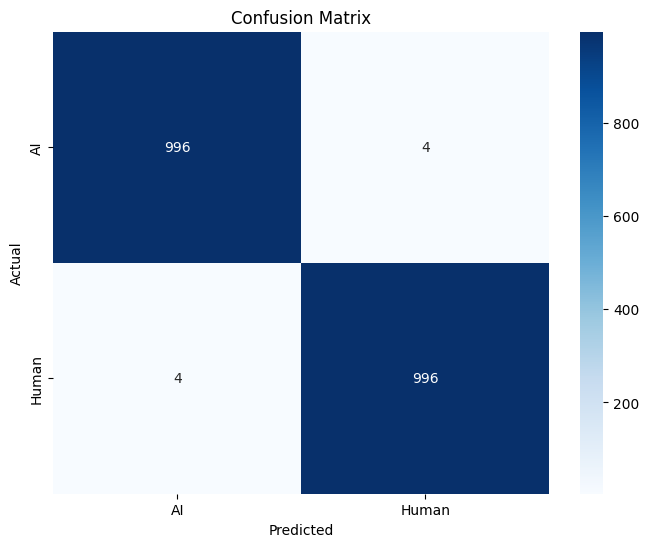

In [50]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model for the specified number of epochs
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))


from sklearn.metrics import classification_report, confusion_matrix, precision_recall_curve, roc_curve, roc_auc_score
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
predictions = model.predict(test_dataset)
predictions = np.argmax(predictions, axis = 1)

# Calculate confusion matrix and classification report
cm = confusion_matrix(test_dataset.classes, predictions)
report = classification_report(test_dataset.classes, predictions)

# Define custom labels for the axes
labels = ['AI', 'Human']
cm_df = pd.DataFrame(cm, index=labels, columns=labels)

# Plot confusion matrix using Seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(cm_df, annot=True, fmt='d', cmap='Blues')

# Add labels to the axes
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')

# Print classification report
print(report)

# Show the plot
plt.show()


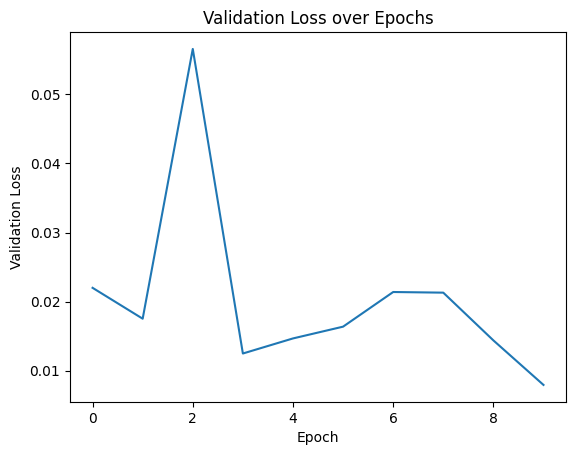

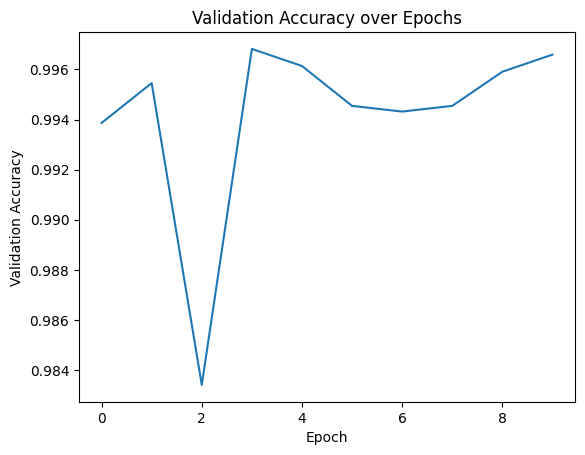

In [52]:
history.history.keys()
plt.plot(history.history['val_loss']);
plt.xlabel('Epoch')
plt.ylabel('Validation Loss')
plt.title('Validation Loss over Epochs')
plt.show()

plt.plot(history.history['val_accuracy']);
plt.xlabel('Epoch')
plt.ylabel('Validation Accuracy')
plt.title('Validation Accuracy over Epochs')
plt.show()

2000/2000 ━━━━━━━━━━━━━━━━━━━━ 67s 33ms/step


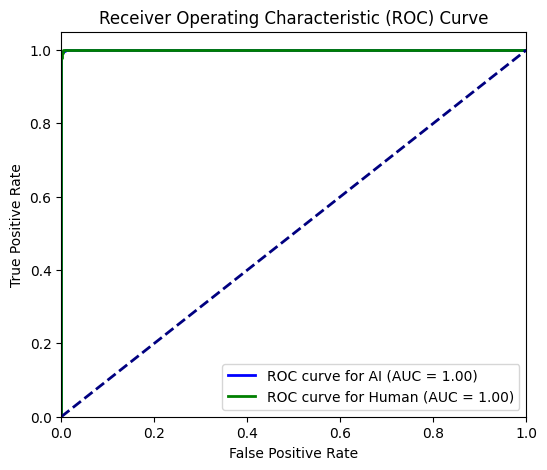

AUC for AI class: 1.0000
AUC for Human class: 1.0000
Skipping micro-average calculation (binary classification): Found input variables with inconsistent numbers of samples: [2000, 4000]


In [53]:
!pip install matplotlib scikit-learn
from sklearn.metrics import roc_curve, auc, RocCurveDisplay
import matplotlib.pyplot as plt
import numpy as np

# Get predicted probabilities for the test set
y_pred_probs = model.predict(test_dataset)

# Convert true labels to numpy array
y_true = np.array(test_dataset.classes)

# Calculate ROC curve and AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()

# For binary classification
fpr["AI"], tpr["AI"], _ = roc_curve(y_true, y_pred_probs[:, 0], pos_label=0)
roc_auc["AI"] = auc(fpr["AI"], tpr["AI"])

fpr["Human"], tpr["Human"], _ = roc_curve(y_true, y_pred_probs[:, 1], pos_label=1)
roc_auc["Human"] = auc(fpr["Human"], tpr["Human"])

# Plot ROC curves
plt.figure(figsize=(6, 5))

# Plot ROC for AI class
plt.plot(fpr["AI"], tpr["AI"], color='blue', lw=2,
         label='ROC curve for AI (AUC = %0.2f)' % roc_auc["AI"])

# Plot ROC for Human class
plt.plot(fpr["Human"], tpr["Human"], color='green', lw=2,
         label='ROC curve for Human (AUC = %0.2f)' % roc_auc["Human"])

# Plot diagonal line
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Set plot parameters
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")

# Show plot
plt.show()

# Print AUC values
print(f"AUC for AI class: {roc_auc['AI']:.4f}")
print(f"AUC for Human class: {roc_auc['Human']:.4f}")

# Calculate micro-average AUC (only needed for multi-class)
# Remove this section if you're doing binary classification
try:
    fpr["micro"], tpr["micro"], _ = roc_curve(y_true, y_pred_probs.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
    print(f"Micro-average AUC: {roc_auc['micro']:.4f}")
except Exception as e:
    print(f"Skipping micro-average calculation (binary classification): {str(e)}")

#XAI on Hybrid Model

GRAD-CAM

In [27]:
import tensorflow as tf
for i, layer in enumerate(model.layers):
    if isinstance(layer, tf.keras.layers.Conv2D):
        print(f"{i}: {layer.name}")

2: conv1_conv
9: conv2_block1_1_conv
12: conv2_block1_2_conv
16: conv2_block2_1_conv
19: conv2_block2_2_conv
23: conv2_block3_1_conv
26: conv2_block3_2_conv
30: conv2_block4_1_conv
33: conv2_block4_2_conv
37: conv2_block5_1_conv
40: conv2_block5_2_conv
44: conv2_block6_1_conv
47: conv2_block6_2_conv
51: pool2_conv
55: conv3_block1_1_conv
58: conv3_block1_2_conv
62: conv3_block2_1_conv
65: conv3_block2_2_conv
69: conv3_block3_1_conv
72: conv3_block3_2_conv
76: conv3_block4_1_conv
79: conv3_block4_2_conv
83: conv3_block5_1_conv
86: conv3_block5_2_conv
90: conv3_block6_1_conv
93: conv3_block6_2_conv
97: conv3_block7_1_conv
100: conv3_block7_2_conv
104: conv3_block8_1_conv
107: conv3_block8_2_conv
111: conv3_block9_1_conv
114: conv3_block9_2_conv
118: conv3_block10_1_conv
121: conv3_block10_2_conv
125: conv3_block11_1_conv
128: conv3_block11_2_conv
132: conv3_block12_1_conv
135: conv3_block12_2_conv
139: pool3_conv
143: conv4_block1_1_conv
146: conv4_block1_2_conv
150: conv4_block2_1_conv


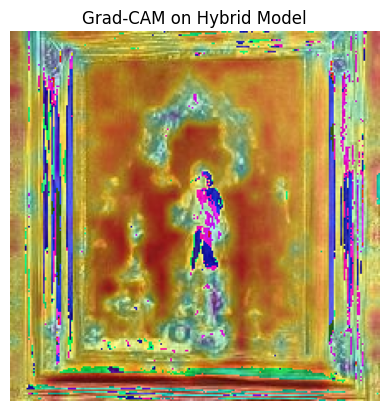

In [44]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

    from tensorflow.keras.preprocessing import image
import numpy as np

def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = tf.keras.applications.densenet.preprocess_input(np.expand_dims(img_array, axis=0))
    return img_array, img

img_path = "/content/B1.jpg"
img_array, original_img = preprocess_image(img_path)

# Replace 'conv2d_1' with your last shared Conv2D layer before concatenation
from tensorflow.keras.models import Model
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name='conv2d_1')

import cv2
import matplotlib.pyplot as plt

def superimpose_heatmap(heatmap, original_img, alpha=0.4):
    img = np.array(original_img)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed = heatmap_color * alpha + img
    return np.uint8(superimposed)

superimposed_img = superimpose_heatmap(heatmap, original_img)

plt.imshow(superimposed_img)
plt.title("Grad-CAM on Hybrid Model")
plt.axis('off')
plt.show()

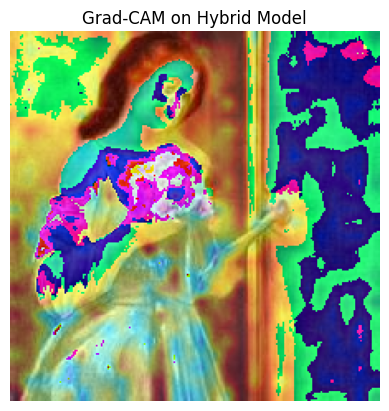

In [45]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

    from tensorflow.keras.preprocessing import image
import numpy as np

def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = tf.keras.applications.densenet.preprocess_input(np.expand_dims(img_array, axis=0))
    return img_array, img

img_path = "/content/R1.jpg"
img_array, original_img = preprocess_image(img_path)

# Replace 'conv2d_1' with your last shared Conv2D layer before concatenation
from tensorflow.keras.models import Model
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name='conv2d_1')

import cv2
import matplotlib.pyplot as plt

def superimpose_heatmap(heatmap, original_img, alpha=0.4):
    img = np.array(original_img)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed = heatmap_color * alpha + img
    return np.uint8(superimposed)

superimposed_img = superimpose_heatmap(heatmap, original_img)

plt.imshow(superimposed_img)
plt.title("Grad-CAM on Hybrid Model")
plt.axis('off')
plt.show()

/tmp/ipython-input-46-339846648.py:43: RuntimeWarning: invalid value encountered in cast
  heatmap = np.uint8(255 * heatmap)


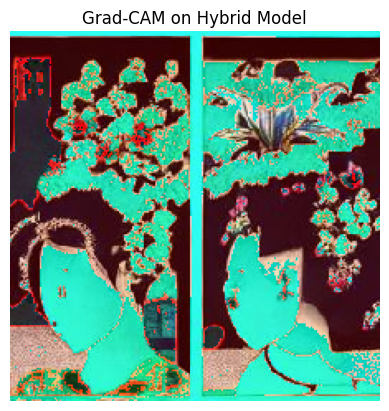

In [46]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

    from tensorflow.keras.preprocessing import image
import numpy as np

def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = tf.keras.applications.densenet.preprocess_input(np.expand_dims(img_array, axis=0))
    return img_array, img

img_path = "/content/U1.jpg"
img_array, original_img = preprocess_image(img_path)

# Replace 'conv2d_1' with your last shared Conv2D layer before concatenation
from tensorflow.keras.models import Model
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name='conv2d_1')

import cv2
import matplotlib.pyplot as plt

def superimpose_heatmap(heatmap, original_img, alpha=0.4):
    img = np.array(original_img)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed = heatmap_color * alpha + img
    return np.uint8(superimposed)

superimposed_img = superimpose_heatmap(heatmap, original_img)

plt.imshow(superimposed_img)
plt.title("Grad-CAM on Hybrid Model")
plt.axis('off')
plt.show()

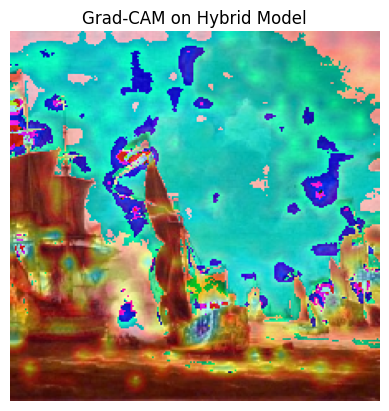

In [47]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

    from tensorflow.keras.preprocessing import image
import numpy as np

def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = tf.keras.applications.densenet.preprocess_input(np.expand_dims(img_array, axis=0))
    return img_array, img

img_path = "/content/abraham-storck_die-niederlandische-flotte-auf-der-reede-vor-amsterdam-0.jpg"
img_array, original_img = preprocess_image(img_path)

# Replace 'conv2d_1' with your last shared Conv2D layer before concatenation
from tensorflow.keras.models import Model
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name='conv2d_1')

import cv2
import matplotlib.pyplot as plt

def superimpose_heatmap(heatmap, original_img, alpha=0.4):
    img = np.array(original_img)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed = heatmap_color * alpha + img
    return np.uint8(superimposed)

superimposed_img = superimpose_heatmap(heatmap, original_img)

plt.imshow(superimposed_img)
plt.title("Grad-CAM on Hybrid Model")
plt.axis('off')
plt.show()

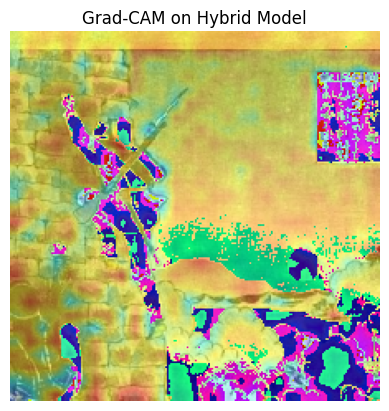

In [48]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

    from tensorflow.keras.preprocessing import image
import numpy as np

def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = tf.keras.applications.densenet.preprocess_input(np.expand_dims(img_array, axis=0))
    return img_array, img

img_path = "/content/adachi-ginko_90.jpg"
img_array, original_img = preprocess_image(img_path)

# Replace 'conv2d_1' with your last shared Conv2D layer before concatenation
from tensorflow.keras.models import Model
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name='conv2d_1')

import cv2
import matplotlib.pyplot as plt

def superimpose_heatmap(heatmap, original_img, alpha=0.4):
    img = np.array(original_img)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed = heatmap_color * alpha + img
    return np.uint8(superimposed)

superimposed_img = superimpose_heatmap(heatmap, original_img)

plt.imshow(superimposed_img)
plt.title("Grad-CAM on Hybrid Model")
plt.axis('off')
plt.show()

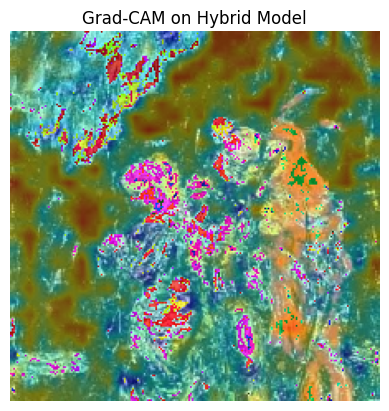

In [49]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

    from tensorflow.keras.preprocessing import image
import numpy as np

def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = tf.keras.applications.densenet.preprocess_input(np.expand_dims(img_array, axis=0))
    return img_array, img

img_path = "/content/adolphe-joseph-thomas-monticelli_margaree-faust-and-mephisto.jpg"
img_array, original_img = preprocess_image(img_path)

# Replace 'conv2d_1' with your last shared Conv2D layer before concatenation
from tensorflow.keras.models import Model
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name='conv2d_1')

import cv2
import matplotlib.pyplot as plt

def superimpose_heatmap(heatmap, original_img, alpha=0.4):
    img = np.array(original_img)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed = heatmap_color * alpha + img
    return np.uint8(superimposed)

superimposed_img = superimpose_heatmap(heatmap, original_img)

plt.imshow(superimposed_img)
plt.title("Grad-CAM on Hybrid Model")
plt.axis('off')
plt.show()

LIME

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 21.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=24703b2690fc677481292f1eed86c01f83e85c123ca778e902d632cd9a7949e0
  Stored in directory: /root/.cache/pip/wheels/85/fa/a3/9c2d44c9f3cd77cf4e533b58900b2bf4487f2a17e8ec212a3d
Successfully built lime


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 31s 31s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0

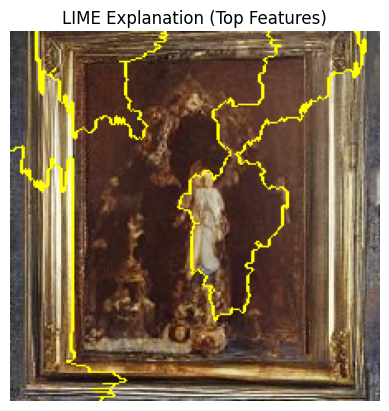

In [51]:
!pip install lime
from lime import lime_image
from skimage.segmentation import mark_boundaries
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
def predict_fn(images):
    images = tf.keras.applications.densenet.preprocess_input(images)
    return model.predict(images)
from tensorflow.keras.preprocessing import image
from skimage.segmentation import mark_boundaries
import numpy as np
import matplotlib.pyplot as plt

img_path = "/content/B1.jpg"
img = image.load_img(img_path, target_size=(224, 224))
img_np = image.img_to_array(img).astype(np.uint8)
explainer = lime_image.LimeImageExplainer()

explanation = explainer.explain_instance(
    img_np,
    predict_fn,
    top_labels=1,
    hide_color=0,
    num_samples=1000
)
from skimage.segmentation import mark_boundaries

# Get explanation for the top class
temp, mask = explanation.get_image_and_mask(
    explanation.top_labels[0],
    positive_only=True,
    num_features=5,
    hide_rest=False
)

plt.imshow(mark_boundaries(temp / 255.0, mask))
plt.title("LIME Explanation (Top Features)")
plt.axis('off')
plt.show()


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

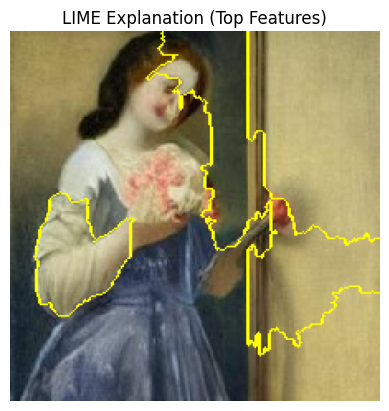

In [54]:
!pip install lime
from lime import lime_image
from skimage.segmentation import mark_boundaries
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
def predict_fn(images):
    images = tf.keras.applications.densenet.preprocess_input(images)
    return model.predict(images)
from tensorflow.keras.preprocessing import image
from skimage.segmentation import mark_boundaries
import numpy as np
import matplotlib.pyplot as plt

img_path = "/content/R1.jpg"
img = image.load_img(img_path, target_size=(224, 224))
img_np = image.img_to_array(img).astype(np.uint8)
explainer = lime_image.LimeImageExplainer()

explanation = explainer.explain_instance(
    img_np,
    predict_fn,
    top_labels=1,
    hide_color=0,
    num_samples=1000
)
from skimage.segmentation import mark_boundaries

# Get explanation for the top class
temp, mask = explanation.get_image_and_mask(
    explanation.top_labels[0],
    positive_only=True,
    num_features=5,
    hide_rest=False
)

plt.imshow(mark_boundaries(temp / 255.0, mask))
plt.title("LIME Explanation (Top Features)")
plt.axis('off')
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

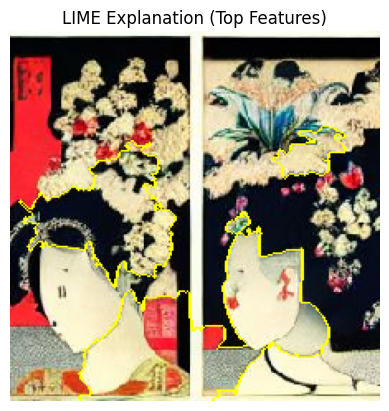

In [55]:
!pip install lime
from lime import lime_image
from skimage.segmentation import mark_boundaries
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
def predict_fn(images):
    images = tf.keras.applications.densenet.preprocess_input(images)
    return model.predict(images)
from tensorflow.keras.preprocessing import image
from skimage.segmentation import mark_boundaries
import numpy as np
import matplotlib.pyplot as plt

img_path = "/content/U1.jpg"
img = image.load_img(img_path, target_size=(224, 224))
img_np = image.img_to_array(img).astype(np.uint8)
explainer = lime_image.LimeImageExplainer()

explanation = explainer.explain_instance(
    img_np,
    predict_fn,
    top_labels=1,
    hide_color=0,
    num_samples=1000
)
from skimage.segmentation import mark_boundaries

# Get explanation for the top class
temp, mask = explanation.get_image_and_mask(
    explanation.top_labels[0],
    positive_only=True,
    num_features=5,
    hide_rest=False
)

plt.imshow(mark_boundaries(temp / 255.0, mask))
plt.title("LIME Explanation (Top Features)")
plt.axis('off')
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

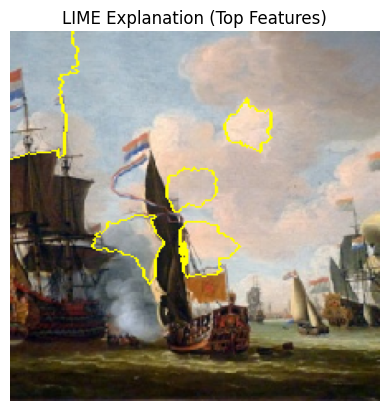

In [56]:
!pip install lime
from lime import lime_image
from skimage.segmentation import mark_boundaries
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
def predict_fn(images):
    images = tf.keras.applications.densenet.preprocess_input(images)
    return model.predict(images)
from tensorflow.keras.preprocessing import image
from skimage.segmentation import mark_boundaries
import numpy as np
import matplotlib.pyplot as plt

img_path = "/content/abraham-storck_die-niederlandische-flotte-auf-der-reede-vor-amsterdam-0.jpg"
img = image.load_img(img_path, target_size=(224, 224))
img_np = image.img_to_array(img).astype(np.uint8)
explainer = lime_image.LimeImageExplainer()

explanation = explainer.explain_instance(
    img_np,
    predict_fn,
    top_labels=1,
    hide_color=0,
    num_samples=1000
)
from skimage.segmentation import mark_boundaries

# Get explanation for the top class
temp, mask = explanation.get_image_and_mask(
    explanation.top_labels[0],
    positive_only=True,
    num_features=5,
    hide_rest=False
)

plt.imshow(mark_boundaries(temp / 255.0, mask))
plt.title("LIME Explanation (Top Features)")
plt.axis('off')
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

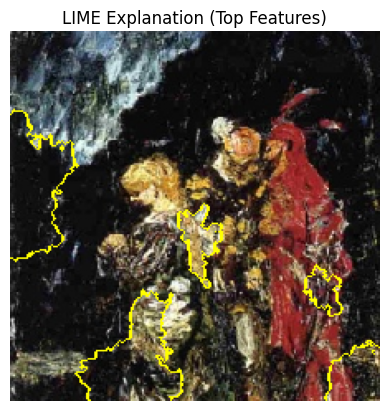

In [57]:
!pip install lime
from lime import lime_image
from skimage.segmentation import mark_boundaries
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
def predict_fn(images):
    images = tf.keras.applications.densenet.preprocess_input(images)
    return model.predict(images)
from tensorflow.keras.preprocessing import image
from skimage.segmentation import mark_boundaries
import numpy as np
import matplotlib.pyplot as plt

img_path = "/content/adolphe-joseph-thomas-monticelli_margaree-faust-and-mephisto.jpg"
img = image.load_img(img_path, target_size=(224, 224))
img_np = image.img_to_array(img).astype(np.uint8)
explainer = lime_image.LimeImageExplainer()

explanation = explainer.explain_instance(
    img_np,
    predict_fn,
    top_labels=1,
    hide_color=0,
    num_samples=1000
)
from skimage.segmentation import mark_boundaries

# Get explanation for the top class
temp, mask = explanation.get_image_and_mask(
    explanation.top_labels[0],
    positive_only=True,
    num_features=5,
    hide_rest=False
)

plt.imshow(mark_boundaries(temp / 255.0, mask))
plt.title("LIME Explanation (Top Features)")
plt.axis('off')
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

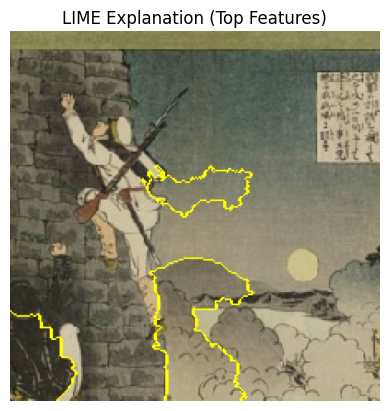

In [58]:
!pip install lime
from lime import lime_image
from skimage.segmentation import mark_boundaries
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
def predict_fn(images):
    images = tf.keras.applications.densenet.preprocess_input(images)
    return model.predict(images)
from tensorflow.keras.preprocessing import image
from skimage.segmentation import mark_boundaries
import numpy as np
import matplotlib.pyplot as plt

img_path = "/content/adachi-ginko_90.jpg"
img = image.load_img(img_path, target_size=(224, 224))
img_np = image.img_to_array(img).astype(np.uint8)
explainer = lime_image.LimeImageExplainer()

explanation = explainer.explain_instance(
    img_np,
    predict_fn,
    top_labels=1,
    hide_color=0,
    num_samples=1000
)
from skimage.segmentation import mark_boundaries

# Get explanation for the top class
temp, mask = explanation.get_image_and_mask(
    explanation.top_labels[0],
    positive_only=True,
    num_features=5,
    hide_rest=False
)

plt.imshow(mark_boundaries(temp / 255.0, mask))
plt.title("LIME Explanation (Top Features)")
plt.axis('off')
plt.show()

#Changes after Hyperparameter Tuning

with experiment 1

In [ ]:
from tensorflow.keras.applications import DenseNet201, Xception
from tensorflow.keras import models
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Dense, Dropout, Input,
                                     GlobalAveragePooling2D, GlobalMaxPooling2D, Multiply, concatenate,
                                     Concatenate, Reshape)
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint

# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])

# Input layer
input_layer = Input(shape=(224, 224, 3))

# Xception branch
xception = Xception(weights='imagenet', include_top=False, input_tensor=input_layer)
xception.trainable = True
for layer in xception.layers[:100]:
    layer.trainable = False
x = xception.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)

# DenseNet201 branch
densenet = DenseNet201(weights='imagenet', include_top=False, input_tensor=input_layer)
densenet.trainable = True
for layer in densenet.layers[:100]:
    layer.trainable = False
y = densenet.output
y = Conv2D(32, (3, 3), padding='same')(y)
y = BatchNormalization()(y)
y = squeeze_excite_block(y)
y = spatial_attention_block(y)
y = GlobalAveragePooling2D()(y)

# Concatenate features from both models
combined = concatenate([x, y])

# Final classifier layers
z = Dense(128, activation='relu')(combined)
z = Dropout(0.3)(z)  # Added dropout for regularization
output = Dense(2, activation='softmax')(z)

# Create the model
model = models.Model(inputs=input_layer, outputs=output)

# Compile the model with Adam optimizer and low learning rate
optimizer = Adam(learning_rate=0.0001)
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

# Define checkpoint callback
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Train the model
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

# Evaluate on test dataset
loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

83683744/83683744 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step
74836368/74836368 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 520ms/step - accuracy: 0.9377 - loss: 0.2395
Epoch 1: val_accuracy improved from -inf to 0.99523, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 788s 673ms/step - accuracy: 0.9377 - loss: 0.2393 - val_accuracy: 0.9952 - val_loss: 0.0314
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 522ms/step - accuracy: 0.9955 - loss: 0.0292
Epoch 2: val_accuracy did not improve from 0.99523
550/550 ━━━━━━━━━━━━━━━━━━━━ 319s 579ms/step - accuracy: 0.9955 - loss: 0.0291 - val_accuracy: 0.9902 - val_loss: 0.0379
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 520ms/step - accuracy: 0.9982 - loss: 0.0156
Epoch 3: val_accuracy did not improve from 0.99523
550/550 ━━━━━━━━━━━━━━━━━━━━ 318s 578ms/step - accuracy: 0.9982 - loss: 0.0156 - val_accuracy: 0.9948 - val_loss: 0.0218
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 520ms/step - accuracy: 0.9978 - loss: 0.0135
Epoch 4: val_accuracy improved from 0.99523 to 0.99568, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 325s 592ms/step - accuracy: 0.9978 - loss: 0.0135 - val_accuracy: 0.9957 - val_loss: 0.0205
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 521ms/step - accuracy: 0.9991 - loss: 0.0073
Epoch 5: val_accuracy did not improve from 0.99568
550/550 ━━━━━━━━━━━━━━━━━━━━ 318s 578ms/step - accuracy: 0.9991 - loss: 0.0073 - val_accuracy: 0.9923 - val_loss: 0.0311
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 521ms/step - accuracy: 0.9978 - loss: 0.0077
Epoch 6: val_accuracy improved from 0.99568 to 0.99636, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 326s 593ms/step - accuracy: 0.9978 - loss: 0.0077 - val_accuracy: 0.9964 - val_loss: 0.0129
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 521ms/step - accuracy: 0.9993 - loss: 0.0040
Epoch 7: val_accuracy did not improve from 0.99636
550/550 ━━━━━━━━━━━━━━━━━━━━ 318s 579ms/step - accuracy: 0.9993 - loss: 0.0040 - val_accuracy: 0.9955 - val_loss: 0.0153
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 521ms/step - accuracy: 0.9989 - loss: 0.0047
Epoch 8: val_accuracy did not improve from 0.99636
550/550 ━━━━━━━━━━━━━━━━━━━━ 318s 579ms/step - accuracy: 0.9989 - loss: 0.0047 - val_accuracy: 0.9893 - val_loss: 0.0340
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 531ms/step - accuracy: 0.9989 - loss: 0.0044
Epoch 9: val_accuracy did not improve from 0.99636
550/550 ━━━━━━━━━━━━━━━━━━━━ 324s 589ms/step - accuracy: 0.9989 - loss: 0.0044 - val_accuracy: 0.9852 - val_loss: 0.0577
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 520ms/step - accuracy: 0.9994 - loss: 0.0026
Epoch 10: 

with experiment 2

In [ ]:
from tensorflow.keras.applications import DenseNet201, Xception
from tensorflow.keras import models
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Dense, Dropout, Input,
                                     GlobalAveragePooling2D, GlobalMaxPooling2D, Multiply, concatenate,
                                     Concatenate, Reshape)
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.callbacks import ModelCheckpoint

# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])

# Input layer
input_layer = Input(shape=(224, 224, 3))

# Xception branch
xception = Xception(weights='imagenet', include_top=False, input_tensor=input_layer)
xception.trainable = True
for layer in xception.layers[:50]:  # Freeze only first 50 layers
    layer.trainable = False
x = xception.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)

# DenseNet201 branch
densenet = DenseNet201(weights='imagenet', include_top=False, input_tensor=input_layer)
densenet.trainable = True
for layer in densenet.layers[:50]:  # Freeze only first 50 layers
    layer.trainable = False
y = densenet.output
y = Conv2D(32, (3, 3), padding='same')(y)
y = BatchNormalization()(y)
y = squeeze_excite_block(y)
y = spatial_attention_block(y)
y = GlobalAveragePooling2D()(y)

# Combine both branches
combined = concatenate([x, y])

# Final classifier
z = Dense(128, activation='relu')(combined)
z = Dropout(0.3)(z)
output = Dense(2, activation='softmax')(z)

# Create the model
model = models.Model(inputs=input_layer, outputs=output)

# Optimizer: SGD with momentum
optimizer = SGD(learning_rate=0.01, momentum=0.9)
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

# Checkpoint callback
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Fit the model
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

# Evaluate on test set
loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 612ms/step - accuracy: 0.9209 - loss: 0.2151
Epoch 1: val_accuracy improved from -inf to 0.99000, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 841s 837ms/step - accuracy: 0.9210 - loss: 0.2149 - val_accuracy: 0.9900 - val_loss: 0.0408
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 617ms/step - accuracy: 0.9952 - loss: 0.0263
Epoch 2: val_accuracy did not improve from 0.99000
550/550 ━━━━━━━━━━━━━━━━━━━━ 371s 675ms/step - accuracy: 0.9952 - loss: 0.0263 - val_accuracy: 0.9823 - val_loss: 0.0634
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 619ms/step - accuracy: 0.9968 - loss: 0.0184
Epoch 3: val_accuracy improved from 0.99000 to 0.99568, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 385s 700ms/step - accuracy: 0.9968 - loss: 0.0184 - val_accuracy: 0.9957 - val_loss: 0.0192
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 620ms/step - accuracy: 0.9988 - loss: 0.0122
Epoch 4: val_accuracy did not improve from 0.99568
550/550 ━━━━━━━━━━━━━━━━━━━━ 373s 678ms/step - accuracy: 0.9988 - loss: 0.0122 - val_accuracy: 0.9784 - val_loss: 0.0769
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 619ms/step - accuracy: 0.9982 - loss: 0.0121
Epoch 5: val_accuracy did not improve from 0.99568
550/550 ━━━━━━━━━━━━━━━━━━━━ 373s 677ms/step - accuracy: 0.9982 - loss: 0.0121 - val_accuracy: 0.9932 - val_loss: 0.0248
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 618ms/step - accuracy: 0.9983 - loss: 0.0095
Epoch 6: val_accuracy did not improve from 0.99568
550/550 ━━━━━━━━━━━━━━━━━━━━ 372s 676ms/step - accuracy: 0.9983 - loss: 0.0095 - val_accuracy: 0.9941 - val_loss: 0.0217
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 619ms/step - accuracy: 0.9993 - loss: 0.0056
Epoch 7: va

550/550 ━━━━━━━━━━━━━━━━━━━━ 390s 710ms/step - accuracy: 0.9993 - loss: 0.0056 - val_accuracy: 0.9961 - val_loss: 0.0158
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 619ms/step - accuracy: 0.9998 - loss: 0.0037
Epoch 8: val_accuracy did not improve from 0.99614
550/550 ━━━━━━━━━━━━━━━━━━━━ 373s 677ms/step - accuracy: 0.9998 - loss: 0.0037 - val_accuracy: 0.9945 - val_loss: 0.0214
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 619ms/step - accuracy: 0.9997 - loss: 0.0034
Epoch 9: val_accuracy did not improve from 0.99614
550/550 ━━━━━━━━━━━━━━━━━━━━ 373s 677ms/step - accuracy: 0.9997 - loss: 0.0034 - val_accuracy: 0.9952 - val_loss: 0.0192
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 621ms/step - accuracy: 0.9998 - loss: 0.0029
Epoch 10: val_accuracy did not improve from 0.99614
550/550 ━━━━━━━━━━━━━━━━━━━━ 374s 679ms/step - accuracy: 0.9998 - loss: 0.0029 - val_accuracy: 0.9932 - val_loss: 0.0209
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 68s 27ms/step - accuracy: 0.9972 - loss: 0.0107
Test Accuracy: 99.

with experiment3

In [ ]:
from tensorflow.keras.applications import DenseNet201, Xception
from tensorflow.keras import models
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Dense, Dropout, Input,
                                     GlobalAveragePooling2D, GlobalMaxPooling2D, Multiply, concatenate,
                                     Concatenate, Reshape)
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.callbacks import ModelCheckpoint

# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])

# Input layer
input_layer = Input(shape=(224, 224, 3))

# Xception branch
xception = Xception(weights='imagenet', include_top=False, input_tensor=input_layer)
xception.trainable = True
for layer in xception.layers[:50]:  # Freezing first 50 layers
    layer.trainable = False
x = xception.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)

# DenseNet201 branch
densenet = DenseNet201(weights='imagenet', include_top=False, input_tensor=input_layer)
densenet.trainable = True
for layer in densenet.layers[:50]:
    layer.trainable = False
y = densenet.output
y = Conv2D(32, (3, 3), padding='same')(y)
y = BatchNormalization()(y)
y = squeeze_excite_block(y)
y = spatial_attention_block(y)
y = GlobalAveragePooling2D()(y)

# Combine both branches
combined = concatenate([x, y])

# ✨ Additional Dense Layers for classifier
z = Dense(128, activation='relu')(combined)
z = Dropout(0.3)(z)
z = Dense(64, activation='relu')(z)  # Additional dense layer
output = Dense(2, activation='softmax')(z)

# Create the model
model = models.Model(inputs=input_layer, outputs=output)

# Optimizer: RMSprop
optimizer = RMSprop(learning_rate=0.0005)
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

# Checkpoint callback
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Train the model
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

# Evaluate the model
loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 653ms/step - accuracy: 0.9482 - loss: 0.1628
Epoch 1: val_accuracy improved from -inf to 0.97273, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 844s 817ms/step - accuracy: 0.9483 - loss: 0.1627 - val_accuracy: 0.9727 - val_loss: 0.1386
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 665ms/step - accuracy: 0.9933 - loss: 0.0245
Epoch 2: val_accuracy improved from 0.97273 to 0.98977, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 404s 734ms/step - accuracy: 0.9933 - loss: 0.0245 - val_accuracy: 0.9898 - val_loss: 0.0338
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 665ms/step - accuracy: 0.9970 - loss: 0.0115
Epoch 3: val_accuracy improved from 0.98977 to 0.99159, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 406s 737ms/step - accuracy: 0.9970 - loss: 0.0115 - val_accuracy: 0.9916 - val_loss: 0.0357
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 665ms/step - accuracy: 0.9964 - loss: 0.0126
Epoch 4: val_accuracy improved from 0.99159 to 0.99432, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 405s 737ms/step - accuracy: 0.9964 - loss: 0.0126 - val_accuracy: 0.9943 - val_loss: 0.0257
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 665ms/step - accuracy: 0.9978 - loss: 0.0068
Epoch 5: val_accuracy improved from 0.99432 to 0.99705, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 443s 739ms/step - accuracy: 0.9978 - loss: 0.0068 - val_accuracy: 0.9970 - val_loss: 0.0162
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 664ms/step - accuracy: 0.9985 - loss: 0.0051
Epoch 6: val_accuracy did not improve from 0.99705
550/550 ━━━━━━━━━━━━━━━━━━━━ 399s 725ms/step - accuracy: 0.9985 - loss: 0.0051 - val_accuracy: 0.9955 - val_loss: 0.0163
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 664ms/step - accuracy: 0.9993 - loss: 0.0018
Epoch 7: val_accuracy did not improve from 0.99705
550/550 ━━━━━━━━━━━━━━━━━━━━ 399s 726ms/step - accuracy: 0.9993 - loss: 0.0018 - val_accuracy: 0.9964 - val_loss: 0.0314
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 663ms/step - accuracy: 0.9994 - loss: 0.0027
Epoch 8: val_accuracy did not improve from 0.99705
550/550 ━━━━━━━━━━━━━━━━━━━━ 399s 725ms/step - accuracy: 0.9994 - loss: 0.0027 - val_accuracy: 0.9900 - val_loss: 0.0375
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 664ms/step - accuracy: 0.9985 - loss: 0.0062
Epoch 9: va

#Explainable AI

GRAD-CAM

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving B1.jpg to B1.jpg


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


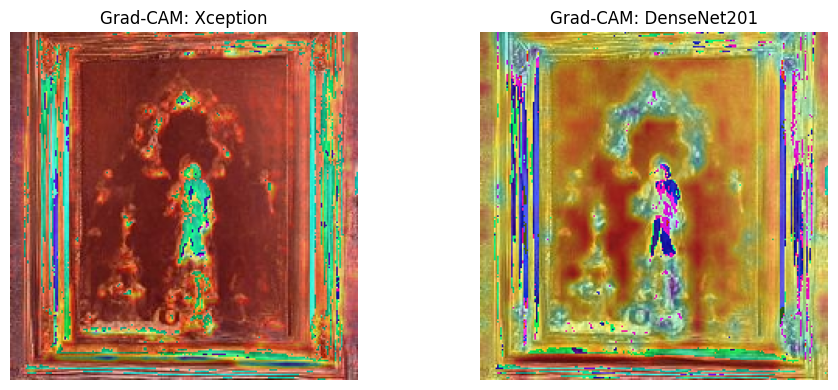

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing import image
import cv2

#Load and Preprocess the Image
img_path = "B1.jpg"
def get_img_array(img_path, size=(224, 224)):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    array = tf.keras.applications.densenet.preprocess_input(array)
    return array, img

img_array, original_img = get_img_array(img_path)

#Grad-CAM Function
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()
#Apply Grad-CAM on Xception Branch
# Name of last conv layer in Xception branch
last_conv_xception = 'conv2d'  # Assuming it's named exactly like that after xception.output

heatmap_x = make_gradcam_heatmap(img_array, model, last_conv_xception)
#Apply Grad-CAM on DenseNet201 Branch
last_conv_densenet = 'conv2d_1'  # Adjust name if needed

heatmap_y = make_gradcam_heatmap(img_array, model, last_conv_densenet)

#Superimpose Heatmap on Image
def superimpose_heatmap(heatmap, original_image, alpha=0.4, colormap=cv2.COLORMAP_JET):
    img = np.array(original_image)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap_color = cv2.applyColorMap(heatmap, colormap)
    superimposed_img = heatmap_color * alpha + img
    return np.uint8(superimposed_img)

plt.figure(figsize=(10, 4))

plt.subplot(1, 2, 1)
plt.title("Grad-CAM: Xception")
plt.imshow(superimpose_heatmap(heatmap_x, original_img))
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title("Grad-CAM: DenseNet201")
plt.imshow(superimpose_heatmap(heatmap_y, original_img))
plt.axis('off')

plt.tight_layout()
plt.show()

LIME

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 9.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=630af7026fc327460d97b7ea60598221f0e84a004f7f204c40a1b059c782cd50
  Stored in directory: /root/.cache/pip/wheels/85/fa/a3/9c2d44c9f3cd77cf4e533b58900b2bf4487f2a17e8ec212a3d
Successfully built lime


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 31s 31s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0

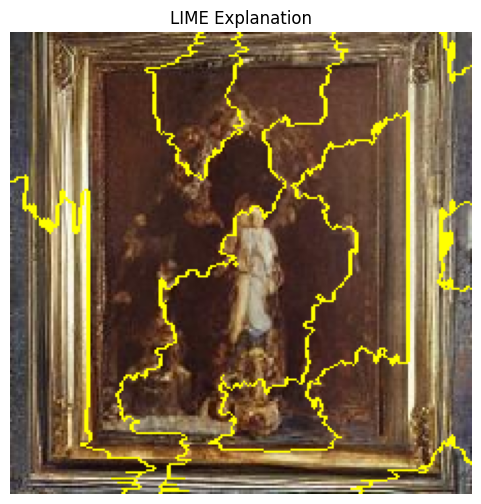

In [ ]:
!pip install lime

from lime import lime_image
from skimage.segmentation import mark_boundaries
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
img_path = 'B1.jpg'

def preprocess_lime(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_np = image.img_to_array(img).astype('double')
    return img_np

image_np = preprocess_lime(img_path)

#Define a LIME-Compatible Prediction Function
def predict_fn(images):
    # Apply the same preprocessing as used for DenseNet/Xception
    images = tf.keras.applications.densenet.preprocess_input(images.copy())
    return model.predict(images)

#Create LIME Image Explainer
explainer = lime_image.LimeImageExplainer()
#Explain a Prediction
explanation = explainer.explain_instance(
    image_np.astype('uint8'),
    predict_fn,
    top_labels=2,
    hide_color=0,
    num_samples=1000  # you can increase for more accurate explanations
)
#Visualize the Explanation
from skimage.color import label2rgb

# Choose label index (e.g., 0 = Human, 1 = AI — adjust based on your dataset)
label_index = explanation.top_labels[0]  # or manually use 0 or 1

temp, mask = explanation.get_image_and_mask(
    label_index,
    positive_only=True,
    num_features=10,
    hide_rest=False
)

plt.figure(figsize=(6, 6))
plt.title('LIME Explanation')
plt.imshow(mark_boundaries(temp / 255.0, mask))
plt.axis('off')
plt.show()

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving R1.jpg to R1.jpg


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


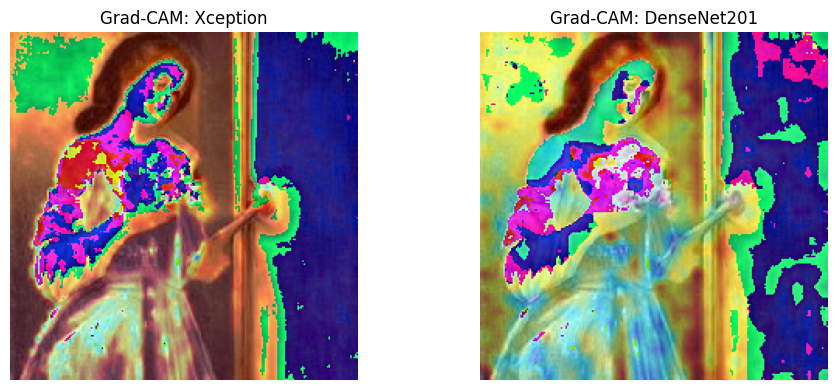

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing import image
import cv2

#Load and Preprocess the Image
img_path = "R1.jpg"
def get_img_array(img_path, size=(224, 224)):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    array = tf.keras.applications.densenet.preprocess_input(array)
    return array, img

img_array, original_img = get_img_array(img_path)

#Grad-CAM Function
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()
#Apply Grad-CAM on Xception Branch
# Name of last conv layer in Xception branch
last_conv_xception = 'conv2d'  # Assuming it's named exactly like that after xception.output

heatmap_x = make_gradcam_heatmap(img_array, model, last_conv_xception)
#Apply Grad-CAM on DenseNet201 Branch
last_conv_densenet = 'conv2d_1'  # Adjust name if needed

heatmap_y = make_gradcam_heatmap(img_array, model, last_conv_densenet)

#Superimpose Heatmap on Image
def superimpose_heatmap(heatmap, original_image, alpha=0.4, colormap=cv2.COLORMAP_JET):
    img = np.array(original_image)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap_color = cv2.applyColorMap(heatmap, colormap)
    superimposed_img = heatmap_color * alpha + img
    return np.uint8(superimposed_img)

plt.figure(figsize=(10, 4))

plt.subplot(1, 2, 1)
plt.title("Grad-CAM: Xception")
plt.imshow(superimpose_heatmap(heatmap_x, original_img))
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title("Grad-CAM: DenseNet201")
plt.imshow(superimpose_heatmap(heatmap_y, original_img))
plt.axis('off')

plt.tight_layout()
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

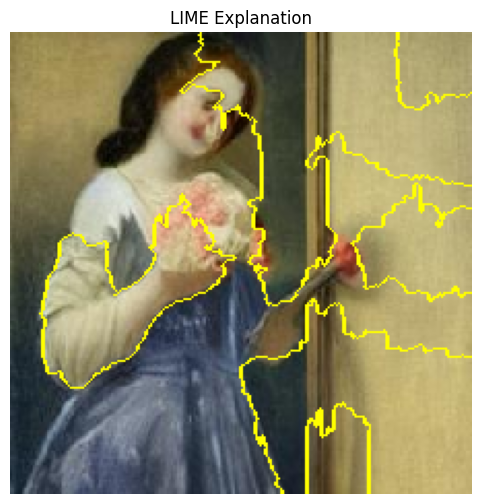

In [ ]:
!pip install lime

from lime import lime_image
from skimage.segmentation import mark_boundaries
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
img_path = 'R1.jpg'

def preprocess_lime(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_np = image.img_to_array(img).astype('double')
    return img_np

image_np = preprocess_lime(img_path)

#Define a LIME-Compatible Prediction Function
def predict_fn(images):
    # Apply the same preprocessing as used for DenseNet/Xception
    images = tf.keras.applications.densenet.preprocess_input(images.copy())
    return model.predict(images)

#Create LIME Image Explainer
explainer = lime_image.LimeImageExplainer()
#Explain a Prediction
explanation = explainer.explain_instance(
    image_np.astype('uint8'),
    predict_fn,
    top_labels=2,
    hide_color=0,
    num_samples=1000  # you can increase for more accurate explanations
)
#Visualize the Explanation
from skimage.color import label2rgb

# Choose label index (e.g., 0 = Human, 1 = AI — adjust based on your dataset)
label_index = explanation.top_labels[0]  # or manually use 0 or 1

temp, mask = explanation.get_image_and_mask(
    label_index,
    positive_only=True,
    num_features=10,
    hide_rest=False
)

plt.figure(figsize=(6, 6))
plt.title('LIME Explanation')
plt.imshow(mark_boundaries(temp / 255.0, mask))
plt.axis('off')
plt.show()

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving U1.jpg to U1.jpg


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


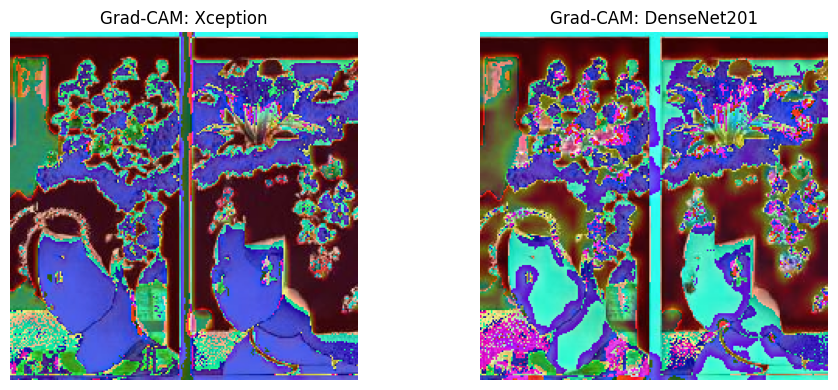

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing import image
import cv2

#Load and Preprocess the Image
img_path = "U1.jpg"
def get_img_array(img_path, size=(224, 224)):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    array = tf.keras.applications.densenet.preprocess_input(array)
    return array, img

img_array, original_img = get_img_array(img_path)

#Grad-CAM Function
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()
#Apply Grad-CAM on Xception Branch
# Name of last conv layer in Xception branch
last_conv_xception = 'conv2d'  # Assuming it's named exactly like that after xception.output

heatmap_x = make_gradcam_heatmap(img_array, model, last_conv_xception)
#Apply Grad-CAM on DenseNet201 Branch
last_conv_densenet = 'conv2d_1'  # Adjust name if needed

heatmap_y = make_gradcam_heatmap(img_array, model, last_conv_densenet)

#Superimpose Heatmap on Image
def superimpose_heatmap(heatmap, original_image, alpha=0.4, colormap=cv2.COLORMAP_JET):
    img = np.array(original_image)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap_color = cv2.applyColorMap(heatmap, colormap)
    superimposed_img = heatmap_color * alpha + img
    return np.uint8(superimposed_img)

plt.figure(figsize=(10, 4))

plt.subplot(1, 2, 1)
plt.title("Grad-CAM: Xception")
plt.imshow(superimpose_heatmap(heatmap_x, original_img))
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title("Grad-CAM: DenseNet201")
plt.imshow(superimpose_heatmap(heatmap_y, original_img))
plt.axis('off')

plt.tight_layout()
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

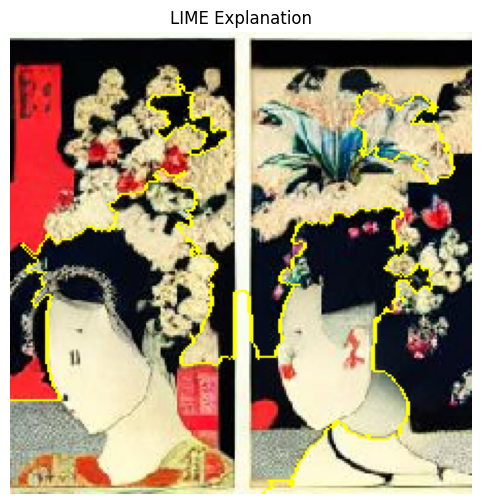

In [ ]:
!pip install lime

from lime import lime_image
from skimage.segmentation import mark_boundaries
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
img_path = 'U1.jpg'

def preprocess_lime(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_np = image.img_to_array(img).astype('double')
    return img_np

image_np = preprocess_lime(img_path)

#Define a LIME-Compatible Prediction Function
def predict_fn(images):
    # Apply the same preprocessing as used for DenseNet/Xception
    images = tf.keras.applications.densenet.preprocess_input(images.copy())
    return model.predict(images)

#Create LIME Image Explainer
explainer = lime_image.LimeImageExplainer()
#Explain a Prediction
explanation = explainer.explain_instance(
    image_np.astype('uint8'),
    predict_fn,
    top_labels=2,
    hide_color=0,
    num_samples=1000  # you can increase for more accurate explanations
)
#Visualize the Explanation
from skimage.color import label2rgb

# Choose label index (e.g., 0 = Human, 1 = AI — adjust based on your dataset)
label_index = explanation.top_labels[0]  # or manually use 0 or 1

temp, mask = explanation.get_image_and_mask(
    label_index,
    positive_only=True,
    num_features=10,
    hide_rest=False
)

plt.figure(figsize=(6, 6))
plt.title('LIME Explanation')
plt.imshow(mark_boundaries(temp / 255.0, mask))
plt.axis('off')
plt.show()

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving abraham-storck_die-niederlandische-flotte-auf-der-reede-vor-amsterdam-0.jpg to abraham-storck_die-niederlandische-flotte-auf-der-reede-vor-amsterdam-0.jpg


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


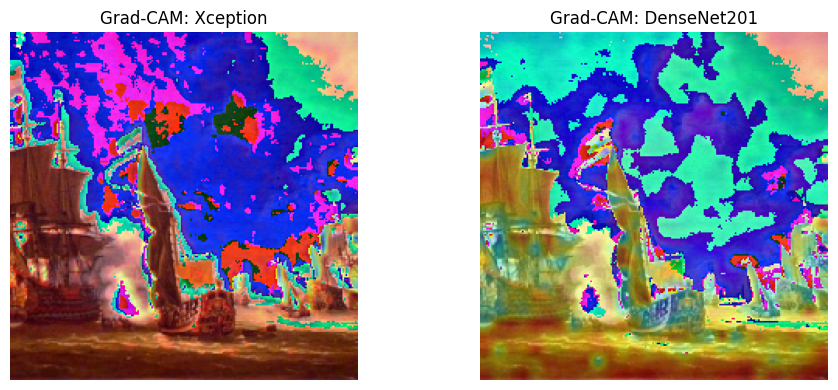

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing import image
import cv2

#Load and Preprocess the Image
img_path = "abraham-storck_die-niederlandische-flotte-auf-der-reede-vor-amsterdam-0.jpg"
def get_img_array(img_path, size=(224, 224)):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    array = tf.keras.applications.densenet.preprocess_input(array)
    return array, img

img_array, original_img = get_img_array(img_path)

#Grad-CAM Function
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()
#Apply Grad-CAM on Xception Branch
# Name of last conv layer in Xception branch
last_conv_xception = 'conv2d'  # Assuming it's named exactly like that after xception.output

heatmap_x = make_gradcam_heatmap(img_array, model, last_conv_xception)
#Apply Grad-CAM on DenseNet201 Branch
last_conv_densenet = 'conv2d_1'  # Adjust name if needed

heatmap_y = make_gradcam_heatmap(img_array, model, last_conv_densenet)

#Superimpose Heatmap on Image
def superimpose_heatmap(heatmap, original_image, alpha=0.4, colormap=cv2.COLORMAP_JET):
    img = np.array(original_image)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap_color = cv2.applyColorMap(heatmap, colormap)
    superimposed_img = heatmap_color * alpha + img
    return np.uint8(superimposed_img)

plt.figure(figsize=(10, 4))

plt.subplot(1, 2, 1)
plt.title("Grad-CAM: Xception")
plt.imshow(superimpose_heatmap(heatmap_x, original_img))
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title("Grad-CAM: DenseNet201")
plt.imshow(superimpose_heatmap(heatmap_y, original_img))
plt.axis('off')

plt.tight_layout()
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

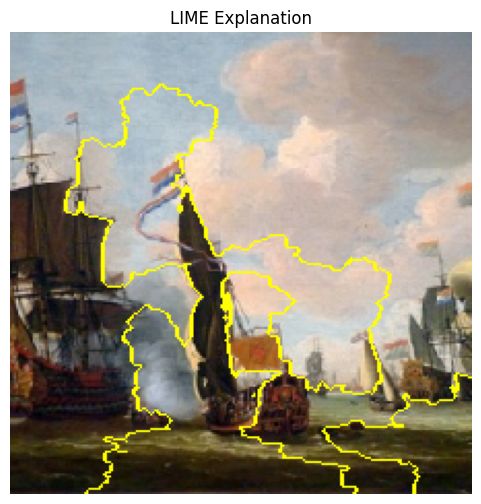

In [ ]:
!pip install lime

from lime import lime_image
from skimage.segmentation import mark_boundaries
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
img_path = 'abraham-storck_die-niederlandische-flotte-auf-der-reede-vor-amsterdam-0.jpg'

def preprocess_lime(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_np = image.img_to_array(img).astype('double')
    return img_np

image_np = preprocess_lime(img_path)

#Define a LIME-Compatible Prediction Function
def predict_fn(images):
    # Apply the same preprocessing as used for DenseNet/Xception
    images = tf.keras.applications.densenet.preprocess_input(images.copy())
    return model.predict(images)

#Create LIME Image Explainer
explainer = lime_image.LimeImageExplainer()
#Explain a Prediction
explanation = explainer.explain_instance(
    image_np.astype('uint8'),
    predict_fn,
    top_labels=2,
    hide_color=0,
    num_samples=1000  # you can increase for more accurate explanations
)
#Visualize the Explanation
from skimage.color import label2rgb

# Choose label index (e.g., 0 = Human, 1 = AI — adjust based on your dataset)
label_index = explanation.top_labels[0]  # or manually use 0 or 1

temp, mask = explanation.get_image_and_mask(
    label_index,
    positive_only=True,
    num_features=10,
    hide_rest=False
)

plt.figure(figsize=(6, 6))
plt.title('LIME Explanation')
plt.imshow(mark_boundaries(temp / 255.0, mask))
plt.axis('off')
plt.show()

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving adolphe-joseph-thomas-monticelli_margaree-faust-and-mephisto.jpg to adolphe-joseph-thomas-monticelli_margaree-faust-and-mephisto.jpg


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


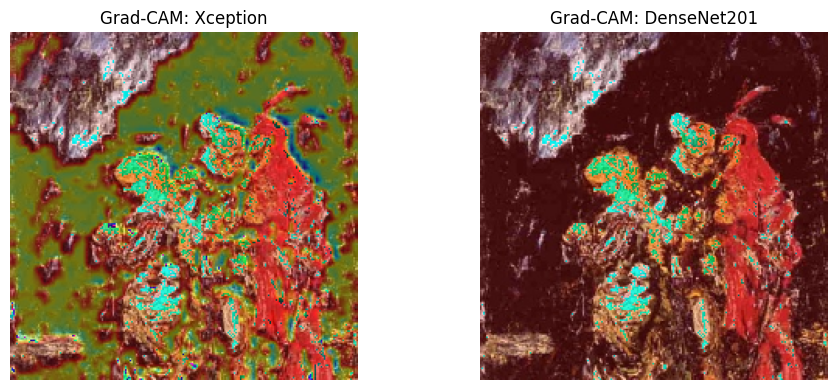

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing import image
import cv2

#Load and Preprocess the Image
img_path = "adolphe-joseph-thomas-monticelli_margaree-faust-and-mephisto.jpg"
def get_img_array(img_path, size=(224, 224)):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    array = tf.keras.applications.densenet.preprocess_input(array)
    return array, img

img_array, original_img = get_img_array(img_path)

#Grad-CAM Function
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()
#Apply Grad-CAM on Xception Branch
# Name of last conv layer in Xception branch
last_conv_xception = 'conv2d'  # Assuming it's named exactly like that after xception.output

heatmap_x = make_gradcam_heatmap(img_array, model, last_conv_xception)
#Apply Grad-CAM on DenseNet201 Branch
last_conv_densenet = 'conv2d_1'  # Adjust name if needed

heatmap_y = make_gradcam_heatmap(img_array, model, last_conv_densenet)

#Superimpose Heatmap on Image
def superimpose_heatmap(heatmap, original_image, alpha=0.4, colormap=cv2.COLORMAP_JET):
    img = np.array(original_image)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap_color = cv2.applyColorMap(heatmap, colormap)
    superimposed_img = heatmap_color * alpha + img
    return np.uint8(superimposed_img)

plt.figure(figsize=(10, 4))

plt.subplot(1, 2, 1)
plt.title("Grad-CAM: Xception")
plt.imshow(superimpose_heatmap(heatmap_x, original_img))
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title("Grad-CAM: DenseNet201")
plt.imshow(superimpose_heatmap(heatmap_y, original_img))
plt.axis('off')

plt.tight_layout()
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

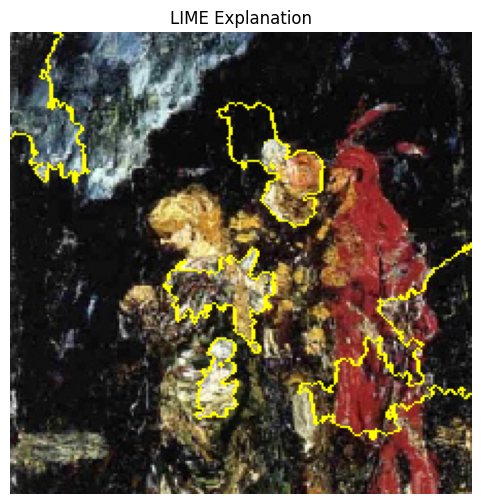

In [ ]:
!pip install lime

from lime import lime_image
from skimage.segmentation import mark_boundaries
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
img_path = 'adolphe-joseph-thomas-monticelli_margaree-faust-and-mephisto.jpg'

def preprocess_lime(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_np = image.img_to_array(img).astype('double')
    return img_np

image_np = preprocess_lime(img_path)

#Define a LIME-Compatible Prediction Function
def predict_fn(images):
    # Apply the same preprocessing as used for DenseNet/Xception
    images = tf.keras.applications.densenet.preprocess_input(images.copy())
    return model.predict(images)

#Create LIME Image Explainer
explainer = lime_image.LimeImageExplainer()
#Explain a Prediction
explanation = explainer.explain_instance(
    image_np.astype('uint8'),
    predict_fn,
    top_labels=2,
    hide_color=0,
    num_samples=1000  # you can increase for more accurate explanations
)
#Visualize the Explanation
from skimage.color import label2rgb

# Choose label index (e.g., 0 = Human, 1 = AI — adjust based on your dataset)
label_index = explanation.top_labels[0]  # or manually use 0 or 1

temp, mask = explanation.get_image_and_mask(
    label_index,
    positive_only=True,
    num_features=10,
    hide_rest=False
)

plt.figure(figsize=(6, 6))
plt.title('LIME Explanation')
plt.imshow(mark_boundaries(temp / 255.0, mask))
plt.axis('off')
plt.show()

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving adachi-ginko_90.jpg to adachi-ginko_90.jpg


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


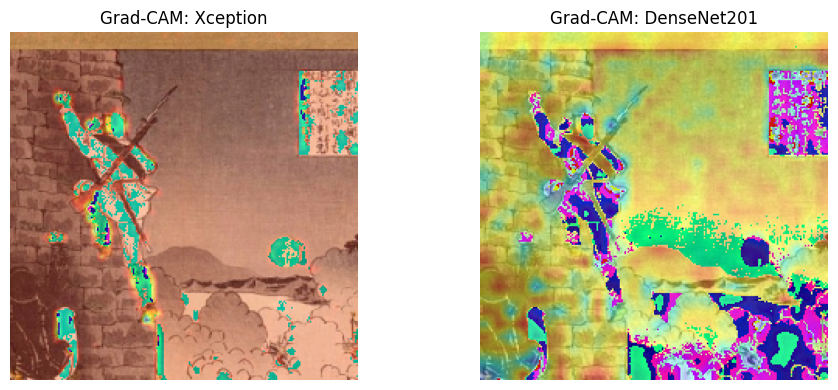

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing import image
import cv2

#Load and Preprocess the Image
img_path = "adachi-ginko_90.jpg"
def get_img_array(img_path, size=(224, 224)):
    img = image.load_img(img_path, target_size=size)
    array = image.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    array = tf.keras.applications.densenet.preprocess_input(array)
    return array, img

img_array, original_img = get_img_array(img_path)

#Grad-CAM Function
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()
#Apply Grad-CAM on Xception Branch
# Name of last conv layer in Xception branch
last_conv_xception = 'conv2d'  # Assuming it's named exactly like that after xception.output

heatmap_x = make_gradcam_heatmap(img_array, model, last_conv_xception)
#Apply Grad-CAM on DenseNet201 Branch
last_conv_densenet = 'conv2d_1'  # Adjust name if needed

heatmap_y = make_gradcam_heatmap(img_array, model, last_conv_densenet)

#Superimpose Heatmap on Image
def superimpose_heatmap(heatmap, original_image, alpha=0.4, colormap=cv2.COLORMAP_JET):
    img = np.array(original_image)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap_color = cv2.applyColorMap(heatmap, colormap)
    superimposed_img = heatmap_color * alpha + img
    return np.uint8(superimposed_img)

plt.figure(figsize=(10, 4))

plt.subplot(1, 2, 1)
plt.title("Grad-CAM: Xception")
plt.imshow(superimpose_heatmap(heatmap_x, original_img))
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title("Grad-CAM: DenseNet201")
plt.imshow(superimpose_heatmap(heatmap_y, original_img))
plt.axis('off')

plt.tight_layout()
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

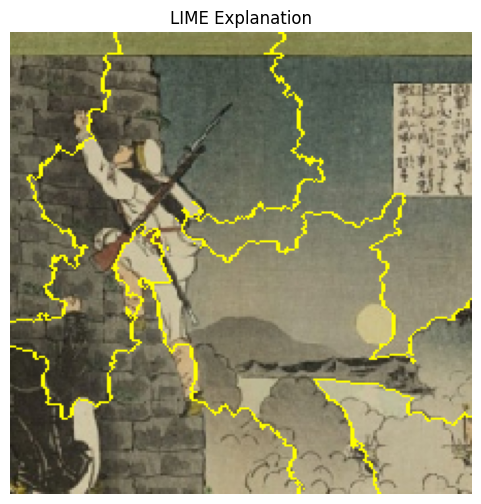

In [ ]:
!pip install lime

from lime import lime_image
from skimage.segmentation import mark_boundaries
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
img_path = 'adachi-ginko_90.jpg'

def preprocess_lime(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_np = image.img_to_array(img).astype('double')
    return img_np

image_np = preprocess_lime(img_path)

#Define a LIME-Compatible Prediction Function
def predict_fn(images):
    # Apply the same preprocessing as used for DenseNet/Xception
    images = tf.keras.applications.densenet.preprocess_input(images.copy())
    return model.predict(images)

#Create LIME Image Explainer
explainer = lime_image.LimeImageExplainer()
#Explain a Prediction
explanation = explainer.explain_instance(
    image_np.astype('uint8'),
    predict_fn,
    top_labels=2,
    hide_color=0,
    num_samples=1000  # you can increase for more accurate explanations
)
#Visualize the Explanation
from skimage.color import label2rgb

# Choose label index (e.g., 0 = Human, 1 = AI — adjust based on your dataset)
label_index = explanation.top_labels[0]  # or manually use 0 or 1

temp, mask = explanation.get_image_and_mask(
    label_index,
    positive_only=True,
    num_features=10,
    hide_rest=False
)

plt.figure(figsize=(6, 6))
plt.title('LIME Explanation')
plt.imshow(mark_boundaries(temp / 255.0, mask))
plt.axis('off')
plt.show()

#Applying Multi-Scale Fusion(Cocatenation at different levels)

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras import Input, models
from tensorflow.keras.applications import DenseNet201, Xception
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Dense, Dropout, Input,
                                     GlobalAveragePooling2D, GlobalMaxPooling2D, Multiply,
                                     Concatenate, Reshape)
from tensorflow.keras.regularizers import l2
from keras.models import Sequential
from keras.layers import Dense, Flatten

# Input
input_layer = Input(shape=(224, 224, 3))

# --- Xception Branch ---
xception = Xception(weights='imagenet', include_top=False, input_tensor=input_layer)
xception_out = xception.output  # Final conv layer (7x7x2048 for Xception)

# Optional: Get intermediate layers (e.g., mid-level features)
xception_mid = xception.get_layer("block4_sepconv2_bn").output  # Example layer

# --- DenseNet201 Branch ---
densenet = DenseNet201(weights='imagenet', include_top=False, input_tensor=input_layer)
densenet_out = densenet.output  # Final conv layer (7x7x1920 for DenseNet201)

# Optional: Get intermediate layers
densenet_mid = densenet.get_layer("pool3_conv").output  # Example layer

# --- Feature Fusion Strategies ---
# Option A: Concatenate only final features (simplest)
combined = concatenate([
    GlobalAveragePooling2D()(xception_out),
    GlobalAveragePooling2D()(densenet_out)
])

# Option B: Multi-level fusion (better for fine-grained tasks)
xception_gap = GlobalAveragePooling2D()(xception_out)
densenet_gap = GlobalAveragePooling2D()(densenet_out)
xception_mid_gap = GlobalAveragePooling2D()(xception_mid)
densenet_mid_gap = GlobalAveragePooling2D()(densenet_mid)

combined = concatenate([xception_gap, densenet_gap, xception_mid_gap, densenet_mid_gap])

# --- Final Layers ---
z = Dense(512, activation='relu')(combined)  # Increase units due to larger concatenated features
output = Dense(2, activation='softmax')(z)

model = Model(inputs=input_layer, outputs=output)
model.summary()

83683744/83683744 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
74836368/74836368 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d      │ (None, 230, 230,  │          0 │ input_layer_1[0]… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,408 │ zero_padding2d[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_1    │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 56, 56,    │          0 │ zero_padding2d_1… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │        256 │ pool1[0][0]       │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_relu │ (None, 56, 56,    │          0 │ conv2_block1_0_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      8,192 │ conv2_block1_0_r… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        512 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,864 │ conv2_block1_1_r… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_concat │ (None, 56, 56,    │          0 │ pool1[0][0],      │
│ (Concatenate)       │ 96)               │            │ conv2_block1_2_c… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_bn   │ (None, 56, 56,    │        384 │ conv2_block1_con… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_relu │ (None, 56, 56,    │          0 │ conv2_block2_0_b… │
│ (Activation)        │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_1_conv │ (None, 56, 56,    │     12,288 │ conv2_block2_0_r

 Total params: 41,720,426 (159.15 MB)

 Trainable params: 41,436,842 (158.07 MB)

 Non-trainable params: 283,584 (1.08 MB)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model for the specified number of epochs
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 863ms/step - accuracy: 0.9142 - loss: 0.2962
Epoch 1: val_accuracy improved from -inf to 0.75045, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 1020s 1s/step - accuracy: 0.9143 - loss: 0.2958 - val_accuracy: 0.7505 - val_loss: 1.0608
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 876ms/step - accuracy: 0.9913 - loss: 0.0260
Epoch 2: val_accuracy improved from 0.75045 to 0.79545, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 523s 950ms/step - accuracy: 0.9913 - loss: 0.0260 - val_accuracy: 0.7955 - val_loss: 0.9029
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 869ms/step - accuracy: 0.9933 - loss: 0.0180
Epoch 3: val_accuracy improved from 0.79545 to 0.96636, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 559s 945ms/step - accuracy: 0.9933 - loss: 0.0180 - val_accuracy: 0.9664 - val_loss: 0.1048
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 869ms/step - accuracy: 0.9968 - loss: 0.0107
Epoch 4: val_accuracy improved from 0.96636 to 0.98205, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 525s 954ms/step - accuracy: 0.9968 - loss: 0.0107 - val_accuracy: 0.9820 - val_loss: 0.0430
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 870ms/step - accuracy: 0.9954 - loss: 0.0126
Epoch 5: val_accuracy did not improve from 0.98205
550/550 ━━━━━━━━━━━━━━━━━━━━ 519s 944ms/step - accuracy: 0.9954 - loss: 0.0126 - val_accuracy: 0.9680 - val_loss: 0.0903
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 866ms/step - accuracy: 0.9961 - loss: 0.0117
Epoch 6: val_accuracy improved from 0.98205 to 0.99523, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 530s 963ms/step - accuracy: 0.9961 - loss: 0.0117 - val_accuracy: 0.9952 - val_loss: 0.0132
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 867ms/step - accuracy: 0.9967 - loss: 0.0103
Epoch 7: val_accuracy did not improve from 0.99523
550/550 ━━━━━━━━━━━━━━━━━━━━ 511s 930ms/step - accuracy: 0.9967 - loss: 0.0103 - val_accuracy: 0.9870 - val_loss: 0.1945
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 866ms/step - accuracy: 0.9961 - loss: 0.0136
Epoch 8: val_accuracy improved from 0.99523 to 0.99705, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 527s 958ms/step - accuracy: 0.9961 - loss: 0.0136 - val_accuracy: 0.9970 - val_loss: 0.0076
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 866ms/step - accuracy: 0.9983 - loss: 0.0049
Epoch 9: val_accuracy did not improve from 0.99705
550/550 ━━━━━━━━━━━━━━━━━━━━ 518s 941ms/step - accuracy: 0.9983 - loss: 0.0049 - val_accuracy: 0.9875 - val_loss: 0.0461
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 862ms/step - accuracy: 0.9967 - loss: 0.0119
Epoch 10: val_accuracy did not improve from 0.99705
550/550 ━━━━━━━━━━━━━━━━━━━━ 509s 925ms/step - accuracy: 0.9967 - loss: 0.0119 - val_accuracy: 0.9518 - val_loss: 0.1560
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 72s 27ms/step - accuracy: 0.9826 - loss: 0.0653
Test Accuracy: 95.55%


#Applying Cross model Attention fusion

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras import Input, models
from tensorflow.keras.applications import DenseNet201, Xception
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Dense, Dropout, Input,
                                     GlobalAveragePooling2D, GlobalMaxPooling2D, Multiply,
                                     concatenate, Reshape)
from tensorflow.keras.regularizers import l2
from keras.models import Sequential
from keras.layers import Dense, Flatten
from tensorflow.keras.layers import Multiply, Dense, Reshape

input_layer = Input(shape=(224, 224, 3))

# --- Xception Branch ---
xception = Xception(weights='imagenet', include_top=False, input_tensor=input_layer)
xception_out = xception.output  # Final conv layer (7x7x2048 for Xception)

# --- DenseNet201 Branch ---
densenet = DenseNet201(weights='imagenet', include_top=False, input_tensor=input_layer)
densenet_out = densenet.output  # Final conv layer (7x7x1920 for DenseNet201)


# After getting xception_out and densenet_out (before GAP)
xception_att = Conv2D(1, (1, 1), activation='sigmoid')(xception_out)  # Attention map
weighted_densenet = Multiply()([densenet_out, xception_att])  # DenseNet features weighted by Xception's attention

# Now concatenate
combined = concatenate([
    GlobalAveragePooling2D()(xception_out),
    GlobalAveragePooling2D()(weighted_densenet)
])

# Proceed with final layers...
z = Dense(512, activation='relu')(combined)  # Increase units due to larger concatenated features
output = Dense(2, activation='softmax')(z)

model = Model(inputs=input_layer, outputs=output)
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_2    │ (None, 230, 230,  │          0 │ input_layer_1[0]… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,408 │ zero_padding2d_2… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_3    │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 56, 56,    │          0 │ zero_padding2d_3… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │        256 │ pool1[0][0]       │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_relu │ (None, 56, 56,    │          0 │ conv2_block1_0_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      8,192 │ conv2_block1_0_r… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        512 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,864 │ conv2_block1_1_r… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_concat │ (None, 56, 56,    │          0 │ pool1[0][0],      │
│ (Concatenate)       │ 96)               │            │ conv2_block1_2_c… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_bn   │ (None, 56, 56,    │        384 │ conv2_block1_con… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_relu │ (None, 56, 56,    │          0 │ conv2_block2_0_b… │
│ (Activation)        │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_1_conv │ (None, 56, 56,    │     12,288 │ conv2_block2_0_r

 Total params: 41,218,667 (157.24 MB)

 Trainable params: 40,935,083 (156.15 MB)

 Non-trainable params: 283,584 (1.08 MB)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model for the specified number of epochs
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 852ms/step - accuracy: 0.9221 - loss: 0.1971
Epoch 1: val_accuracy improved from -inf to 0.94091, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 996s 1s/step - accuracy: 0.9222 - loss: 0.1970 - val_accuracy: 0.9409 - val_loss: 0.3206
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 856ms/step - accuracy: 0.9874 - loss: 0.0414
Epoch 2: val_accuracy improved from 0.94091 to 0.97818, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 571s 929ms/step - accuracy: 0.9874 - loss: 0.0414 - val_accuracy: 0.9782 - val_loss: 0.0582
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 855ms/step - accuracy: 0.9918 - loss: 0.0240
Epoch 3: val_accuracy improved from 0.97818 to 0.98909, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 517s 940ms/step - accuracy: 0.9918 - loss: 0.0240 - val_accuracy: 0.9891 - val_loss: 0.0284
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 857ms/step - accuracy: 0.9954 - loss: 0.0154
Epoch 4: val_accuracy improved from 0.98909 to 0.99227, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 520s 945ms/step - accuracy: 0.9954 - loss: 0.0155 - val_accuracy: 0.9923 - val_loss: 0.0341
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 855ms/step - accuracy: 0.9960 - loss: 0.0126
Epoch 5: val_accuracy improved from 0.99227 to 0.99364, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 521s 946ms/step - accuracy: 0.9960 - loss: 0.0126 - val_accuracy: 0.9936 - val_loss: 0.0201
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 855ms/step - accuracy: 0.9960 - loss: 0.0130
Epoch 6: val_accuracy did not improve from 0.99364
550/550 ━━━━━━━━━━━━━━━━━━━━ 502s 913ms/step - accuracy: 0.9960 - loss: 0.0130 - val_accuracy: 0.9914 - val_loss: 0.0322
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 856ms/step - accuracy: 0.9978 - loss: 0.0079
Epoch 7: val_accuracy improved from 0.99364 to 0.99818, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 510s 928ms/step - accuracy: 0.9978 - loss: 0.0079 - val_accuracy: 0.9982 - val_loss: 0.0097
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 853ms/step - accuracy: 0.9972 - loss: 0.0082
Epoch 8: val_accuracy did not improve from 0.99818
550/550 ━━━━━━━━━━━━━━━━━━━━ 562s 927ms/step - accuracy: 0.9972 - loss: 0.0082 - val_accuracy: 0.9925 - val_loss: 0.0210
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 853ms/step - accuracy: 0.9976 - loss: 0.0087
Epoch 9: val_accuracy did not improve from 0.99818
550/550 ━━━━━━━━━━━━━━━━━━━━ 501s 911ms/step - accuracy: 0.9976 - loss: 0.0087 - val_accuracy: 0.9900 - val_loss: 0.0581
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 852ms/step - accuracy: 0.9964 - loss: 0.0114
Epoch 10: val_accuracy did not improve from 0.99818
550/550 ━━━━━━━━━━━━━━━━━━━━ 500s 910ms/step - accuracy: 0.9964 - loss: 0.0114 - val_accuracy: 0.9552 - val_loss: 0.5558
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 68s 26ms/step - accuracy: 0.9322 - loss: 0.9285
Test Accuracy: 94.

#Applying Feature Reduction Techniques Variance Threshold, PCA, K-Best

In [ ]:
from tensorflow.keras.layers import Layer, concatenate
from tensorflow.keras import Input, models
from tensorflow.keras.applications import Xception, DenseNet201
import tensorflow as tf
from tensorflow.keras.layers import (Conv2D, BatchNormalization, Dense, Dropout, Input,
                                     GlobalAveragePooling2D, GlobalMaxPooling2D, Multiply,
                                     Concatenate, Reshape)
from tensorflow.keras import backend as K
from tensorflow.keras.regularizers import l2
from keras.models import Sequential
from keras.layers import Dense, Flatten
from keras.layers import Input

# Squeeze-and-Excitation (SE) Block
def squeeze_excite_block(input_tensor, ratio=16):
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation='relu', kernel_regularizer=l2(0.001))(se)
    se = Dense(filters, activation='sigmoid', kernel_regularizer=l2(0.001))(se)
    se = Reshape((1, 1, filters))(se)
    return Multiply()([input_tensor, se])

# Spatial Attention Block
def spatial_attention_block(input_tensor):
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_tensor)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_tensor)
    concat = Concatenate(axis=-1)([avg_pool, max_pool])
    attention = Conv2D(1, (7, 7), padding='same', activation='sigmoid')(concat)
    return Multiply()([input_tensor, attention])


# Custom feature selection layer (PCA-like)
class FeatureReduction(Layer):
    def __init__(self, n_components, **kwargs):
        super(FeatureReduction, self).__init__(**kwargs)
        self.n_components = n_components

    def build(self, input_shape):
        # Learnable projection matrix
        self.projection = self.add_weight(
            name='projection',
            shape=(input_shape[-1], self.n_components),
            initializer='orthogonal',
            trainable=True)
        super().build(input_shape)

    def call(self, inputs):
        # Apply projection (similar to PCA but learned end-to-end)
        return tf.matmul(inputs, self.projection)

    def compute_output_shape(self, input_shape):
        return (input_shape[0], self.n_components)

# Input layer
input_layer = Input(shape=(224, 224, 3))

# Xception branch
xception = Xception(weights='imagenet', include_top=False, input_tensor=input_layer)
xception.trainable = True
for layer in xception.layers[:100]:
    layer.trainable = False
x = xception.output
x = Conv2D(32, (3, 3), padding='same')(x)
x = BatchNormalization()(x)
x = squeeze_excite_block(x)
x = spatial_attention_block(x)
x = GlobalAveragePooling2D()(x)

# DenseNet201 branch
densenet = DenseNet201(weights='imagenet', include_top=False, input_tensor=input_layer)
densenet.trainable = True
for layer in densenet.layers[:100]:
    layer.trainable = False
y = densenet.output
y = Conv2D(32, (3, 3), padding='same')(y)
y = BatchNormalization()(y)
y = squeeze_excite_block(y)
y = spatial_attention_block(y)
y = GlobalAveragePooling2D()(y)

# Concatenate features from both models
combined = concatenate([x, y])

# Feature reduction techniques
# Option 1: Variance Threshold-like (learned)
z = FeatureReduction(n_components=256)(combined)  # Reduces to 256 features

# Option 2: Add dropout for implicit feature selection
z = Dropout(0.5)(combined)

# Option 3: Bottleneck dense layer
# z = Dense(256, activation='relu', kernel_regularizer='l1')(combined)  # L1 regularization for sparsity

# Final layers
z = Dense(256, activation='relu')(z)
output = Dense(2, activation='softmax')(z)

# Create the combined model
model = models.Model(inputs=input_layer, outputs=output)
model.summary()

74836368/74836368 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d      │ (None, 230, 230,  │          0 │ input_layer_4[0]… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,408 │ zero_padding2d[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_1    │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 56, 56,    │          0 │ zero_padding2d_1… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │        256 │ pool1[0][0]       │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_relu │ (None, 56, 56,    │          0 │ conv2_block1_0_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      8,192 │ conv2_block1_0_r… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        512 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,864 │ conv2_block1_1_r… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_concat │ (None, 56, 56,    │          0 │ pool1[0][0],      │
│ (Concatenate)       │ 96)               │            │ conv2_block1_2_c… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_bn   │ (None, 56, 56,    │        384 │ conv2_block1_con… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_relu │ (None, 56, 56,    │          0 │ conv2_block2_0_b… │
│ (Activation)        │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_1_conv │ (None, 56, 56,    │     12,288 │ conv2_block2_0_r

 Total params: 40,350,320 (153.92 MB)

 Trainable params: 27,933,328 (106.56 MB)

 Non-trainable params: 12,416,992 (47.37 MB)

In [ ]:
from keras.callbacks import ModelCheckpoint

# Define the file path where the model will be saved
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_accuracy', save_best_only=True, mode='max', verbose=1)

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model for the specified number of epochs
history = model.fit(train_dataset, epochs=10, validation_data=val_dataset, callbacks=[model_checkpoint])

loss, accuracy = model.evaluate(test_dataset)
print("Test Accuracy: {:.2f}%".format(accuracy * 100))

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 554ms/step - accuracy: 0.9425 - loss: 0.1738
Epoch 1: val_accuracy improved from -inf to 0.95705, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 810s 730ms/step - accuracy: 0.9425 - loss: 0.1737 - val_accuracy: 0.9570 - val_loss: 0.1360
Epoch 2/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 554ms/step - accuracy: 0.9885 - loss: 0.0357
Epoch 2: val_accuracy improved from 0.95705 to 0.98955, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 385s 628ms/step - accuracy: 0.9885 - loss: 0.0357 - val_accuracy: 0.9895 - val_loss: 0.0322
Epoch 3/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 553ms/step - accuracy: 0.9933 - loss: 0.0196
Epoch 3: val_accuracy did not improve from 0.98955
550/550 ━━━━━━━━━━━━━━━━━━━━ 338s 615ms/step - accuracy: 0.9933 - loss: 0.0196 - val_accuracy: 0.9895 - val_loss: 0.0355
Epoch 4/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 552ms/step - accuracy: 0.9944 - loss: 0.0165
Epoch 4: val_accuracy did not improve from 0.98955
550/550 ━━━━━━━━━━━━━━━━━━━━ 338s 614ms/step - accuracy: 0.9944 - loss: 0.0165 - val_accuracy: 0.9841 - val_loss: 0.0449
Epoch 5/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 552ms/step - accuracy: 0.9959 - loss: 0.0130
Epoch 5: val_accuracy improved from 0.98955 to 0.99318, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 344s 625ms/step - accuracy: 0.9959 - loss: 0.0130 - val_accuracy: 0.9932 - val_loss: 0.0232
Epoch 6/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 551ms/step - accuracy: 0.9964 - loss: 0.0101
Epoch 6: val_accuracy improved from 0.99318 to 0.99523, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 344s 625ms/step - accuracy: 0.9964 - loss: 0.0101 - val_accuracy: 0.9952 - val_loss: 0.0144
Epoch 7/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 554ms/step - accuracy: 0.9978 - loss: 0.0080
Epoch 7: val_accuracy improved from 0.99523 to 0.99636, saving model to best_model.h5


550/550 ━━━━━━━━━━━━━━━━━━━━ 384s 629ms/step - accuracy: 0.9978 - loss: 0.0080 - val_accuracy: 0.9964 - val_loss: 0.0136
Epoch 8/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 553ms/step - accuracy: 0.9985 - loss: 0.0046
Epoch 8: val_accuracy did not improve from 0.99636
550/550 ━━━━━━━━━━━━━━━━━━━━ 338s 615ms/step - accuracy: 0.9985 - loss: 0.0046 - val_accuracy: 0.9916 - val_loss: 0.0331
Epoch 9/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 553ms/step - accuracy: 0.9957 - loss: 0.0113
Epoch 9: val_accuracy did not improve from 0.99636
550/550 ━━━━━━━━━━━━━━━━━━━━ 339s 615ms/step - accuracy: 0.9957 - loss: 0.0113 - val_accuracy: 0.9895 - val_loss: 0.0376
Epoch 10/10
550/550 ━━━━━━━━━━━━━━━━━━━━ 0s 553ms/step - accuracy: 0.9981 - loss: 0.0047
Epoch 10: val_accuracy did not improve from 0.99636
550/550 ━━━━━━━━━━━━━━━━━━━━ 338s 615ms/step - accuracy: 0.9981 - loss: 0.0047 - val_accuracy: 0.9564 - val_loss: 0.1689
2000/2000 ━━━━━━━━━━━━━━━━━━━━ 72s 27ms/step - accuracy: 0.9366 - loss: 0.2768
Test Accuracy: 96.